=== Starting Air Quality Forecasting Script ===

1. Loading data...
Successfully loaded data from ./processed_data/air_quality_data_complete.csv
DataFrame shape after loading: (940, 27)
Columns: ['region', 'date', 'filename', 'co_value', 'co_00:00', 'co_12:00', 'co_units', 'no2_value', 'no2_00:00', 'no2_12:00', 'no2_units', 'o3_value', 'o3_00:00', 'o3_12:00', 'o3_units', 'so2_value', 'so2_00:00', 'so2_12:00', 'so2_units', 'pm10_value', 'pm10_00:00', 'pm10_12:00', 'pm10_units', 'pm2.5_value', 'pm2.5_00:00', 'pm2.5_12:00', 'pm2.5_units']

2. Processing date information...
DataFrame shape after setting weekly frequency: (469, 26)

3. Filtering by region...
Region counts in original data:
region
Maurienne      470
Val di Susa    470
Name: count, dtype: int64

Processing region: Maurienne
Found 470 rows for region 'Maurienne'
After setting weekly frequency: 469 rows

Processing region: Val di Susa
Found 470 rows for region 'Val di Susa'
After setting weekly frequency: 469 rows

Region: Maur

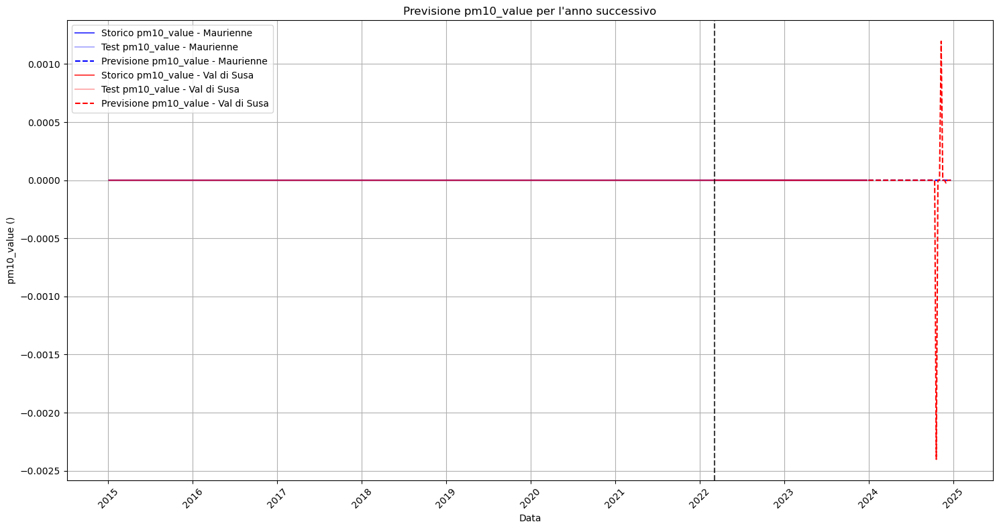

In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import os
from statsmodels.tsa.statespace.sarimax import SARIMAX
from sklearn.metrics import mean_absolute_error, mean_squared_error
import numpy as np
import time
import warnings
warnings.filterwarnings("ignore")  # Suppress warnings for cleaner output

print("=== Starting Air Quality Forecasting Script ===")

# Caricamento dati
print("\n1. Loading data...")
file_path = "./processed_data/air_quality_data_complete.csv"

try:
    df = pd.read_csv(file_path)
    print(f"Successfully loaded data from {file_path}")
    print(f"DataFrame shape after loading: {df.shape}")
    print(f"Columns: {df.columns.tolist()}")
except Exception as e:
    print(f"ERROR loading data: {e}")
    raise

# Convert date column to datetime
print("\n2. Processing date information...")
df["date"] = pd.to_datetime(df["date"])

# Check for and handle any NaT values in date column
if df["date"].isna().any():
    print(f"WARNING: Found {df['date'].isna().sum()} NaT values in date column. Removing these rows.")
    df = df.dropna(subset=["date"])

# Important: Create a copy of the dataframe BEFORE setting the index
# This is crucial because we lose the region column when we use asfreq
df_with_regions = df.copy()

# Set date as index for the main dataframe
df.set_index("date", inplace=True)

# Check for duplicate indices
duplicates = df.index.duplicated()
if duplicates.any():
    print(f"WARNING: Found {duplicates.sum()} duplicate date indices. Keeping first occurrence.")
    df = df[~df.index.duplicated(keep='first')]

# Set weekly frequency
try:
    df_weekly = df.asfreq('W', method='pad')
    print(f"DataFrame shape after setting weekly frequency: {df_weekly.shape}")
except Exception as e:
    print(f"ERROR setting weekly frequency: {e}")
    print("Continuing with original dataframe...")
    df_weekly = df

# Selezionare le regioni
print("\n3. Filtering by region...")
regions = ["Maurienne", "Val di Susa"]
variables = ["pm10_value", "co_value", "no2_value", "so2_value", "pm2.5_value"]

# Print region values to verify
region_counts = df_with_regions['region'].value_counts()
print("Region counts in original data:")
print(region_counts)

# Alternative approach: Create separate dataframes for each region BEFORE setting frequency
data = {}
for region in regions:
    print(f"\nProcessing region: {region}")
    
    # Filter from the original dataframe that still has the region column
    region_df = df_with_regions[df_with_regions["region"] == region].copy()
    
    if len(region_df) == 0:
        print(f"WARNING: No data found for region '{region}'")
        continue
        
    print(f"Found {len(region_df)} rows for region '{region}'")
    
    # Set the date index for this region's dataframe
    region_df.set_index("date", inplace=True)
    
    # Remove duplicates
    region_df = region_df[~region_df.index.duplicated(keep='first')]
    
    # Set weekly frequency for this region
    try:
        region_df = region_df.asfreq('W', method='pad')
        print(f"After setting weekly frequency: {len(region_df)} rows")
    except Exception as e:
        print(f"Error setting weekly frequency for {region}: {e}")
    
    # Store in our data dictionary
    data[region] = region_df

# Check data lengths before modeling and filter out regions with no data
valid_regions = []
for region in regions:
    if region not in data or len(data[region]) == 0:
        print(f"WARNING: No data available for region {region}. Skipping this region.")
        continue
        
    print(f"\nRegion: {region}")
    print(f"Total data points: {len(data[region])}")
    
    # Suddivisione dati in training e test
    split_point = int(len(data[region]) * 0.8)  # Using 80% for training
    
    if 'train_data' not in locals():
        train_data = {}
    if 'test_data' not in locals():
        test_data = {}
        
    train_data[region] = data[region].iloc[:split_point]
    test_data[region] = data[region].iloc[split_point:]
    
    print(f"Training data points: {len(train_data[region])}")
    print(f"Test data points: {len(test_data[region])}")
    
    if len(data[region]) > 0:
        print(f"Date range: {data[region].index[0]} to {data[region].index[-1]}")
    
    valid_regions.append(region)
    print("-" * 50)
    
# Update regions list to only include those with data
regions = valid_regions
if len(regions) == 0:
    raise ValueError("No valid regions with data available. Cannot proceed with modeling.")

# Detect and handle outliers (optional)
def handle_outliers(series, threshold=3):
    mean = series.mean()
    std = series.std()
    outliers = (series - mean).abs() > threshold * std
    clean_series = series.copy()
    clean_series[outliers] = mean
    return clean_series

# Creazione e addestramento del modello SARIMA per ciascuna regione e variabile
print("\n4. Training SARIMA models...")
models = {}
forecasts = {}
future_steps = 52  # Predizione di un anno (52 settimane)
execution_times = {}

for region in regions:
    forecasts[region] = {}
    for variable in variables:
        # Skip variables not present in the data
        if variable not in data[region].columns:
            print(f"WARNING: Variable {variable} not found for region {region}. Skipping.")
            continue
            
        print(f"Addestramento modello SARIMA per {region} - {variable}...")
        start_time = time.time()
        try:
            # Use a simpler model with more stable optimization
            # Simplified seasonal differencing and simplified AR/MA components
            
            # Preprocess series to handle outliers
            series = handle_outliers(train_data[region][variable])
            
            # Try simpler model configuration
            model = SARIMAX(
                series, 
                order=(1, 1, 0),               # Simpler non-seasonal component
                seasonal_order=(0, 1, 1, 52),  # Simpler seasonal component
                enforce_stationarity=False,     
                enforce_invertibility=False,
                initialization='approximate_diffuse'  # More stable initialization
            )
            
            # Use a more robust fitting method with reasonable max iterations
            models[(region, variable)] = model.fit(
                method='powell',                # Alternative optimization algorithm
                disp=False,                     # Suppress convergence messages
                maxiter=50                      # Limit iterations for stability
            )
            
            forecasts[region][variable] = models[(region, variable)].forecast(steps=future_steps)
            execution_times[(region, variable)] = time.time() - start_time
            
            print(f"✓ Modello addestrato con successo in {execution_times[(region, variable)]:.2f} secondi")
            
        except Exception as e:
            print(f"Errore nell'addestramento di {region} - {variable}: {e}")
            # Fallback to a very simple model if SARIMA fails
            try:
                print("Tentativo con modello più semplice...")
                # Try with extremely simple model as fallback
                model = SARIMAX(
                    train_data[region][variable], 
                    order=(0, 1, 0),              # Only differencing
                    seasonal_order=(0, 1, 0, 52), # Only seasonal differencing
                    enforce_stationarity=False,
                    enforce_invertibility=False
                )
                models[(region, variable)] = model.fit(method='powell', disp=False)
                forecasts[region][variable] = models[(region, variable)].forecast(steps=future_steps)
                execution_times[(region, variable)] = time.time() - start_time
                print(f"✓ Modello semplificato addestrato con successo")
            except Exception as e2:
                print(f"× Impossibile addestrare anche il modello semplificato: {e2}")
                forecasts[region][variable] = None

# Valutazione delle prestazioni del modello
print("\n5. Evaluating model performance...")
errors = {}
for region in regions:
    errors[region] = {}
    for variable in variables:
        # Skip variables not present in the data
        if variable not in data[region].columns:
            continue
            
        if forecasts[region].get(variable) is not None and len(test_data[region]) > 0:
            # Ensure we only compare the available test data points
            forecast_length = min(len(test_data[region]), len(forecasts[region][variable]))
            
            mae = mean_absolute_error(
                test_data[region][variable][:forecast_length], 
                forecasts[region][variable][:forecast_length]
            )
            rmse = np.sqrt(mean_squared_error(
                test_data[region][variable][:forecast_length], 
                forecasts[region][variable][:forecast_length]
            ))
            
            errors[region][variable] = {"MAE": mae, "RMSE": rmse}
            print(f"\nPrestazioni per {region} - {variable}:")
            print(f"MAE: {mae:.6f}")
            print(f"RMSE: {rmse:.6f}")
            print(f"Tempo di esecuzione: {execution_times[(region, variable)]:.2f} secondi")
        else:
            print(f"\nNessuna previsione disponibile per {region} - {variable} a causa di un errore nel modello o dati di test insufficienti.")

# Esportazione delle previsioni
print("\n6. Exporting forecasts...")
try:
    forecast_df = pd.DataFrame({"Date": pd.date_range(start=test_data[regions[0]].index[-1], periods=future_steps + 1, freq="W")[1:]})
    
    for region in regions:
        for variable in variables:
            if variable in forecasts[region] and forecasts[region][variable] is not None:
                forecast_df[f"{region}_{variable}"] = forecasts[region][variable].values
    
    output_path = "./processed_data/forecast_air_quality.csv"
    forecast_df.to_csv(output_path, index=False)
    
    # Controllo dell'esistenza del file di output
    if os.path.exists(output_path):
        print(f"File di previsioni salvato correttamente: {output_path}")
    else:
        print("Errore: il file di previsioni non è stato generato correttamente.")
except Exception as e:
    print(f"Errore durante l'esportazione delle previsioni: {e}")

# Visualizzazione dei risultati
print("\n7. Creating visualizations...")
try:
    for variable in ["pm10_value"]:  # You can modify this list to plot other variables
        plt.figure(figsize=(15, 8))
        for region, color in zip(regions, ["blue", "red", "green", "orange"][:len(regions)]):
            if variable not in data[region].columns:
                print(f"Skipping visualization for {region} - {variable} (column not found)")
                continue
                
            # Plot historical data
            plt.plot(data[region].index, data[region][variable], 
                     label=f"Storico {variable} - {region}", color=color, alpha=0.7)
            
            # Mark the training/test split
            plt.axvline(x=train_data[region].index[-1], color='black', linestyle='--', alpha=0.5)
            
            # Plot test data with different style
            plt.plot(test_data[region].index, test_data[region][variable], 
                     label=f"Test {variable} - {region}", color=color, alpha=0.3)
            
            # Plot forecasts if available
            if variable in forecasts[region] and forecasts[region][variable] is not None:
                # Plot future forecasts
                plt.plot(forecast_df["Date"], forecast_df[f"{region}_{variable}"], 
                         label=f"Previsione {variable} - {region}", 
                         linestyle="dashed", color=color)
    
        try:
            plt.xlabel("Data")
            plt.ylabel(f"{variable} ({data[regions[0]].get(f'{variable}_units', [''])[0]})")
            plt.title(f"Previsione {variable} per l'anno successivo")
            plt.legend()
            plt.xticks(rotation=45)
            plt.grid(True)
            plt.tight_layout()
            plt.savefig(f"./processed_data/forecast_{variable}.png")
            print(f"Visualization saved for {variable}")
        except Exception as viz_error:
            print(f"Error creating visualization for {variable}: {viz_error}")
except Exception as e:
    print(f"Error in visualization process: {e}")

print("\n=== Air Quality Forecasting Script Completed ===")

=== Script di Visualizzazione delle Previsioni della Qualità dell'Aria ===

1. Caricamento dati storici...
Dati storici caricati: 940 record

2. Caricamento previsioni...
Previsioni caricate: 52 record
Periodo previsione: da 2023-12-31 00:00:00 a 2024-12-22 00:00:00

3. Creazione grafici...
Creazione grafico comparativo delle variabili...
Salvato grafico confronto in ./processed_data/plots/confronto_tutte_variabili.png
Creazione grafici individuali per variabile...
Salvato grafico di pm10_value in ./processed_data/plots/pm10_value_andamento.png
Salvato grafico di co_value in ./processed_data/plots/co_value_andamento.png
Salvato grafico di no2_value in ./processed_data/plots/no2_value_andamento.png
Salvato grafico di so2_value in ./processed_data/plots/so2_value_andamento.png
Salvato grafico di pm2.5_value in ./processed_data/plots/pm2.5_value_andamento.png
Creazione grafico di confronto PM10 tra regioni...
Salvato grafico confronto PM10 in ./processed_data/plots/confronto_pm10_regioni.

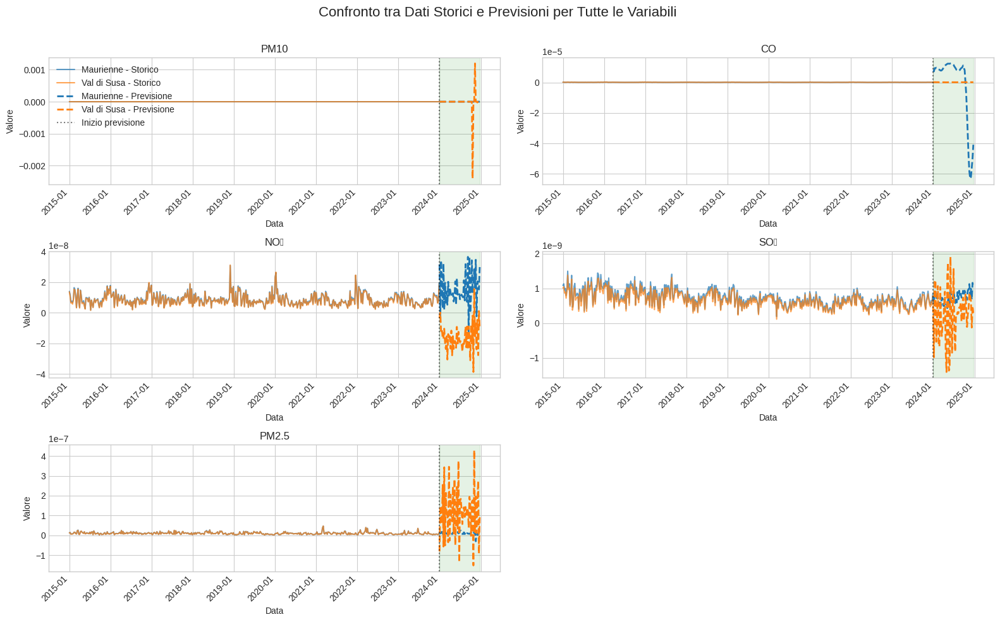

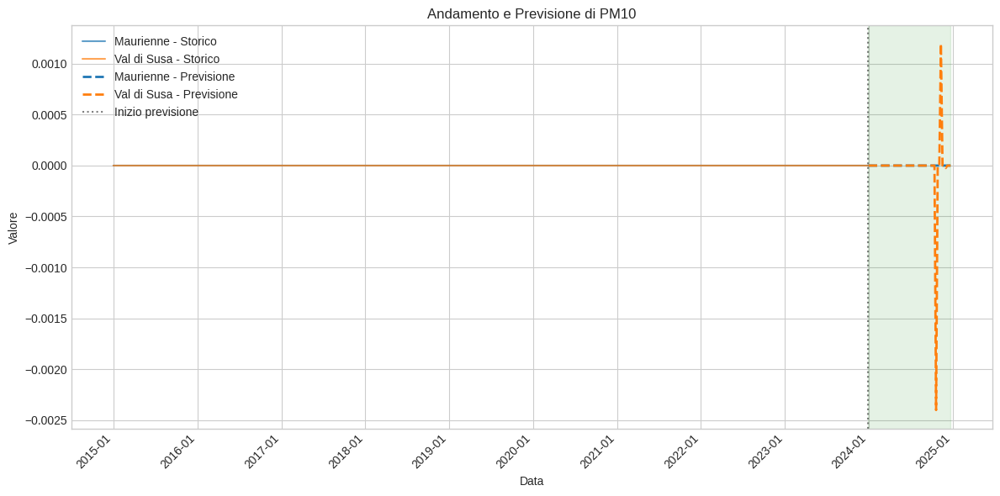

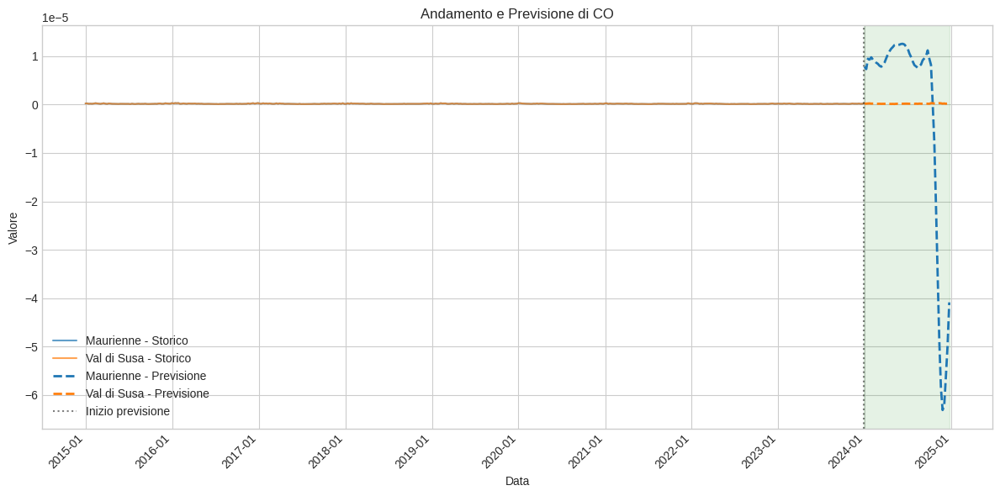

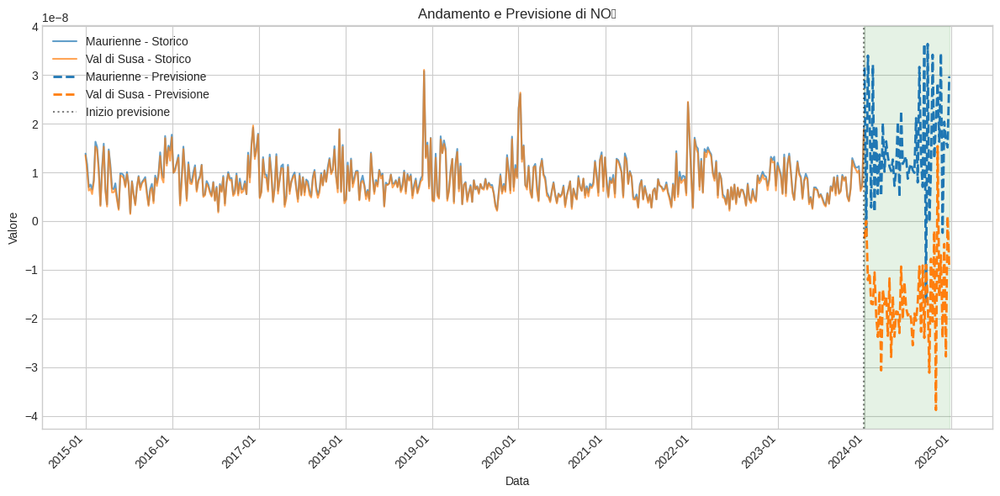

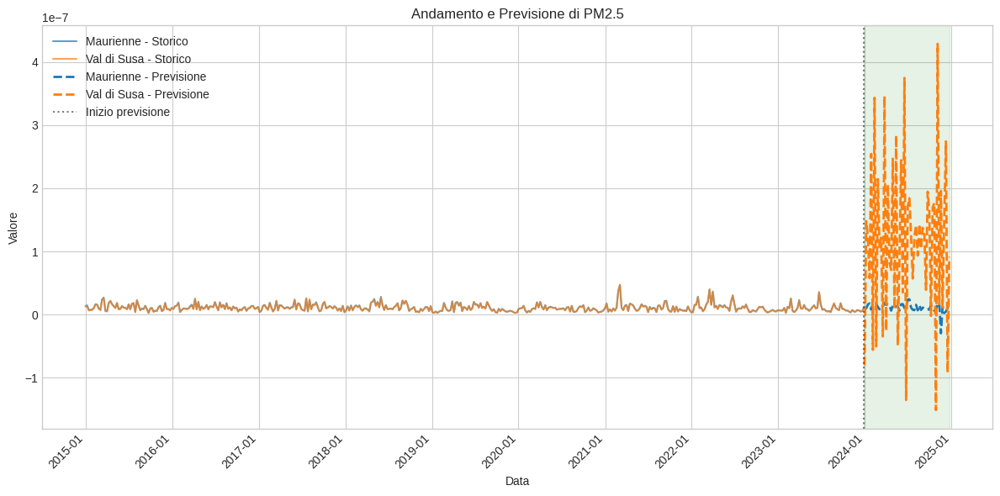

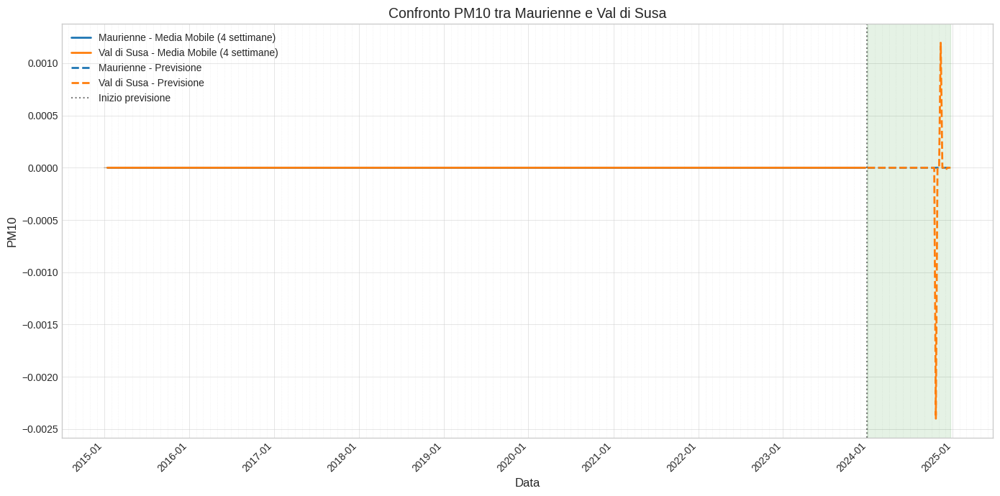

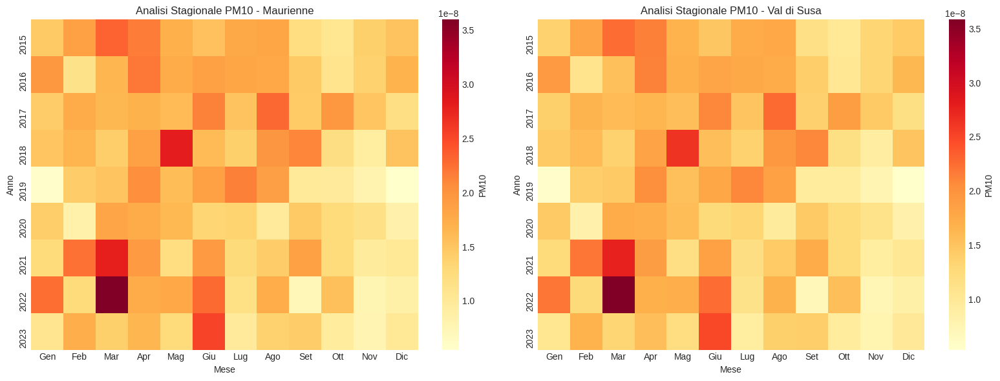

In [3]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import os
import numpy as np
from matplotlib.gridspec import GridSpec
import seaborn as sns

# Impostazione stile
plt.style.use('seaborn-v0_8-whitegrid')
sns.set_palette("colorblind")

print("=== Script di Visualizzazione delle Previsioni della Qualità dell'Aria ===")

# Caricamento dati storici
print("\n1. Caricamento dati storici...")
try:
    historical_df = pd.read_csv("./processed_data/air_quality_data_complete.csv")
    historical_df["date"] = pd.to_datetime(historical_df["date"])
    print(f"Dati storici caricati: {len(historical_df)} record")
except Exception as e:
    print(f"Errore nel caricamento dei dati storici: {e}")
    historical_df = None

# Caricamento dati delle previsioni
print("\n2. Caricamento previsioni...")
try:
    forecast_df = pd.read_csv("./processed_data/forecast_air_quality.csv")
    forecast_df["Date"] = pd.to_datetime(forecast_df["Date"])
    print(f"Previsioni caricate: {len(forecast_df)} record")
    print(f"Periodo previsione: da {forecast_df['Date'].min()} a {forecast_df['Date'].max()}")
except Exception as e:
    print(f"Errore nel caricamento delle previsioni: {e}")
    forecast_df = None

# Definizione delle regioni e variabili
regions = ["Maurienne", "Val di Susa"]
variables = ["pm10_value", "co_value", "no2_value", "so2_value", "pm2.5_value"]
variables_names = {
    "pm10_value": "PM10",
    "co_value": "CO",
    "no2_value": "NO₂",
    "so2_value": "SO₂",
    "pm2.5_value": "PM2.5"
}
variables_units = {}

# Estrazione delle unità di misura dai dati storici
if historical_df is not None:
    for var in variables:
        unit_col = f"{var}_units"
        if unit_col in historical_df.columns:
            # Prendi la prima unità di misura disponibile
            units = historical_df[unit_col].iloc[0]
            variables_units[var] = units
            print(f"Unità di misura per {variables_names[var]}: {units}")

# Preparazione dati per il plotting
historical_data = {}
for region in regions:
    historical_data[region] = {}
    if historical_df is not None:
        region_data = historical_df[historical_df["region"] == region]
        region_data = region_data.sort_values("date")
        for var in variables:
            if var in region_data.columns:
                historical_data[region][var] = pd.Series(
                    data=region_data[var].values,
                    index=region_data["date"]
                )

# Creazione directory per i grafici se non esiste
output_dir = "./processed_data/plots"
if not os.path.exists(output_dir):
    os.makedirs(output_dir)
    print(f"Creata directory per i grafici: {output_dir}")

# Creazione dei grafici
print("\n3. Creazione grafici...")

# Colori per le regioni
region_colors = {
    "Maurienne": "#1f77b4",  # Blu
    "Val di Susa": "#ff7f0e"  # Arancione
}

# 1. Visualizzazione comparativa delle variabili per entrambe le regioni
print("Creazione grafico comparativo delle variabili...")
fig_comp = plt.figure(figsize=(16, 10))
gs = GridSpec(3, 2, figure=fig_comp)

last_historical_date = None
if historical_df is not None:
    last_historical_date = historical_df["date"].max()

for i, var in enumerate(variables):
    row, col = i // 2, i % 2
    
    if i < 5:  # Solo 5 variabili disponibili
        ax = fig_comp.add_subplot(gs[row, col])
        
        # Plot dati storici
        for region in regions:
            if var in historical_data[region]:
                ax.plot(
                    historical_data[region][var].index,
                    historical_data[region][var].values,
                    label=f"{region} - Storico",
                    color=region_colors[region],
                    alpha=0.7
                )
        
        # Plot previsioni
        if forecast_df is not None:
            for region in regions:
                forecast_col = f"{region}_{var}"
                if forecast_col in forecast_df.columns:
                    ax.plot(
                        forecast_df["Date"],
                        forecast_df[forecast_col],
                        label=f"{region} - Previsione",
                        color=region_colors[region],
                        linestyle="--",
                        linewidth=2
                    )
        
        # Linea di separazione tra dati storici e previsioni
        if last_historical_date:
            ax.axvline(
                x=last_historical_date,
                color='black',
                linestyle=':',
                alpha=0.5,
                label="Inizio previsione"
            )
        
        # Formattazione asse X
        ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m'))
        ax.xaxis.set_major_locator(mdates.YearLocator())
        plt.setp(ax.xaxis.get_majorticklabels(), rotation=45, ha='right')
        
        # Titolo e etichette
        unit_text = f" ({variables_units.get(var, '')})" if var in variables_units else ""
        ax.set_title(f"{variables_names.get(var, var)}{unit_text}")
        ax.set_xlabel("Data")
        ax.set_ylabel(f"Valore{unit_text}")
        
        # Legenda solo per il primo grafico
        if i == 0:
            ax.legend(loc="upper left")
        
        # Evidenzia la zona di previsione
        if forecast_df is not None and last_historical_date:
            ax.axvspan(
                last_historical_date,
                forecast_df["Date"].max(),
                alpha=0.1,
                color='green',
                label="Periodo di previsione"
            )

plt.suptitle('Confronto tra Dati Storici e Previsioni per Tutte le Variabili', fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.97])
plt.savefig(f"{output_dir}/confronto_tutte_variabili.png", dpi=300)
plt.savefig(f"{output_dir}/confronto_tutte_variabili.pdf")
print(f"Salvato grafico confronto in {output_dir}/confronto_tutte_variabili.png")

# 2. Grafici individuali per ogni variabile con maggiori dettagli
print("Creazione grafici individuali per variabile...")
for var in variables:
    fig, ax = plt.subplots(figsize=(12, 6))
    
    # Plot dati storici
    for region in regions:
        if var in historical_data[region]:
            ax.plot(
                historical_data[region][var].index,
                historical_data[region][var].values,
                label=f"{region} - Storico",
                color=region_colors[region],
                alpha=0.7
            )
    
    # Plot previsioni
    if forecast_df is not None:
        for region in regions:
            forecast_col = f"{region}_{var}"
            if forecast_col in forecast_df.columns:
                ax.plot(
                    forecast_df["Date"],
                    forecast_df[forecast_col],
                    label=f"{region} - Previsione",
                    color=region_colors[region],
                    linestyle="--",
                    linewidth=2
                )
    
    # Linea di separazione
    if last_historical_date:
        ax.axvline(
            x=last_historical_date,
            color='black',
            linestyle=':',
            alpha=0.5,
            label="Inizio previsione"
        )
    
    # Formattazione asse X
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m'))
    ax.xaxis.set_major_locator(mdates.YearLocator())
    plt.setp(ax.xaxis.get_majorticklabels(), rotation=45, ha='right')
    
    # Titolo e etichette
    unit_text = f" ({variables_units.get(var, '')})" if var in variables_units else ""
    ax.set_title(f"Andamento e Previsione di {variables_names.get(var, var)}{unit_text}")
    ax.set_xlabel("Data")
    ax.set_ylabel(f"Valore{unit_text}")
    
    # Legenda
    ax.legend(loc="best")
    
    # Evidenzia la zona di previsione
    if forecast_df is not None and last_historical_date:
        ax.axvspan(
            last_historical_date,
            forecast_df["Date"].max(),
            alpha=0.1,
            color='green'
        )
    
    plt.tight_layout()
    plt.savefig(f"{output_dir}/{var}_andamento.png", dpi=300)
    print(f"Salvato grafico di {var} in {output_dir}/{var}_andamento.png")

# 3. Grafico di confronto tra regioni per PM10 (variabile principale)
print("Creazione grafico di confronto PM10 tra regioni...")
var = "pm10_value"
fig, ax = plt.subplots(figsize=(14, 7))

# Calcola la media mobile per rendere il trend più visibile
window_size = 4  # Media mobile di 4 settimane (1 mese)

# Plot dati storici con media mobile
for region in regions:
    if var in historical_data[region]:
        # Dati originali (trasparenti)
        ax.plot(
            historical_data[region][var].index,
            historical_data[region][var].values,
            color=region_colors[region],
            alpha=0.3,
            linewidth=1
        )
        
        # Media mobile (linea più spessa)
        rolling_mean = historical_data[region][var].rolling(window=window_size, center=True).mean()
        ax.plot(
            rolling_mean.index,
            rolling_mean.values,
            label=f"{region} - Media Mobile ({window_size} settimane)",
            color=region_colors[region],
            linewidth=2
        )

# Plot previsioni
if forecast_df is not None:
    for region in regions:
        forecast_col = f"{region}_{var}"
        if forecast_col in forecast_df.columns:
            ax.plot(
                forecast_df["Date"],
                forecast_df[forecast_col],
                label=f"{region} - Previsione",
                color=region_colors[region],
                linestyle="--",
                linewidth=2
            )

# Linea di separazione
if last_historical_date:
    ax.axvline(
        x=last_historical_date,
        color='black',
        linestyle=':',
        alpha=0.5,
        label="Inizio previsione"
    )

# Formattazione asse X con più dettagli
ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m'))
ax.xaxis.set_major_locator(mdates.YearLocator())
ax.xaxis.set_minor_locator(mdates.MonthLocator())
plt.setp(ax.xaxis.get_majorticklabels(), rotation=45, ha='right')

# Titolo e etichette
unit_text = f" ({variables_units.get(var, '')})" if var in variables_units else ""
ax.set_title(f"Confronto {variables_names.get(var, var)} tra Maurienne e Val di Susa{unit_text}", fontsize=14)
ax.set_xlabel("Data", fontsize=12)
ax.set_ylabel(f"{variables_names.get(var, var)}{unit_text}", fontsize=12)

# Legenda
ax.legend(loc="upper left", fontsize=10)

# Griglia più evidente
ax.grid(True, which='major', linestyle='-', linewidth=0.5, alpha=0.7)
ax.grid(True, which='minor', linestyle=':', linewidth=0.5, alpha=0.4)

# Evidenzia la zona di previsione
if forecast_df is not None and last_historical_date:
    ax.axvspan(
        last_historical_date,
        forecast_df["Date"].max(),
        alpha=0.1,
        color='green',
        label="Periodo di previsione"
    )

plt.tight_layout()
plt.savefig(f"{output_dir}/confronto_pm10_regioni.png", dpi=300)
plt.savefig(f"{output_dir}/confronto_pm10_regioni.pdf")
print(f"Salvato grafico confronto PM10 in {output_dir}/confronto_pm10_regioni.png")

# 4. Analisi stagionale per PM10
print("Creazione grafico analisi stagionale PM10...")
try:
    if historical_df is not None:
        fig, axes = plt.subplots(1, 2, figsize=(16, 6))
        
        for i, region in enumerate(regions):
            region_data = historical_df[historical_df["region"] == region].copy()
            if len(region_data) > 0:
                region_data['month'] = region_data['date'].dt.month
                region_data['year'] = region_data['date'].dt.year
                
                # Calcola le medie mensili per ogni anno
                seasonal_data = region_data.groupby(['year', 'month'])[var].mean().unstack()
                
                # Plot heatmap
                if len(seasonal_data) > 0:
                    sns.heatmap(
                        seasonal_data, 
                        cmap="YlOrRd", 
                        ax=axes[i],
                        cbar_kws={'label': f"{variables_names.get(var, var)}{unit_text}"}
                    )
                    axes[i].set_title(f"Analisi Stagionale {variables_names.get(var, var)} - {region}")
                    axes[i].set_xlabel("Mese")
                    axes[i].set_ylabel("Anno")
                    
                    # Fix per le labels dei mesi
                    month_labels = ['Gen', 'Feb', 'Mar', 'Apr', 'Mag', 'Giu', 'Lug', 'Ago', 'Set', 'Ott', 'Nov', 'Dic']
                    axes[i].set_xticklabels(month_labels)
                else:
                    axes[i].text(0.5, 0.5, "Dati insufficienti per l'analisi stagionale", 
                                ha='center', va='center', fontsize=12)
        
        plt.tight_layout()
        plt.savefig(f"{output_dir}/analisi_stagionale_pm10.png", dpi=300)
        print(f"Salvato grafico analisi stagionale in {output_dir}/analisi_stagionale_pm10.png")
except Exception as e:
    print(f"Errore nella creazione dell'analisi stagionale: {e}")

print("\n=== Visualizzazione completata ===")
print(f"Tutti i grafici sono stati salvati nella directory: {output_dir}")

=== Script di Visualizzazione Geografica delle Previsioni ===
Creata directory per i grafici: ./processed_data/geo_plots

1. Caricamento previsioni...
Previsioni caricate: 52 record
Periodo previsione: da 2023-12-31 00:00:00 a 2024-12-22 00:00:00
Dati storici caricati: 940 record
Ultima data storica: 2023-12-28 00:00:00

2. Creazione visualizzazione geografica...
Salvata mappa delle previsioni in ./processed_data/geo_plots/mappa_previsioni.png

3. Creazione visualizzazione geografica temporale per PM10...
Salvata evoluzione temporale PM10 in ./processed_data/geo_plots/evoluzione_temporale_pm10.png

=== Visualizzazione Geografica Completata ===
Tutti i grafici sono stati salvati nella directory: ./processed_data/geo_plots


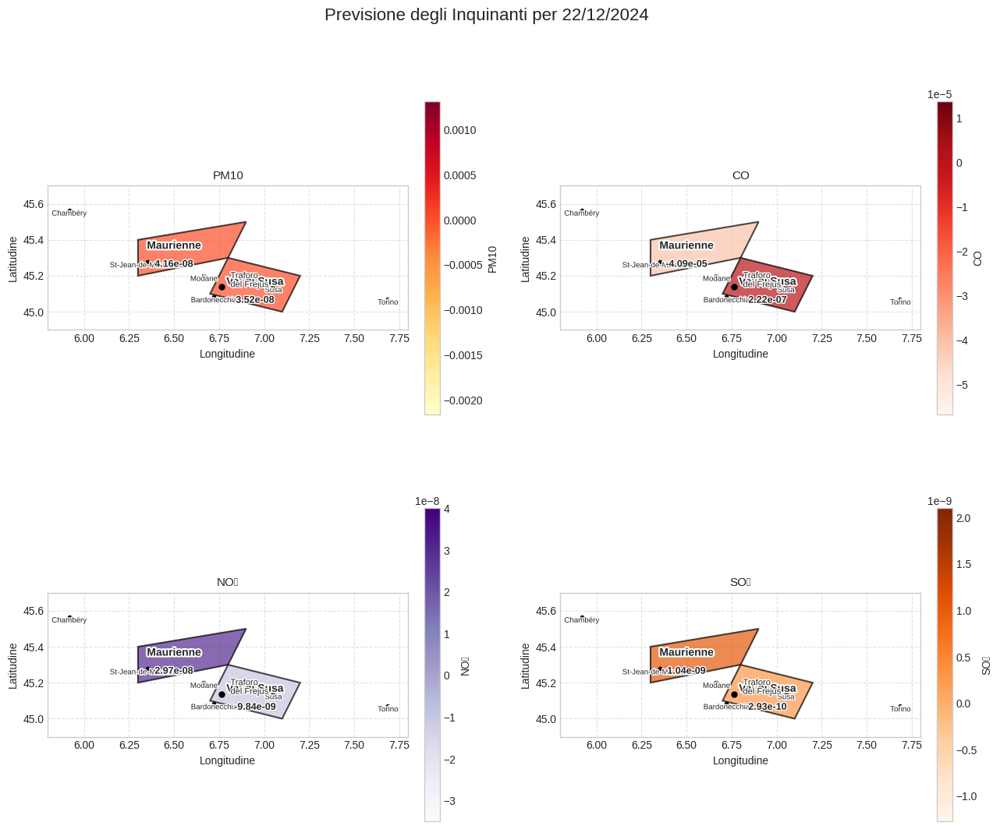

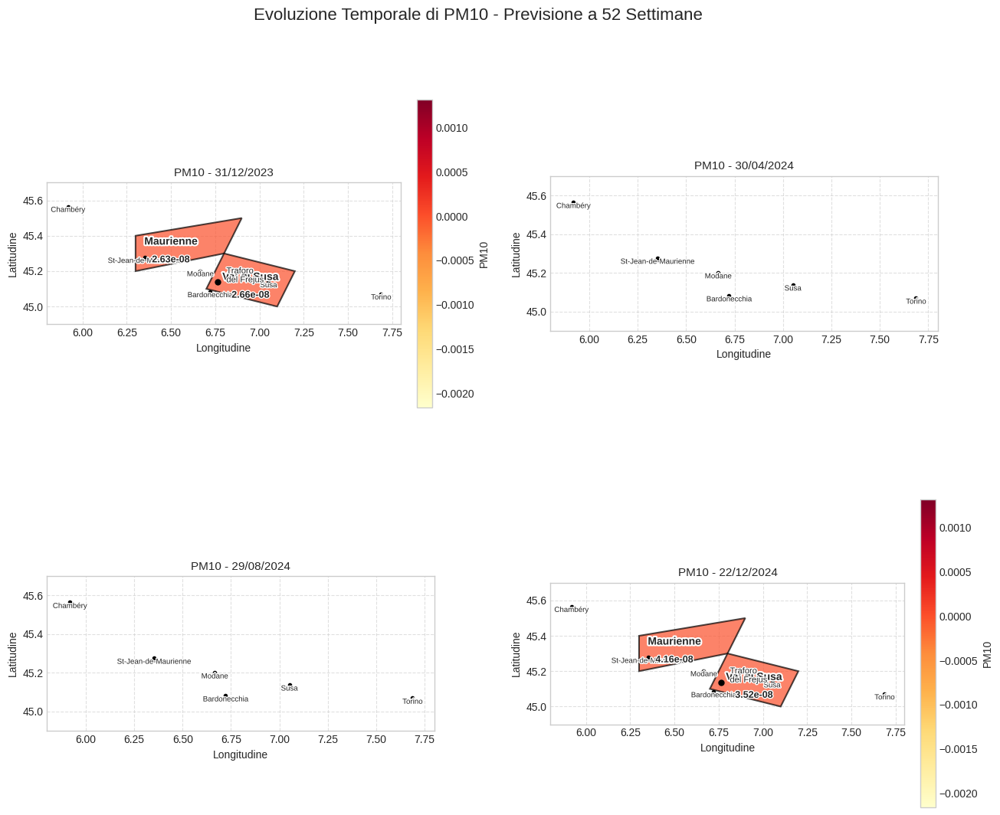

In [4]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.dates as mdates
from matplotlib.colors import LinearSegmentedColormap
from matplotlib.patches import Polygon
import matplotlib.patheffects as PathEffects
import os
from matplotlib.gridspec import GridSpec
import matplotlib.colors as mcolors
from matplotlib.cm import ScalarMappable

print("=== Script di Visualizzazione Geografica delle Previsioni ===")

# Crea directory per i grafici se non esiste
output_dir = "./processed_data/geo_plots"
if not os.path.exists(output_dir):
    os.makedirs(output_dir)
    print(f"Creata directory per i grafici: {output_dir}")

# Caricamento dati delle previsioni
print("\n1. Caricamento previsioni...")
try:
    forecast_df = pd.read_csv("./processed_data/forecast_air_quality.csv")
    forecast_df["Date"] = pd.to_datetime(forecast_df["Date"])
    print(f"Previsioni caricate: {len(forecast_df)} record")
    print(f"Periodo previsione: da {forecast_df['Date'].min()} a {forecast_df['Date'].max()}")
except Exception as e:
    print(f"Errore nel caricamento delle previsioni: {e}")
    raise

# Caricamento dati storici per confronto
try:
    historical_df = pd.read_csv("./processed_data/air_quality_data_complete.csv")
    historical_df["date"] = pd.to_datetime(historical_df["date"])
    print(f"Dati storici caricati: {len(historical_df)} record")
    
    # Estrarre le ultime date dei dati storici
    last_date = historical_df["date"].max()
    print(f"Ultima data storica: {last_date}")
except Exception as e:
    print(f"Errore nel caricamento dei dati storici: {e}")
    historical_df = None
    last_date = None

# Definizione delle coordinate geografiche approssimative per Maurienne e Val di Susa
# Coordinate approssimative dei punti che formano le valli (in formato: lon, lat)
maurienne_coords = [
    (6.3, 45.2),   # Sud-ovest
    (6.8, 45.3),   # Sud-est
    (6.9, 45.5),   # Nord-est
    (6.3, 45.4)    # Nord-ovest
]

val_di_susa_coords = [
    (6.7, 45.1),   # Sud-ovest
    (7.1, 45.0),   # Sud-est
    (7.2, 45.2),   # Nord-est
    (6.8, 45.3)    # Nord-ovest
]

# Località principali nella zona
cities = {
    'Modane': (6.6653, 45.2014),      # Maurienne
    'St-Jean-de-Maurienne': (6.3518, 45.2768),  # Maurienne
    'Susa': (7.0514, 45.1386),        # Val di Susa
    'Bardonecchia': (6.7215, 45.0827), # Val di Susa
    'Torino': (7.6869, 45.0703),      # Riferimento
    'Chambéry': (5.9180, 45.5647)     # Riferimento
}

# Coordinate approssimative del traforo del Frejus
frejus_tunnel = (6.7631, 45.1372)

# Variabili da visualizzare
variables = ["pm10_value", "co_value", "no2_value", "so2_value"]
variables_names = {
    "pm10_value": "PM10",
    "co_value": "CO",
    "no2_value": "NO₂",
    "so2_value": "SO₂",
    "pm2.5_value": "PM2.5"
}

# Estrazione unità di misura
variables_units = {}
for var in variables:
    unit_col = f"{var}_units"
    if historical_df is not None and unit_col in historical_df.columns:
        units = historical_df[unit_col].iloc[0]
        variables_units[var] = units

# Funzione per estrarre i valori di previsione per una data specifica
def get_forecast_for_date(date, variable):
    date_row = forecast_df[forecast_df["Date"] == date]
    if len(date_row) == 0:
        return None, None
    
    maurienne_val = date_row[f"Maurienne_{variable}"].values[0] if f"Maurienne_{variable}" in date_row else None
    val_di_susa_val = date_row[f"Val di Susa_{variable}"].values[0] if f"Val di Susa_{variable}" in date_row else None
    
    return maurienne_val, val_di_susa_val

# Seleziona alcune date per la visualizzazione (inizio, metà e fine previsione)
forecast_dates = []
if len(forecast_df) > 0:
    # Seleziona 4 date distribuite nel periodo di previsione
    forecast_dates = [
        forecast_df["Date"].min(),
        forecast_df["Date"].min() + pd.Timedelta(days=int(len(forecast_df)/3*7)),
        forecast_df["Date"].min() + pd.Timedelta(days=int(len(forecast_df)/3*2*7)),
        forecast_df["Date"].max()
    ]

# Funzione per creare i poligoni delle valli con colore basato sul valore
def create_valley_polygons(ax, maurienne_value, val_di_susa_value, cmap, norm, variable_name):
    # Crea poligono per Maurienne
    maurienne_poly = Polygon(maurienne_coords, closed=True, 
                            facecolor=cmap(norm(maurienne_value)) if maurienne_value is not None else 'lightgray',
                            edgecolor='black', alpha=0.7, linewidth=1.5,
                            label=f"Maurienne: {maurienne_value:.2e}")
    ax.add_patch(maurienne_poly)
    
    # Crea poligono per Val di Susa
    val_di_susa_poly = Polygon(val_di_susa_coords, closed=True, 
                              facecolor=cmap(norm(val_di_susa_value)) if val_di_susa_value is not None else 'lightgray',
                              edgecolor='black', alpha=0.7, linewidth=1.5,
                              label=f"Val di Susa: {val_di_susa_value:.2e}")
    ax.add_patch(val_di_susa_poly)
    
    # Aggiungi etichette delle valli
    txt1 = ax.text(6.5, 45.35, "Maurienne", fontsize=10, ha='center', weight='bold')
    txt1.set_path_effects([PathEffects.withStroke(linewidth=3, foreground='white')])
    
    txt2 = ax.text(6.95, 45.15, "Val di Susa", fontsize=10, ha='center', weight='bold')
    txt2.set_path_effects([PathEffects.withStroke(linewidth=3, foreground='white')])
    
    # Aggiungi traforo del Frejus
    ax.plot(frejus_tunnel[0], frejus_tunnel[1], 'ko', markersize=5)
    txt3 = ax.text(frejus_tunnel[0]+0.05, frejus_tunnel[1], "Traforo\ndel Frejus", fontsize=8)
    txt3.set_path_effects([PathEffects.withStroke(linewidth=2, foreground='white')])

# Funzione per creare la mappa di base
def setup_map(ax, title):
    ax.set_xlim(5.8, 7.8)
    ax.set_ylim(44.9, 45.7)
    
    # Aggiungi città principali
    for city, (lon, lat) in cities.items():
        ax.plot(lon, lat, 'ko', markersize=3)
        txt = ax.text(lon, lat-0.03, city, fontsize=7, ha='center')
        txt.set_path_effects([PathEffects.withStroke(linewidth=2, foreground='white')])
    
    # Aggiungi titolo
    ax.set_title(title, fontsize=11)
    
    # Configurazione estetica
    ax.set_aspect('equal')
    ax.grid(True, linestyle='--', alpha=0.6)
    ax.set_xlabel('Longitudine')
    ax.set_ylabel('Latitudine')

# Inizio creazione del grafico con 2x2 subplot
print("\n2. Creazione visualizzazione geografica...")

# Seleziona le variabili da visualizzare (limita a 4)
plot_variables = variables[:4]  # prime 4 variabili

# Crea figura e griglia di subplot
fig = plt.figure(figsize=(15, 12))
gs = GridSpec(2, 2, figure=fig, wspace=0.3, hspace=0.3)

# Crea colormap personalizzata per ciascuna variabile
cmaps = {
    "pm10_value": plt.cm.YlOrRd,  # Giallo-arancione-rosso (standard per inquinamento)
    "co_value": plt.cm.Reds,      # Rossi (CO è spesso associato al rosso)
    "no2_value": plt.cm.Purples,  # Viola (NO2 è spesso visualizzato in viola)
    "so2_value": plt.cm.Oranges   # Arancioni (colore diverso per distinguere)
}

# Trova i valori min e max per ciascuna variabile per normalizzare la scala dei colori
value_ranges = {}
for var in plot_variables:
    if f"Maurienne_{var}" in forecast_df.columns and f"Val di Susa_{var}" in forecast_df.columns:
        # Combina i valori di entrambe le regioni
        all_values = pd.concat([
            forecast_df[f"Maurienne_{var}"], 
            forecast_df[f"Val di Susa_{var}"]
        ]).dropna()
        
        if len(all_values) > 0:
            vmin, vmax = all_values.min(), all_values.max()
            # Aggiungi un margine per la visualizzazione
            value_ranges[var] = (vmin*0.9, vmax*1.1)
        else:
            value_ranges[var] = (0, 1)  # Default fallback
    else:
        value_ranges[var] = (0, 1)  # Default fallback

# Per ogni data di previsione, crea un subplot con 4 mappe (una per variabile)
for i, var in enumerate(plot_variables):
    row, col = i // 2, i % 2
    ax = fig.add_subplot(gs[row, col])
    
    # Imposta la mappa di base
    unit_text = f" ({variables_units.get(var, '')})" if var in variables_units else ""
    setup_map(ax, f"{variables_names.get(var, var)}{unit_text}")
    
    # Definisci la normalizzazione del colore
    vmin, vmax = value_ranges.get(var, (0, 1))
    norm = plt.Normalize(vmin, vmax)
    cmap = cmaps.get(var, plt.cm.YlOrRd)
    
    # Seleziona la data di previsione (usiamo l'ultima disponibile per tutte le variabili)
    forecast_date = forecast_dates[-1] if forecast_dates else None
    
    if forecast_date:
        maurienne_val, val_di_susa_val = get_forecast_for_date(forecast_date, var)
        
        if maurienne_val is not None and val_di_susa_val is not None:
            # Visualizza le valli colorate in base ai valori previsti
            create_valley_polygons(ax, maurienne_val, val_di_susa_val, cmap, norm, variables_names.get(var, var))
            
            # Aggiungi colorbar
            sm = ScalarMappable(cmap=cmap, norm=norm)
            sm.set_array([])
            cbar = plt.colorbar(sm, ax=ax, fraction=0.046, pad=0.04)
            cbar.set_label(f"{variables_names.get(var, var)}{unit_text}")
            
            # Aggiungi i valori come testo
            value_txt1 = ax.text(6.5, 45.25, f"{maurienne_val:.2e}", fontsize=9, ha='center', weight='bold')
            value_txt1.set_path_effects([PathEffects.withStroke(linewidth=2, foreground='white')])
            
            value_txt2 = ax.text(6.95, 45.05, f"{val_di_susa_val:.2e}", fontsize=9, ha='center', weight='bold')
            value_txt2.set_path_effects([PathEffects.withStroke(linewidth=2, foreground='white')])
        else:
            ax.text(0.5, 0.5, "Dati non disponibili", transform=ax.transAxes, 
                   ha='center', va='center', fontsize=10)

# Aggiungi un titolo globale con la data di previsione
if forecast_dates:
    forecast_date_str = forecast_dates[-1].strftime('%d/%m/%Y')
    plt.suptitle(f'Previsione degli Inquinanti per {forecast_date_str}', fontsize=16, y=0.98)
else:
    plt.suptitle('Previsione degli Inquinanti', fontsize=16, y=0.98)

# Salva la figura
plt.savefig(f"{output_dir}/mappa_previsioni.png", dpi=300, bbox_inches='tight')
plt.savefig(f"{output_dir}/mappa_previsioni.pdf", bbox_inches='tight')
print(f"Salvata mappa delle previsioni in {output_dir}/mappa_previsioni.png")

# Crea visualizzazione per diverse date di previsione per PM10
print("\n3. Creazione visualizzazione geografica temporale per PM10...")
fig2 = plt.figure(figsize=(15, 12))
gs2 = GridSpec(2, 2, figure=fig2, wspace=0.3, hspace=0.3)

# Variabile da visualizzare
var = "pm10_value"
vmin, vmax = value_ranges.get(var, (0, 1))
norm = plt.Normalize(vmin, vmax)
cmap = cmaps.get(var, plt.cm.YlOrRd)

# Crea una sottofigura per ciascuna data
for i, forecast_date in enumerate(forecast_dates):
    if i >= 4:  # Limita a 4 grafici
        break
        
    row, col = i // 2, i % 2
    ax = fig2.add_subplot(gs2[row, col])
    
    # Imposta la mappa di base
    date_str = forecast_date.strftime('%d/%m/%Y')
    unit_text = f" ({variables_units.get(var, '')})" if var in variables_units else ""
    setup_map(ax, f"{variables_names.get(var, var)}{unit_text} - {date_str}")
    
    # Ottieni i valori previsti per questa data
    maurienne_val, val_di_susa_val = get_forecast_for_date(forecast_date, var)
    
    if maurienne_val is not None and val_di_susa_val is not None:
        # Visualizza le valli colorate in base ai valori previsti
        create_valley_polygons(ax, maurienne_val, val_di_susa_val, cmap, norm, variables_names.get(var, var))
        
        # Aggiungi colorbar
        sm = ScalarMappable(cmap=cmap, norm=norm)
        sm.set_array([])
        cbar = plt.colorbar(sm, ax=ax, fraction=0.046, pad=0.04)
        cbar.set_label(f"{variables_names.get(var, var)}{unit_text}")
        
        # Aggiungi i valori come testo
        value_txt1 = ax.text(6.5, 45.25, f"{maurienne_val:.2e}", fontsize=9, ha='center', weight='bold')
        value_txt1.set_path_effects([PathEffects.withStroke(linewidth=2, foreground='white')])
        
        value_txt2 = ax.text(6.95, 45.05, f"{val_di_susa_val:.2e}", fontsize=9, ha='center', weight='bold')
        value_txt2.set_path_effects([PathEffects.withStroke(linewidth=2, foreground='white')])

# Aggiungi un titolo globale
plt.suptitle(f'Evoluzione Temporale di {variables_names.get(var, var)} - Previsione a 52 Settimane', fontsize=16, y=0.98)

# Salva la figura
plt.savefig(f"{output_dir}/evoluzione_temporale_pm10.png", dpi=300, bbox_inches='tight')
plt.savefig(f"{output_dir}/evoluzione_temporale_pm10.pdf", bbox_inches='tight')
print(f"Salvata evoluzione temporale PM10 in {output_dir}/evoluzione_temporale_pm10.png")

print("\n=== Visualizzazione Geografica Completata ===")
print(f"Tutti i grafici sono stati salvati nella directory: {output_dir}")

In [7]:
# Esegui questa cella per installare le librerie necessarie
!pip install numpy pandas matplotlib scikit-learn seaborn

In [8]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os
from sklearn.linear_model import Ridge, LinearRegression
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
import matplotlib.dates as mdates
import warnings
import seaborn as sns

warnings.filterwarnings("ignore")

print("=== Script per previsioni annuali della qualità dell'aria (2023-2050) ===")

# Creazione directory per i risultati
output_dir = "./processed_data/annual_forecast_2050"
if not os.path.exists(output_dir):
    os.makedirs(output_dir)
    print(f"Creata directory per i risultati: {output_dir}")

# Caricamento dati
print("\n1. Caricamento dati...")
try:
    df = pd.read_csv("./processed_data/air_quality_data_complete.csv")
    df["date"] = pd.to_datetime(df["date"])
    print(f"Dati caricati: {len(df)} record")
    print(f"Periodo: da {df['date'].min()} a {df['date'].max()}")
except Exception as e:
    print(f"Errore nel caricamento dei dati: {e}")
    raise

# Impostazione delle variabili e regioni
regions = ["Maurienne", "Val di Susa"]
variables = ["pm10_value", "co_value", "no2_value", "so2_value", "pm2.5_value"]
variables_names = {
    "pm10_value": "PM10",
    "co_value": "CO",
    "no2_value": "NO₂",
    "so2_value": "SO₂",
    "pm2.5_value": "PM2.5"
}

# Estrazione delle unità di misura
variables_units = {}
for var in variables:
    unit_col = f"{var}_units"
    if unit_col in df.columns:
        units = df[unit_col].iloc[0]
        variables_units[var] = units

# Preparazione dei dati: aggregazione annuale
print("\n2. Aggregazione dei dati a livello annuale...")
annual_data = {}

for region in regions:
    print(f"\nAnalisi regione: {region}")
    region_df = df[df["region"] == region].copy()
    
    if len(region_df) == 0:
        print(f"Nessun dato disponibile per {region}")
        continue
        
    print(f"Record disponibili: {len(region_df)}")
    
    # Aggiunta dell'anno come colonna
    region_df['year'] = region_df['date'].dt.year
    
    # Aggregazione annuale
    annual_df = region_df.groupby('year').agg({
        var: 'mean' for var in variables if var in region_df.columns
    }).reset_index()
    
    # Verifica la disponibilità dei dati
    if len(annual_df) < 5:  # Richiediamo almeno 5 anni di dati
        print(f"Dati annuali insufficienti per {region}: {len(annual_df)} anni")
        continue
        
    print(f"Anni disponibili: {annual_df['year'].min()} - {annual_df['year'].max()}")
    
    # Memorizza i dati annuali
    annual_data[region] = annual_df

# Definizione di scenari per le previsioni a lungo termine
scenarios = {
    "baseline": {
        "description": "Scenario in cui i trend attuali continuano senza grandi cambiamenti",
        "trend_factor": 1.0,  # mantiene il trend attuale
        "adjust_factor": 0.0  # nessun aggiustamento
    },
    "improvement": {
        "description": "Scenario con miglioramento progressivo della qualità dell'aria grazie a politiche ambientali",
        "trend_factor": 0.8,  # riduce l'impatto dei trend negativi
        "adjust_factor": -0.02  # riduzione annuale per politiche di miglioramento
    },
    "deterioration": {
        "description": "Scenario con deterioramento dovuto ad aumento traffico e cambiamenti climatici",
        "trend_factor": 1.2,  # aumenta l'impatto dei trend
        "adjust_factor": 0.015  # aumento annuale dovuto a fattori negativi
    }
}

# Classe di modellazione per previsioni a lungo termine su base annuale
class AnnualForecastModel:
    def __init__(self, region, variable, data):
        self.region = region
        self.variable = variable
        self.data = data
        self.models = {}
        self.forecasts = {}
        self.metrics = {}
        
    def prepare_data(self):
        """Prepara X e y per il modello."""
        if self.variable not in self.data.columns:
            raise ValueError(f"Variabile {self.variable} non presente nei dati")
        
        # X sarà semplicemente l'anno
        self.X = self.data[['year']]
        self.y = self.data[self.variable]
        
        # Splitting dei dati cronologicamente
        if len(self.data) <= 5:
            # Se abbiamo pochi dati, usa tutti per training
            self.X_train = self.X
            self.y_train = self.y
            self.X_test = self.X.iloc[-2:]  # Uso gli ultimi 2 anni per test
            self.y_test = self.y.iloc[-2:]
        else:
            # Altrimenti usa gli ultimi 2 anni per test
            split_point = len(self.data) - 2
            self.X_train = self.X.iloc[:split_point]
            self.y_train = self.y.iloc[:split_point]
            self.X_test = self.X.iloc[split_point:]
            self.y_test = self.y.iloc[split_point:]
        
    def train_models(self):
        """Addestra diversi modelli e seleziona il migliore."""
        self.prepare_data()
        
        # Definizione dei modelli
        models = {
            "Linear": LinearRegression(),
            "Ridge": Ridge(alpha=1.0),
            "RandomForest": RandomForestRegressor(n_estimators=100, random_state=42),
            "GradientBoosting": GradientBoostingRegressor(n_estimators=100, random_state=42)
        }
        
        # Addestramento e valutazione
        best_score = -np.inf
        best_model_name = None
        
        for name, model in models.items():
            print(f"Addestramento modello {name} per {self.region} - {self.variable}...")
            model.fit(self.X_train, self.y_train)
            self.models[name] = model
            
            # Valutazione
            if len(self.X_test) > 0:
                y_pred = model.predict(self.X_test)
                rmse = np.sqrt(mean_squared_error(self.y_test, y_pred))
                mae = mean_absolute_error(self.y_test, y_pred)
                r2 = r2_score(self.y_test, y_pred) if len(np.unique(self.y_test)) > 1 else 0
                
                self.metrics[name] = {
                    "RMSE": rmse,
                    "MAE": mae,
                    "R2": r2
                }
                
                print(f"  {name} - RMSE: {rmse:.6f}, MAE: {mae:.6f}, R²: {r2:.4f}")
                
                # Selezione del miglior modello (usa MAE per stabilità)
                if mae < self.metrics.get(best_model_name, {}).get("MAE", float('inf')):
                    best_score = mae
                    best_model_name = name
            else:
                # Se non abbiamo dati di test, usa il modello più semplice
                self.metrics[name] = {"RMSE": 0, "MAE": 0, "R2": 0}
                if best_model_name is None or name == "Linear":
                    best_model_name = name
        
        self.best_model_name = best_model_name
        print(f"Miglior modello per {self.region} - {self.variable}: {best_model_name}")
        
    def forecast_to_2050(self, scenarios):
        """Genera previsioni annuali fino al 2050 per diversi scenari."""
        # Range di anni futuri
        last_year = self.data['year'].max()
        future_years = range(last_year + 1, 2051)
        
        # Per ogni scenario, genera previsioni
        for scenario_name, scenario_params in scenarios.items():
            print(f"Generazione previsione per scenario '{scenario_name}'...")
            
            # Crea dataframe per anni futuri
            future_df = pd.DataFrame({'year': future_years})
            
            # Modifica il trend in base allo scenario
            trend_factor = scenario_params["trend_factor"]
            adjust_factor = scenario_params["adjust_factor"]
            
            # Usa il modello migliore per prevedere
            best_model = self.models[self.best_model_name]
            raw_predictions = best_model.predict(future_df[['year']])
            
            # Applica fattori di scenario
            years_from_base = future_df['year'] - last_year
            adjustments = 1.0 + (adjust_factor * years_from_base)
            predictions = raw_predictions * trend_factor * adjustments
            
            # Assicurati che non ci siano valori negativi per concentrazioni
            predictions = np.maximum(predictions, 0)
            
            # Salva le previsioni
            self.forecasts[scenario_name] = pd.DataFrame({
                'year': future_years,
                'value': predictions
            })
            
        return self.forecasts
    
    def plot_forecasts(self, output_path=None):
        """Visualizza i dati storici e le previsioni fino al 2050."""
        if not self.forecasts:
            print("Nessuna previsione disponibile da visualizzare")
            return
        
        plt.figure(figsize=(14, 8))
        
        # Plot dati storici
        plt.scatter(self.data['year'], self.data[self.variable], 
                   label='Dati storici', color='black', s=50, zorder=5)
        plt.plot(self.data['year'], self.data[self.variable], 
                color='black', alpha=0.5, zorder=4)
        
        # Plot previsioni per ogni scenario
        colors = ['blue', 'green', 'red', 'purple', 'orange']
        for i, (scenario_name, forecast) in enumerate(self.forecasts.items()):
            color = colors[i % len(colors)]
            plt.plot(forecast['year'], forecast['value'], 
                    label=f'Previsione ({scenario_name})', 
                    color=color, linestyle='--', alpha=0.8, zorder=3)
            
            # Aggiungi intervalli di confidenza (più ampi man mano che ci si allontana)
            if len(forecast) > 0:
                years_out = forecast['year'] - self.data['year'].max()
                confidence = 0.05 * np.sqrt(years_out)  # Incertezza cresce con la radice quadrata del tempo
                upper_bound = forecast['value'] * (1 + confidence)
                lower_bound = forecast['value'] * (1 - confidence)
                
                plt.fill_between(forecast['year'], lower_bound, upper_bound, 
                                color=color, alpha=0.2, zorder=2)
        
        # Formattazione grafico
        unit_text = f" ({variables_units.get(self.variable, '')})" if self.variable in variables_units else ""
        plt.title(f'Previsione annuale a lungo termine per {self.region} - {variables_names.get(self.variable, self.variable)}{unit_text}', fontsize=14)
        plt.xlabel('Anno', fontsize=12)
        plt.ylabel(f'Valore medio annuo{unit_text}', fontsize=12)
        plt.grid(True, alpha=0.3)
        
        # Imposta limiti asse X
        min_year = min(self.data['year'].min(), 2010)  # Non prima del 2010
        plt.xlim(min_year, 2050)
        
        # Formattazione asse X con anni
        plt.xticks(np.arange(min_year, 2051, 5))  # Etichetta ogni 5 anni
        
        # Linea verticale per separare dati storici e previsioni
        plt.axvline(x=self.data['year'].max(), color='black', linestyle=':', alpha=0.7, zorder=1)
        plt.text(self.data['year'].max() + 0.5, plt.ylim()[1]*0.95, 'Inizio\nprevisione', 
                 fontsize=10, ha='left', va='top')
        
        # Legenda
        plt.legend(loc='best')
        
        plt.tight_layout()
        
        if output_path:
            plt.savefig(output_path, dpi=300)
            plt.savefig(output_path.replace('.png', '.pdf'))
            print(f"Grafico salvato in {output_path}")
        
        plt.close()

# Avvio modellazione a lungo termine
print("\n3. Modellazione a lungo termine per ciascuna regione e variabile...")

# Memorizza i risultati per la visualizzazione finale
all_forecasts = {}

# Per ogni regione e variabile, addestra modello e genera previsioni
for region in regions:
    if region not in annual_data or len(annual_data[region]) == 0:
        print(f"Dati insufficienti per {region}. Salto questa regione.")
        continue
    
    all_forecasts[region] = {}
    
    for variable in variables:
        if variable not in annual_data[region].columns:
            print(f"Variabile {variable} non disponibile per {region}. Salto.")
            continue
        
        print(f"\nModellazione {region} - {variables_names.get(variable, variable)}:")
        
        # Inizializza il modello
        forecast_model = AnnualForecastModel(region, variable, annual_data[region])
        
        # Addestra i modelli
        try:
            forecast_model.train_models()
            
            # Genera previsioni
            forecasts = forecast_model.forecast_to_2050(scenarios)
            
            # Visualizza risultati
            output_path = f"{output_dir}/{region}_{variable}_annual_2050.png"
            forecast_model.plot_forecasts(output_path)
            
            # Memorizza le previsioni
            all_forecasts[region][variable] = forecasts
            
        except Exception as e:
            print(f"Errore nella modellazione per {region} - {variable}: {e}")

# Crea grafico di confronto tra le regioni per ciascun inquinante
print("\n4. Creazione grafici di confronto tra regioni...")

for variable in variables:
    # Controlla se abbiamo dati per questa variabile
    regions_with_var = [r for r in all_forecasts if variable in all_forecasts[r]]
    if not regions_with_var:
        print(f"Nessuna regione con dati per {variable}. Salto.")
        continue
        
    plt.figure(figsize=(14, 8))
    
    # Per ogni regione, plotta dati storici
    for region in regions:
        if region not in annual_data or variable not in annual_data[region].columns:
            continue
            
        plt.scatter(annual_data[region]['year'], annual_data[region][variable], 
                   label=f'{region} - Storico', s=50, alpha=0.7)
        plt.plot(annual_data[region]['year'], annual_data[region][variable], 
                alpha=0.5)
    
    # Per ogni regione e scenario, plotta previsioni
    for region in regions_with_var:
        # Solo scenario baseline per confronto (per evitare troppi grafici)
        if 'baseline' in all_forecasts[region][variable]:
            forecast = all_forecasts[region][variable]['baseline']
            plt.plot(forecast['year'], forecast['value'], 
                     label=f'{region} - Previsione (baseline)', linestyle='--', alpha=0.8)
    
    # Formattazione grafico
    unit_text = f" ({variables_units.get(variable, '')})" if variable in variables_units else ""
    plt.title(f'Confronto previsioni annuali {variables_names.get(variable, variable)}{unit_text} tra regioni', fontsize=14)
    plt.xlabel('Anno', fontsize=12)
    plt.ylabel(f'Valore medio annuo{unit_text}', fontsize=12)
    plt.grid(True, alpha=0.3)
    
    # Imposta limiti asse X
    min_year = 2010  # Non prima del 2010
    plt.xlim(min_year, 2050)
    
    # Formattazione asse X con anni
    plt.xticks(np.arange(min_year, 2051, 5))  # Etichetta ogni 5 anni
    
    # Linea verticale per separare dati storici e previsioni
    max_years = [annual_data[r]['year'].max() for r in regions if r in annual_data]
    if max_years:
        last_year = max(max_years)
        plt.axvline(x=last_year, color='black', linestyle=':', alpha=0.7)
        plt.text(last_year + 0.5, plt.ylim()[1]*0.95, 'Inizio\nprevisione', 
                 fontsize=10, ha='left', va='top')
    
    plt.legend(loc='best')
    plt.tight_layout()
    
    output_path = f"{output_dir}/confronto_{variable}_annual_2050.png"
    plt.savefig(output_path, dpi=300)
    plt.savefig(output_path.replace('.png', '.pdf'))
    print(f"Grafico di confronto per {variable} salvato in {output_path}")
    plt.close()

# Salva i risultati numerici
print("\n5. Salvataggio dei risultati numerici...")

# Prepara un dataframe per i risultati
results_data = []

# Aggiungi dati storici
for region in annual_data:
    for _, row in annual_data[region].iterrows():
        for variable in variables:
            if variable in row:
                results_data.append({
                    'Region': region,
                    'Variable': variable,
                    'Scenario': 'Historical',
                    'Year': row['year'],
                    'Value': row[variable]
                })

# Aggiungi previsioni
for region in all_forecasts:
    for variable in all_forecasts[region]:
        for scenario, forecast in all_forecasts[region][variable].items():
            for _, row in forecast.iterrows():
                results_data.append({
                    'Region': region,
                    'Variable': variable,
                    'Scenario': scenario,
                    'Year': row['year'],
                    'Value': row['value']
                })

# Crea dataframe e salva
results_df = pd.DataFrame(results_data)
results_path = f"{output_dir}/previsioni_annuali_2023_2050.csv"
results_df.to_csv(results_path, index=False)
print(f"Risultati numerici salvati in {results_path}")

# Crea una tabella riassuntiva per anni chiave
print("\n6. Creazione tabella riassuntiva per anni chiave...")
key_years = [2025, 2030, 2040, 2050]
summary_data = []

for region in all_forecasts:
    for variable in all_forecasts[region]:
        # Usa solo lo scenario baseline per la tabella riassuntiva
        if 'baseline' in all_forecasts[region][variable]:
            forecast = all_forecasts[region][variable]['baseline']
            for year in key_years:
                if year in forecast['year'].values:
                    value = forecast.loc[forecast['year'] == year, 'value'].values[0]
                    summary_data.append({
                        'Region': region,
                        'Variable': variables_names.get(variable, variable),
                        'Year': year,
                        'Value': value,
                        'Unit': variables_units.get(variable, '')
                    })

summary_df = pd.DataFrame(summary_data)
summary_path = f"{output_dir}/tabella_riassuntiva_anni_chiave.csv"
summary_df.to_csv(summary_path, index=False)
print(f"Tabella riassuntiva salvata in {summary_path}")

# Crea una tabella HTML per visualizzazione
try:
    summary_pivot = pd.pivot_table(
        summary_df, 
        values='Value', 
        index=['Region', 'Variable'], 
        columns='Year'
    )
    
    html_table = summary_pivot.to_html(float_format=lambda x: f"{x:.2e}")
    with open(f"{output_dir}/tabella_riassuntiva.html", 'w') as f:
        f.write("<h2>Previsioni qualità dell'aria - Anni chiave</h2>")
        f.write(html_table)
    
    print(f"Tabella HTML creata in {output_dir}/tabella_riassuntiva.html")
except Exception as e:
    print(f"Errore nella creazione della tabella HTML: {e}")

print("\n=== Previsioni annuali a lungo termine completate ===")
print(f"Tutti i risultati sono stati salvati nella directory: {output_dir}")

=== Script per previsioni annuali della qualità dell'aria (2023-2050) ===
Creata directory per i risultati: ./processed_data/annual_forecast_2050

1. Caricamento dati...
Dati caricati: 940 record
Periodo: da 2015-01-01 00:00:00 a 2023-12-28 00:00:00

2. Aggregazione dei dati a livello annuale...

Analisi regione: Maurienne
Record disponibili: 470
Anni disponibili: 2015 - 2023

Analisi regione: Val di Susa
Record disponibili: 470
Anni disponibili: 2015 - 2023

3. Modellazione a lungo termine per ciascuna regione e variabile...

Modellazione Maurienne - PM10:
Addestramento modello Linear per Maurienne - pm10_value...
  Linear - RMSE: 0.000000, MAE: 0.000000, R²: -0.5874
Addestramento modello Ridge per Maurienne - pm10_value...
  Ridge - RMSE: 0.000000, MAE: 0.000000, R²: -0.5181
Addestramento modello RandomForest per Maurienne - pm10_value...
  RandomForest - RMSE: 0.000000, MAE: 0.000000, R²: -0.0988
Addestramento modello GradientBoosting per Maurienne - pm10_value...
  GradientBoosting

In [11]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os
from matplotlib.ticker import FuncFormatter

# Assicurati che la directory di output esista
output_dir = "./processed_data/exploratory_analysis"
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

# Carica i dati
print("Caricamento dati...")
df = pd.read_csv("./processed_data/air_quality_data_complete.csv")
df["date"] = pd.to_datetime(df["date"])

# Definisci variabili e regioni
regions = df['region'].unique()
variables = ["pm10_value", "co_value", "no2_value", "so2_value", "pm2.5_value"]
variables_names = {
    "pm10_value": "PM10",
    "co_value": "CO",
    "no2_value": "NO₂",
    "so2_value": "SO₂",
    "pm2.5_value": "PM2.5"
}

# Estrai unità di misura
variables_units = {}
for var in variables:
    unit_col = f"{var}_units"
    if unit_col in df.columns:
        most_common = df[unit_col].value_counts().index[0]
        variables_units[var] = most_common

# CONFRONTO TRA REGIONI - METODO ALTERNATIVO
print("Generazione grafici di confronto tra regioni...")

for var in variables:
    # Raccogli i dati per ogni regione
    region_data = []
    region_labels = []
    
    for region in regions:
        values = df[df['region'] == region][var].dropna().values
        if len(values) > 0:
            region_data.append(values)
            region_labels.append(region)
    
    if len(region_data) <= 1:
        print(f"Saltando {var} - dati insufficienti per confronto")
        continue
    
    # ----- 1. BOXPLOT STANDARD -----
    plt.figure(figsize=(12, 8))
    
    # Usa boxplot standard di matplotlib
    box = plt.boxplot(region_data, patch_artist=True, labels=region_labels, 
                     showfliers=True, widths=0.6)
    
    # Colori personalizzati per i box
    colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd']
    for patch, color in zip(box['boxes'], colors[:len(region_data)]):
        patch.set_facecolor(color)
        patch.set_alpha(0.7)
    
    # Formattazione
    unit_text = f" ({variables_units.get(var, '')})" if var in variables_units else ""
    plt.title(f"Confronto {variables_names.get(var, var)} tra Regioni{unit_text}", fontsize=16)
    plt.ylabel(f"Valore{unit_text}", fontsize=14)
    plt.grid(True, alpha=0.3)
    
    # Formatta numeri scientifici se necessario
    max_val = max([np.max(data) for data in region_data if len(data) > 0])
    if max_val < 0.001:
        plt.gca().yaxis.set_major_formatter(FuncFormatter(lambda x, _: f'{x:.2e}'))
    
    plt.tight_layout()
    plt.savefig(f"{output_dir}/{var}_region_boxplot.png", dpi=300)
    plt.close()
    
    # ----- 2. GRAFICO A VIOLINO -----
    plt.figure(figsize=(12, 8))
    
    # Creazione di un violinplot manuale
    positions = np.arange(1, len(region_data) + 1)
    violins = []
    
    for i, data in enumerate(region_data):
        # Calcola la densità di kernel
        violin = plt.violinplot(data, positions=[positions[i]], 
                               showmeans=True, showextrema=True, showmedians=True)
        violins.append(violin)
        
        # Personalizza colori
        for pc in violin['bodies']:
            pc.set_facecolor(colors[i % len(colors)])
            pc.set_alpha(0.7)
    
    # Formattazione
    plt.title(f"Distribuzione {variables_names.get(var, var)} tra Regioni{unit_text}", fontsize=16)
    plt.ylabel(f"Valore{unit_text}", fontsize=14)
    plt.xticks(positions, region_labels)
    plt.grid(True, alpha=0.3)
    
    # Formatta numeri scientifici se necessario
    if max_val < 0.001:
        plt.gca().yaxis.set_major_formatter(FuncFormatter(lambda x, _: f'{x:.2e}'))
    
    plt.tight_layout()
    plt.savefig(f"{output_dir}/{var}_region_violin.png", dpi=300)
    plt.close()
    
    # ----- 3. STATISTICHE DESCRITTIVE COMPARATIVE -----
    # Crea tabella di statistiche descrittive
    stats_table = {"Regione": [], "Media": [], "Mediana": [], "Dev.Std": [], 
                  "Min": [], "Max": [], "25%": [], "75%": []}
    
    for i, region in enumerate(region_labels):
        data = region_data[i]
        stats_table["Regione"].append(region)
        stats_table["Media"].append(np.mean(data))
        stats_table["Mediana"].append(np.median(data))
        stats_table["Dev.Std"].append(np.std(data))
        stats_table["Min"].append(np.min(data))
        stats_table["Max"].append(np.max(data))
        stats_table["25%"].append(np.percentile(data, 25))
        stats_table["75%"].append(np.percentile(data, 75))
    
    # Converti in DataFrame e salva
    stats_df = pd.DataFrame(stats_table)
    stats_df.to_csv(f"{output_dir}/{var}_region_comparison_stats.csv", index=False)
    
    # Stampa alcune statistiche per il confronto
    print(f"\nStatistiche comparative per {variables_names.get(var, var)}:")
    for i, region in enumerate(region_labels):
        print(f"  {region}:")
        print(f"    Media = {stats_table['Media'][i]:.2e}")
        print(f"    Mediana = {stats_table['Mediana'][i]:.2e}")
        print(f"    Min-Max = {stats_table['Min'][i]:.2e} - {stats_table['Max'][i]:.2e}")
    
    print(f"Grafici e statistiche di confronto salvati per {variables_names.get(var, var)}")

print("Confronti tra regioni completati con successo!")

Caricamento dati...
Generazione grafici di confronto tra regioni...

Statistiche comparative per PM10:
  Maurienne:
    Media = 1.56e-08
    Mediana = 1.41e-08
    Min-Max = 3.81e-09 - 6.55e-08
  Val di Susa:
    Media = 1.51e-08
    Mediana = 1.35e-08
    Min-Max = 3.55e-09 - 6.53e-08
Grafici e statistiche di confronto salvati per PM10

Statistiche comparative per CO:
  Maurienne:
    Media = 1.68e-07
    Mediana = 1.58e-07
    Min-Max = 9.19e-08 - 3.14e-07
  Val di Susa:
    Media = 1.66e-07
    Mediana = 1.55e-07
    Min-Max = 8.99e-08 - 3.22e-07
Grafici e statistiche di confronto salvati per CO

Statistiche comparative per NO₂:
  Maurienne:
    Media = 8.52e-09
    Mediana = 7.74e-09
    Min-Max = 1.65e-09 - 3.08e-08
  Val di Susa:
    Media = 8.13e-09
    Mediana = 7.48e-09
    Min-Max = 1.44e-09 - 3.10e-08
Grafici e statistiche di confronto salvati per NO₂

Statistiche comparative per SO₂:
  Maurienne:
    Media = 7.31e-10
    Mediana = 7.04e-10
    Min-Max = 1.88e-10 - 1.50e-09


In [13]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os
from matplotlib.ticker import FuncFormatter
import matplotlib.dates as mdates
from scipy import stats
from datetime import datetime

# Imposta stile grafico generale
plt.style.use('default')  # Usa lo stile predefinito per evitare problemi di compatibilità
plt.rcParams['figure.figsize'] = [12, 8]
plt.rcParams['font.size'] = 12

print("=== Analisi Completa della Qualità dell'Aria ===")

# Creazione directory per i diversi tipi di output
base_dir = "./processed_data/air_quality_analysis"
dirs = {
    'timeseries': f"{base_dir}/timeseries",
    'seasonal': f"{base_dir}/seasonal",
    'comparison': f"{base_dir}/comparison",
    'distribution': f"{base_dir}/distribution",
    'correlation': f"{base_dir}/correlation",
    'yearly': f"{base_dir}/yearly",
    'maps': f"{base_dir}/maps",
}

# Crea tutte le directory necessarie
for dir_path in dirs.values():
    if not os.path.exists(dir_path):
        os.makedirs(dir_path, exist_ok=True)
        print(f"Creata directory: {dir_path}")

# Caricamento dati
print("\n1. Caricamento dei dati...")
try:
    df = pd.read_csv("./processed_data/air_quality_data_complete.csv")
    df["date"] = pd.to_datetime(df["date"])
    print(f"Dati caricati: {len(df)} record")
    print(f"Periodo: da {df['date'].min()} a {df['date'].max()}")
    print(f"Regioni: {df['region'].unique()}")
except Exception as e:
    print(f"Errore nel caricamento dei dati: {e}")
    raise

# Definizioni delle variabili e regioni
regions = df['region'].unique()
variables = ["pm10_value", "co_value", "no2_value", "so2_value", "pm2.5_value"]
variables_names = {
    "pm10_value": "PM10",
    "co_value": "CO",
    "no2_value": "NO₂",
    "so2_value": "SO₂",
    "pm2.5_value": "PM2.5"
}

# Estrazione delle unità di misura
variables_units = {}
for var in variables:
    unit_col = f"{var}_units"
    if unit_col in df.columns:
        # Prendiamo l'unità di misura più comune
        most_common = df[unit_col].value_counts().index[0]
        variables_units[var] = most_common
        print(f"Unità di misura per {variables_names[var]}: {most_common}")

# Creazione di un dataframe di riepilogo generale
summary_data = []
for region in regions:
    region_df = df[df['region'] == region]
    for var in variables:
        if var in region_df.columns:
            summary_data.append({
                'Region': region,
                'Variable': variables_names.get(var, var),
                'Unit': variables_units.get(var, ''),
                'Count': region_df[var].count(),
                'Min': region_df[var].min(),
                'Max': region_df[var].max(),
                'Mean': region_df[var].mean(),
                'Median': region_df[var].median(),
                'Std Dev': region_df[var].std()
            })

summary_df = pd.DataFrame(summary_data)
summary_df.to_csv(f"{base_dir}/summary_statistics.csv", index=False)
print(f"Statistiche di riepilogo salvate in {base_dir}/summary_statistics.csv")

# 1. SERIE TEMPORALI - Per ogni inquinante e regione
print("\n2. Creazione grafici delle serie temporali...")

for var in variables:
    # Grafico per singolo inquinante con tutte le regioni
    plt.figure(figsize=(15, 8))
    
    for region in regions:
        region_df = df[df['region'] == region].sort_values('date')
        
        if var in region_df.columns and len(region_df) > 0:
            # Plot serie temporale
            plt.plot(region_df['date'], region_df[var], label=region, alpha=0.7, linewidth=1.5)
            
            # Aggiungi trend lineare
            x = np.array([(d - region_df['date'].min()).days for d in region_df['date']])
            y = region_df[var].values
            
            if len(x) > 1:  # Assicurati che ci siano abbastanza punti
                slope, intercept, r_value, p_value, std_err = stats.linregress(x, y)
                trend_line = intercept + slope * x
                plt.plot(region_df['date'], trend_line, '--', 
                         color=plt.gca().lines[-1].get_color(), alpha=0.7,
                         label=f"{region} Trend (m={slope:.2e})")
    
    # Formattazione
    unit_text = f" ({variables_units.get(var, '')})" if var in variables_units else ""
    plt.title(f"Serie Temporale - {variables_names.get(var, var)}{unit_text}", fontsize=16)
    plt.xlabel("Data", fontsize=14)
    plt.ylabel(f"Valore{unit_text}", fontsize=14)
    plt.grid(True, alpha=0.3)
    plt.legend(loc='best', fontsize=12)
    
    # Miglioramento assi
    plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m'))
    plt.gca().xaxis.set_major_locator(mdates.YearLocator())
    plt.xticks(rotation=45)
    
    plt.tight_layout()
    plt.savefig(f"{dirs['timeseries']}/{var}_timeseries.png", dpi=300)
    plt.savefig(f"{dirs['timeseries']}/{var}_timeseries.pdf")
    plt.close()
    
    # Crea anche grafici separati per ogni regione
    for region in regions:
        region_df = df[df['region'] == region].sort_values('date')
        
        if var in region_df.columns and len(region_df) > 0:
            plt.figure(figsize=(15, 8))
            
            # Plot serie temporale
            plt.plot(region_df['date'], region_df[var], 'o-', 
                     label=f"{region} - Dati", alpha=0.7, markersize=2)
            
            # Aggiungi media mobile (4 settimane)
            if len(region_df) >= 4:
                rolling = region_df[var].rolling(window=4, center=True).mean()
                plt.plot(region_df['date'], rolling, 
                         label=f"Media Mobile (4 settimane)", 
                         linewidth=2, color='red')
            
            # Aggiungi trend lineare
            x = np.array([(d - region_df['date'].min()).days for d in region_df['date']])
            y = region_df[var].values
            
            if len(x) > 1:
                slope, intercept, r_value, p_value, std_err = stats.linregress(x, y)
                trend_line = intercept + slope * x
                plt.plot(region_df['date'], trend_line, '--', 
                         color='green', linewidth=2, alpha=0.7,
                         label=f"Trend Lineare (m={slope:.2e}, R²={r_value**2:.2f})")
            
            # Formattazione
            plt.title(f"Serie Temporale {region} - {variables_names.get(var, var)}{unit_text}", fontsize=16)
            plt.xlabel("Data", fontsize=14)
            plt.ylabel(f"Valore{unit_text}", fontsize=14)
            plt.grid(True, alpha=0.3)
            plt.legend(loc='best', fontsize=12)
            
            # Miglioramento assi
            plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m'))
            plt.gca().xaxis.set_major_locator(mdates.YearLocator())
            plt.xticks(rotation=45)
            
            plt.tight_layout()
            plt.savefig(f"{dirs['timeseries']}/{region}_{var}_timeseries.png", dpi=300)
            plt.close()
    
    print(f"Serie temporali create per {variables_names.get(var, var)}")

# 2. PATTERN STAGIONALI - Analisi mensile
print("\n3. Analisi dei pattern stagionali...")

# Aggiungi informazioni temporali
df['year'] = df['date'].dt.year
df['month'] = df['date'].dt.month
df['day'] = df['date'].dt.day
df['season'] = pd.cut(
    df['date'].dt.month, 
    bins=[0, 3, 6, 9, 12], 
    labels=['Inverno', 'Primavera', 'Estate', 'Autunno'],
    include_lowest=True
)

# Calcola media mensile per ogni anno e regione
for region in regions:
    region_df = df[df['region'] == region]
    
    for var in variables:
        if var not in region_df.columns or len(region_df) == 0:
            continue
            
        # Aggregazione mensile
        monthly_df = region_df.groupby(['year', 'month'])[var].mean().reset_index()
        
        if len(monthly_df) > 0:
            # Crea tabella pivot anno/mese
            try:
                pivot_table = monthly_df.pivot(index='year', columns='month', values=var)
                
                # Crea heatmap
                plt.figure(figsize=(14, 10))
                
                # Versione matplotlib della heatmap (evita seaborn)
                im = plt.imshow(pivot_table.values, cmap='YlOrRd', aspect='auto', interpolation='nearest')
                plt.colorbar(im, label=f"Valore medio {variables_units.get(var, '')}")
                
                # Formattazione
                plt.title(f"Pattern Stagionale {region} - {variables_names.get(var, var)}", fontsize=16)
                plt.xlabel("Mese", fontsize=14)
                plt.ylabel("Anno", fontsize=14)
                
                # Etichette personalizzate
                month_names = ['Gen', 'Feb', 'Mar', 'Apr', 'Mag', 'Giu', 
                              'Lug', 'Ago', 'Set', 'Ott', 'Nov', 'Dic']
                plt.xticks(np.arange(len(month_names)), month_names)
                plt.yticks(np.arange(len(pivot_table.index)), pivot_table.index)
                
                # Aggiungi valori alla heatmap
                for i in range(len(pivot_table.index)):
                    for j in range(len(pivot_table.columns)):
                        if not np.isnan(pivot_table.values[i, j]):
                            plt.text(j, i, f"{pivot_table.values[i, j]:.2e}", 
                                    ha="center", va="center", color="black", fontsize=8)
                
                plt.tight_layout()
                plt.savefig(f"{dirs['seasonal']}/{region}_{var}_heatmap.png", dpi=300)
                plt.close()
                
                # Crea anche un grafico a linee per mese
                plt.figure(figsize=(15, 8))
                
                # Per ogni mese, plotta l'andamento negli anni
                for month in range(1, 13):
                    if month in pivot_table.columns:
                        month_data = pivot_table[month].dropna()
                        if len(month_data) > 0:
                            plt.plot(month_data.index, month_data.values, 'o-', 
                                    label=month_names[month-1], linewidth=2, markersize=4)
                
                plt.title(f"Evoluzione Mensile {region} - {variables_names.get(var, var)}", fontsize=16)
                plt.xlabel("Anno", fontsize=14)
                plt.ylabel(f"Valore Medio Mensile {unit_text}", fontsize=14)
                plt.grid(True, alpha=0.3)
                plt.legend(loc='best', title='Mese', fontsize=10)
                
                plt.tight_layout()
                plt.savefig(f"{dirs['seasonal']}/{region}_{var}_monthly_evolution.png", dpi=300)
                plt.close()
                
                print(f"Pattern stagionale creato per {region} - {variables_names.get(var, var)}")
            except Exception as e:
                print(f"Errore nella creazione del pattern stagionale per {region} - {var}: {e}")

# 3. CONFRONTO TRA REGIONI - Usando matplotlib
print("\n4. Creazione grafici di confronto tra regioni...")

for var in variables:
    # Raccogli dati per ogni regione
    region_data = []
    region_labels = []
    
    for region in regions:
        values = df[df['region'] == region][var].dropna().values
        if len(values) > 0:
            region_data.append(values)
            region_labels.append(region)
    
    if len(region_data) <= 1:
        continue  # Salta se non abbiamo abbastanza regioni per confrontare
    
    # BOXPLOT
    plt.figure(figsize=(12, 8))
    
    # Usa boxplot di matplotlib
    box = plt.boxplot(region_data, patch_artist=True, labels=region_labels, 
                     showfliers=True, widths=0.6)
    
    # Colori personalizzati
    colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd']
    for patch, color in zip(box['boxes'], colors[:len(region_data)]):
        patch.set_facecolor(color)
        patch.set_alpha(0.7)
    
    # Formattazione
    unit_text = f" ({variables_units.get(var, '')})" if var in variables_units else ""
    plt.title(f"Confronto {variables_names.get(var, var)} tra Regioni{unit_text}", fontsize=16)
    plt.ylabel(f"Valore{unit_text}", fontsize=14)
    plt.grid(True, alpha=0.3)
    
    # Formatta numeri scientifici se necessario
    max_val = max([np.max(data) for data in region_data if len(data) > 0])
    if max_val < 0.001:
        plt.gca().yaxis.set_major_formatter(FuncFormatter(lambda x, _: f'{x:.2e}'))
    
    plt.tight_layout()
    plt.savefig(f"{dirs['comparison']}/{var}_region_boxplot.png", dpi=300)
    plt.close()
    
    # ISTOGRAMMI SOVRAPPOSTI
    plt.figure(figsize=(14, 8))
    
    # Trova limiti comuni per gli istogrammi
    all_data = np.concatenate(region_data)
    min_val, max_val = np.min(all_data), np.max(all_data)
    
    # Crea bins comuni
    bins = np.linspace(min_val, max_val, 30)
    
    # Plotta istogrammi per ogni regione
    for i, (data, region) in enumerate(zip(region_data, region_labels)):
        plt.hist(data, bins=bins, alpha=0.5, label=region)
    
    plt.title(f"Distribuzione {variables_names.get(var, var)} per Regione{unit_text}", fontsize=16)
    plt.xlabel(f"Valore{unit_text}", fontsize=14)
    plt.ylabel("Frequenza", fontsize=14)
    plt.grid(True, alpha=0.3)
    plt.legend()
    
    # Formatta numeri scientifici se necessario
    if max_val < 0.001:
        plt.gca().xaxis.set_major_formatter(FuncFormatter(lambda x, _: f'{x:.2e}'))
    
    plt.tight_layout()
    plt.savefig(f"{dirs['comparison']}/{var}_region_histograms.png", dpi=300)
    plt.close()
    
    # STATISTICHE COMPARATIVE
    stats_table = {"Regione": [], "Media": [], "Mediana": [], "Dev.Std": [], 
                  "Min": [], "Max": [], "25%": [], "75%": []}
    
    for i, region in enumerate(region_labels):
        data = region_data[i]
        stats_table["Regione"].append(region)
        stats_table["Media"].append(np.mean(data))
        stats_table["Mediana"].append(np.median(data))
        stats_table["Dev.Std"].append(np.std(data))
        stats_table["Min"].append(np.min(data))
        stats_table["Max"].append(np.max(data))
        stats_table["25%"].append(np.percentile(data, 25))
        stats_table["75%"].append(np.percentile(data, 75))
    
    # Converti in DataFrame e salva
    stats_df = pd.DataFrame(stats_table)
    stats_df.to_csv(f"{dirs['comparison']}/{var}_region_stats.csv", index=False)
    
    print(f"Confronto tra regioni creato per {variables_names.get(var, var)}")

# 4. ANALISI DELLE DISTRIBUZIONI
print("\n5. Analisi delle distribuzioni...")

for region in regions:
    region_df = df[df['region'] == region]
    
    for var in variables:
        if var not in region_df.columns or len(region_df) == 0:
            continue
            
        plt.figure(figsize=(12, 8))
        
        # Dati e statistiche
        data = region_df[var].dropna().values
        mean_val = np.mean(data)
        median_val = np.median(data)
        std_val = np.std(data)
        
        # Istogramma con matplotlib
        n, bins, patches = plt.hist(data, bins=30, alpha=0.7, 
                                  color='#1f77b4', edgecolor='black')
        
        # Aggiungi linee per media e mediana
        plt.axvline(x=mean_val, color='red', linestyle='--', 
                   label=f'Media: {mean_val:.2e}')
        plt.axvline(x=median_val, color='green', linestyle='-', 
                   label=f'Mediana: {median_val:.2e}')
        
        # Formattazione
        unit_text = f" ({variables_units.get(var, '')})" if var in variables_units else ""
        plt.title(f"Distribuzione {region} - {variables_names.get(var, var)}{unit_text}", fontsize=16)
        plt.xlabel(f"Valore{unit_text}", fontsize=14)
        plt.ylabel("Frequenza", fontsize=14)
        plt.grid(True, alpha=0.3)
        plt.legend()
        
        # Aggiungi statistiche come testo
        stats_text = (
            f"Media: {mean_val:.2e}\n"
            f"Mediana: {median_val:.2e}\n"
            f"Dev. Std: {std_val:.2e}\n"
            f"Min: {np.min(data):.2e}\n"
            f"Max: {np.max(data):.2e}\n"
            f"Skewness: {stats.skew(data):.2f}\n"
            f"Kurtosis: {stats.kurtosis(data):.2f}"
        )
        
        plt.text(0.02, 0.95, stats_text, transform=plt.gca().transAxes, 
                fontsize=12, va='top', bbox=dict(boxstyle='round', alpha=0.1))
        
        plt.tight_layout()
        plt.savefig(f"{dirs['distribution']}/{region}_{var}_distribution.png", dpi=300)
        plt.close()
        
        print(f"Distribuzione creata per {region} - {variables_names.get(var, var)}")

# 5. CORRELAZIONE TRA INQUINANTI
print("\n6. Analisi delle correlazioni...")

for region in regions:
    region_df = df[df['region'] == region]
    
    # Seleziona solo variabili di interesse
    pollutants_df = region_df[variables].copy()
    
    # Calcola correlazione
    corr_matrix = pollutants_df.corr()
    
    # Visualizza matrice di correlazione con matplotlib
    plt.figure(figsize=(10, 8))
    
    # Crea heatmap
    im = plt.imshow(corr_matrix, cmap='coolwarm', vmin=-1, vmax=1)
    plt.colorbar(im, label='Coefficiente di Correlazione')
    
    # Aggiungi etichette
    var_names = [variables_names.get(var, var) for var in variables]
    plt.xticks(np.arange(len(var_names)), var_names, rotation=45, ha='right')
    plt.yticks(np.arange(len(var_names)), var_names)
    
    # Aggiungi valori
    for i in range(len(corr_matrix)):
        for j in range(len(corr_matrix)):
            text = plt.text(j, i, f"{corr_matrix.iloc[i, j]:.2f}",
                           ha="center", va="center", color="black")
    
    plt.title(f"Correlazione tra Inquinanti - {region}", fontsize=16)
    plt.tight_layout()
    plt.savefig(f"{dirs['correlation']}/{region}_correlation_matrix.png", dpi=300)
    plt.close()
    
    # Salva anche come CSV
    corr_matrix.to_csv(f"{dirs['correlation']}/{region}_correlation_matrix.csv")
    
    # Stampa correlazioni più forti
    corr_pairs = []
    for i in range(len(corr_matrix.columns)):
        for j in range(i+1, len(corr_matrix.columns)):
            var1 = corr_matrix.columns[i]
            var2 = corr_matrix.columns[j]
            corr_val = corr_matrix.iloc[i, j]
            corr_pairs.append((var1, var2, corr_val))
    
    # Ordina per valore assoluto di correlazione
    corr_pairs.sort(key=lambda x: abs(x[2]), reverse=True)
    
    print(f"\nCorrelazioni più forti per {region}:")
    for var1, var2, corr_val in corr_pairs[:3]:
        print(f"  {variables_names.get(var1, var1)} - {variables_names.get(var2, var2)}: {corr_val:.3f}")

# 6. ANALISI ANNUALE
print("\n7. Analisi dell'andamento annuale...")

# Calcola media annuale per ogni inquinante e regione
annual_data = df.groupby(['region', 'year']).mean(numeric_only=True).reset_index()

for var in variables:
    plt.figure(figsize=(14, 8))
    
    for region in regions:
        region_annual = annual_data[annual_data['region'] == region]
        
        if var in region_annual.columns and len(region_annual) > 0:
            plt.plot(region_annual['year'], region_annual[var], 'o-', 
                    label=region, linewidth=2, markersize=8)
    
    # Formattazione
    unit_text = f" ({variables_units.get(var, '')})" if var in variables_units else ""
    plt.title(f"Andamento Annuale - {variables_names.get(var, var)}{unit_text}", fontsize=16)
    plt.xlabel("Anno", fontsize=14)
    plt.ylabel(f"Valore Medio Annuale{unit_text}", fontsize=14)
    plt.grid(True, alpha=0.3)
    plt.legend(fontsize=12)
    
    # Imposta asse x con anni interi
    plt.xticks(sorted(annual_data['year'].unique()))
    
    plt.tight_layout()
    plt.savefig(f"{dirs['yearly']}/{var}_annual_trend.png", dpi=300)
    plt.close()
    
    # Calcola e salva tendenze annuali
    annual_trends = []
    for region in regions:
        region_annual = annual_data[annual_data['region'] == region]
        
        if var in region_annual.columns and len(region_annual) >= 2:
            # Calcola variazione percentuale
            first_year = region_annual['year'].min()
            last_year = region_annual['year'].max()
            first_val = region_annual[region_annual['year'] == first_year][var].values[0]
            last_val = region_annual[region_annual['year'] == last_year][var].values[0]
            
            percent_change = ((last_val - first_val) / first_val) * 100
            
            annual_trends.append({
                'Region': region,
                'Variable': variables_names.get(var, var),
                'First Year': first_year,
                'Last Year': last_year,
                'First Value': first_val,
                'Last Value': last_val,
                'Absolute Change': last_val - first_val,
                'Percent Change': percent_change,
                'Direction': 'Increase' if percent_change > 0 else 'Decrease'
            })
    
    # Salva tendenze
    if annual_trends:
        trends_df = pd.DataFrame(annual_trends)
        trends_df.to_csv(f"{dirs['yearly']}/{var}_annual_trends.csv", index=False)
    
    print(f"Andamento annuale creato per {variables_names.get(var, var)}")
# PARTE FINALE DEL CODICE

# 7. MAPPA SEMPLICE (con coordinate approssimative)
print("\n8. Creazione mappa schematica...")

try:
    # Coordinate approssimative per le regioni
    region_coords = {
        'Maurienne': (6.5, 45.3),      # Longitudine, Latitudine
        'Val di Susa': (7.0, 45.1)
    }
    
    # Città di riferimento
    cities = {
        'Modane': (6.6653, 45.2014),
        'St-Jean-de-Maurienne': (6.3518, 45.2768),
        'Susa': (7.0514, 45.1386),
        'Bardonecchia': (6.7215, 45.0827),
        'Torino': (7.6869, 45.0703),
        'Chambéry': (5.9180, 45.5647)
    }
    
    # Coordinate del traforo del Frejus
    frejus_tunnel = (6.7631, 45.1372)
    
    # Calcola medie regionali più recenti
    latest_year = df['year'].max()
    latest_data = df[df['year'] == latest_year].groupby('region').mean(numeric_only=True)
    
    # Per ogni inquinante, crea una mappa schematica
    for var in variables:
        plt.figure(figsize=(12, 10))
        
        # Imposta i limiti della mappa
        plt.xlim(5.8, 8.0)
        plt.ylim(44.8, 45.7)
        
        # Disegna le città
        for city, (lon, lat) in cities.items():
            plt.plot(lon, lat, 'ko', markersize=5)
            plt.text(lon, lat-0.03, city, fontsize=9, ha='center')
        
        # Disegna il traforo
        plt.plot(frejus_tunnel[0], frejus_tunnel[1], 'r*', markersize=10)
        plt.text(frejus_tunnel[0], frejus_tunnel[1]-0.03, "Traforo del Frejus", 
                fontsize=9, ha='center', color='red')
        
        # Disegna cerchi per le regioni, dimensionati in base ai valori
        for region in regions:
            if region in region_coords and region in latest_data.index and var in latest_data.columns:
                lon, lat = region_coords[region]
                value = latest_data.loc[region, var]
                
                if not np.isnan(value):
                    # Normalizza le dimensioni per una migliore visualizzazione
                    size = 300 + 1000 * (value / latest_data[var].max())
                    plt.scatter(lon, lat, s=size, alpha=0.6, label=f"{region}: {value:.2e}")
                    plt.text(lon, lat, region, fontsize=10, ha='center', va='center')
        
        # Aggiungi titolo e legende
        unit_text = f" ({variables_units.get(var, '')})" if var in variables_units else ""
        plt.title(f"Mappa schematica - {variables_names.get(var, var)}{unit_text}\nAnno: {latest_year}", fontsize=16)
        plt.xlabel("Longitudine", fontsize=12)
        plt.ylabel("Latitudine", fontsize=12)
        plt.grid(True, alpha=0.3)
        plt.legend(loc='best', title="Valori più recenti")
        
        plt.tight_layout()
        plt.savefig(f"{dirs['maps']}/{var}_schematic_map.png", dpi=300)
        plt.close()
        
        print(f"Mappa schematica creata per {variables_names.get(var, var)}")
except Exception as e:
    print(f"Errore nella creazione della mappa schematica: {e}")

# 8. RIEPILOGO FINALE 
print("\n9. Creazione del riepilogo finale...")

# Crea una tabella riassuntiva con le tendenze principali
summary_trends = []

# Analisi per inquinante e regione
for var in variables:
    for region in regions:
        # Estrai dati della regione
        region_df = df[df['region'] == region]
        
        if var in region_df.columns and len(region_df) > 0:
            # Calcola statistiche
            mean_val = region_df[var].mean()
            max_val = region_df[var].max()
            max_date = region_df.loc[region_df[var].idxmax(), 'date']
            
            # Calcola trend (usando regressione lineare)
            region_df = region_df.sort_values('date')
            x = np.array(range(len(region_df)))
            y = region_df[var].values
            
            if len(x) > 1:
                slope, intercept, r_value, p_value, std_err = stats.linregress(x, y)
                
                # Determina la direzione del trend
                if p_value < 0.05:  # Statisticamente significativo
                    if slope > 0:
                        trend = "Crescente"
                    else:
                        trend = "Decrescente"
                    significance = "Significativo"
                else:
                    if slope > 0:
                        trend = "Leggera crescita"
                    else:
                        trend = "Leggera decrescita"
                    significance = "Non significativo"
                
                summary_trends.append({
                    'Region': region,
                    'Variable': variables_names.get(var, var),
                    'Unit': variables_units.get(var, ''),
                    'Mean': mean_val,
                    'Max': max_val,
                    'Max Date': max_date,
                    'Slope': slope,
                    'R-squared': r_value**2,
                    'P-value': p_value,
                    'Trend': trend,
                    'Significance': significance
                })

# Crea il dataframe di riepilogo
if summary_trends:
    trends_summary_df = pd.DataFrame(summary_trends)
    trends_summary_df.to_csv(f"{base_dir}/trends_summary.csv", index=False)
    print(f"Riepilogo delle tendenze salvato in {base_dir}/trends_summary.csv")

# Crea un report in formato HTML
try:
    html_content = f"""<!DOCTYPE html>
    <html>
    <head>
        <title>Analisi della Qualità dell'Aria</title>
        <style>
            body {{ font-family: Arial, sans-serif; line-height: 1.6; margin: 20px; }}
            h1, h2, h3 {{ color: #2c3e50; }}
            table {{ border-collapse: collapse; width: 100%; margin-bottom: 20px; }}
            th, td {{ border: 1px solid #ddd; padding: 8px; text-align: left; }}
            th {{ background-color: #f2f2f2; }}
            tr:nth-child(even) {{ background-color: #f9f9f9; }}
            .chart-container {{ margin: 20px 0; }}
            .footer {{ margin-top: 30px; font-size: 0.8em; color: #7f8c8d; }}
        </style>
    </head>
    <body>
        <h1>Rapporto sull'Analisi della Qualità dell'Aria</h1>
        <p>Generato il {datetime.now().strftime('%d/%m/%Y alle %H:%M')}</p>
        
        <h2>1. Panoramica dei Dati</h2>
        <p>Questo rapporto analizza i dati sulla qualità dell'aria per le seguenti regioni:</p>
        <ul>
    """
    
    # Aggiungi informazioni sulle regioni
    for region in regions:
        region_count = len(df[df['region'] == region])
        date_range = f"{df[df['region'] == region]['date'].min().strftime('%d/%m/%Y')} - {df[df['region'] == region]['date'].max().strftime('%d/%m/%Y')}"
        html_content += f"<li><strong>{region}</strong>: {region_count} misurazioni nel periodo {date_range}</li>\n"
    
    html_content += """
        </ul>
        
        <h2>2. Principali Tendenze Individuate</h2>
        <table>
            <tr>
                <th>Regione</th>
                <th>Inquinante</th>
                <th>Tendenza</th>
                <th>Significatività</th>
                <th>Valore Medio</th>
                <th>Valore Massimo</th>
            </tr>
    """
    
    # Aggiungi tendenze alla tabella
    if 'trends_summary_df' in locals():
        for _, row in trends_summary_df.iterrows():
            html_content += f"""
            <tr>
                <td>{row['Region']}</td>
                <td>{row['Variable']}</td>
                <td>{row['Trend']}</td>
                <td>{row['Significance']}</td>
                <td>{row['Mean']:.2e} {row['Unit']}</td>
                <td>{row['Max']:.2e} {row['Unit']} ({row['Max Date'].strftime('%d/%m/%Y') if isinstance(row['Max Date'], pd.Timestamp) else row['Max Date']})</td>
            </tr>
            """
    
    html_content += """
        </table>
        
        <h2>3. Visualizzazioni Create</h2>
        <p>Le seguenti visualizzazioni sono state generate e salvate nella directory di output:</p>
        <ul>
            <li><strong>Serie Temporali</strong>: Andamento di ciascun inquinante nel tempo con linee di tendenza</li>
            <li><strong>Pattern Stagionali</strong>: Analisi mensile e stagionale dei livelli di inquinamento</li>
            <li><strong>Confronti tra Regioni</strong>: Boxplot e istogrammi per confrontare i livelli tra le regioni</li>
            <li><strong>Distribuzioni</strong>: Analisi statistica della distribuzione dei valori</li>
            <li><strong>Matrici di Correlazione</strong>: Relazioni tra diversi inquinanti</li>
            <li><strong>Andamenti Annuali</strong>: Evoluzione dei valori medi annuali</li>
            <li><strong>Mappe Schematiche</strong>: Rappresentazione geografica dei livelli di inquinamento</li>
        </ul>
        
        <h2>4. Conclusioni</h2>
    """
    
    # Aggiungi alcune conclusioni generali
    conclusions = []
    
    # Analizza tendenze generali
    if 'trends_summary_df' in locals():
        # Conta inquinanti in crescita/decrescita per regione
        for region in regions:
            region_trends = trends_summary_df[trends_summary_df['Region'] == region]
            increasing = region_trends[region_trends['Trend'].str.contains('cresc', case=False)]
            decreasing = region_trends[region_trends['Trend'].str.contains('decres', case=False)]
            
            if len(increasing) > len(decreasing):
                conclusions.append(f"Nella regione <strong>{region}</strong>, la maggior parte degli inquinanti ({len(increasing)} su {len(region_trends)}) mostra una tendenza all'aumento.")
            elif len(decreasing) > len(increasing):
                conclusions.append(f"Nella regione <strong>{region}</strong>, la maggior parte degli inquinanti ({len(decreasing)} su {len(region_trends)}) mostra una tendenza alla diminuzione.")
            else:
                conclusions.append(f"Nella regione <strong>{region}</strong>, gli inquinanti mostrano tendenze miste, senza una direzione prevalente.")
    
    # Aggiungi correlazioni interessanti
    for region in regions:
        region_df = df[df['region'] == region]
        pollutants_df = region_df[variables].copy()
        corr_matrix = pollutants_df.corr()
        
        # Trova la correlazione più forte
        corr_pairs = []
        for i in range(len(corr_matrix.columns)):
            for j in range(i+1, len(corr_matrix.columns)):
                var1 = corr_matrix.columns[i]
                var2 = corr_matrix.columns[j]
                corr_val = corr_matrix.iloc[i, j]
                corr_pairs.append((var1, var2, corr_val))
        
        if corr_pairs:
            # Trova la coppia con correlazione più forte (in valore assoluto)
            strongest_pair = max(corr_pairs, key=lambda x: abs(x[2]))
            var1, var2, corr = strongest_pair
            var1_name = variables_names.get(var1, var1)
            var2_name = variables_names.get(var2, var2)
            
            if abs(corr) > 0.7:  # Solo correlazioni forti
                corr_type = "positiva" if corr > 0 else "negativa"
                conclusions.append(f"In <strong>{region}</strong>, è stata riscontrata una forte correlazione {corr_type} ({corr:.2f}) tra {var1_name} e {var2_name}.")
    
    # Aggiungi le conclusioni al report
    if conclusions:
        for conclusion in conclusions:
            html_content += f"<p>{conclusion}</p>\n"
    else:
        html_content += "<p>Non sono state identificate tendenze significative nei dati analizzati.</p>\n"
    
    # Aggiungi piè di pagina
    html_content += """
        <div class="footer">
            <p>Questo rapporto è stato generato automaticamente dall'algoritmo di analisi della qualità dell'aria.</p>
        </div>
    </body>
    </html>
    """
    
    # Salva il report HTML
    with open(f"{base_dir}/air_quality_report.html", "w") as f:
        f.write(html_content)
    
    print(f"Report HTML creato in {base_dir}/air_quality_report.html")
except Exception as e:
    print(f"Errore nella creazione del report HTML: {e}")

print("\n=== Analisi della Qualità dell'Aria completata con successo! ===")
print(f"Tutti i risultati sono stati salvati nella directory: {base_dir}")

=== Analisi Completa della Qualità dell'Aria ===
Creata directory: ./processed_data/air_quality_analysis/timeseries
Creata directory: ./processed_data/air_quality_analysis/seasonal
Creata directory: ./processed_data/air_quality_analysis/comparison
Creata directory: ./processed_data/air_quality_analysis/distribution
Creata directory: ./processed_data/air_quality_analysis/correlation
Creata directory: ./processed_data/air_quality_analysis/yearly
Creata directory: ./processed_data/air_quality_analysis/maps

1. Caricamento dei dati...
Dati caricati: 940 record
Periodo: da 2015-01-01 00:00:00 a 2023-12-28 00:00:00
Regioni: ['Maurienne' 'Val di Susa']
Statistiche di riepilogo salvate in ./processed_data/air_quality_analysis/summary_statistics.csv

2. Creazione grafici delle serie temporali...
Serie temporali create per PM10
Serie temporali create per CO
Serie temporali create per NO₂
Serie temporali create per SO₂
Serie temporali create per PM2.5

3. Analisi dei pattern stagionali...
Pattern

# Rapporto dell'Analisi della Qualità dell'Aria

Regione,Inquinante,Tendenza,Significatività,Valore Medio,Valore Massimo
Maurienne,PM10,Decrescente,Significativo,1.56e-08,6.55e-08 (04/03/2021)
Val di Susa,PM10,Decrescente,Significativo,1.51e-08,6.53e-08 (04/03/2021)
Maurienne,CO,Decrescente,Significativo,1.68e-07,3.14e-07 (28/01/2016)
Val di Susa,CO,Decrescente,Significativo,1.66e-07,3.22e-07 (29/12/2016)
Maurienne,NO₂,Leggera decrescita,Non significativo,8.52e-09,3.08e-08 (29/11/2018)
Val di Susa,NO₂,Leggera decrescita,Non significativo,8.13e-09,3.10e-08 (29/11/2018)
Maurienne,SO₂,Decrescente,Significativo,7.31e-10,1.50e-09 (12/02/2015)
Val di Susa,SO₂,Decrescente,Significativo,6.68e-10,1.38e-09 (12/02/2015)
Maurienne,PM2.5,Decrescente,Significativo,1.10e-08,4.71e-08 (04/03/2021)
Val di Susa,PM2.5,Decrescente,Significativo,1.07e-08,4.73e-08 (04/03/2021)


## Statistiche Descrittive

,Region,Variable,Unit,Count,Min,Max,Mean,Median,Std Dev
0,Maurienne,PM10,NaN,470,3.807645e-09,6.547597e-08,1.555633e-08,1.414773e-08,8.113033e-09
1,Maurienne,CO,NaN,470,9.194273e-08,3.141589e-07,1.679944e-07,1.577681e-07,4.388511e-08
2,Maurienne,NO₂,NaN,470,1.651790e-09,3.078859e-08,8.517668e-09,7.742324e-09,3.813344e-09
3,Maurienne,SO₂,NaN,470,1.882992e-10,1.498202e-09,7.309935e-10,7.039715e-10,2.360289e-10
4,Maurienne,PM2.5,NaN,470,2.636792e-09,4.708364e-08,1.101270e-08,9.948362e-09,5.874289e-09
5,Val di Susa,PM10,NaN,470,3.551371e-09,6.526680e-08,1.505823e-08,1.348974e-08,8.063005e-09
6,Val di Susa,CO,NaN,470,8.990858e-08,3.215731e-07,1.660249e-07,1.552468e-07,4.428713e-08
7,Val di Susa,NO₂,NaN,470,1.443220e-09,3.104914e-08,8.131591e-09,7.480214e-09,3.789126e-09
8,Val di Susa,SO₂,NaN,470,1.120215e-10,1.381239e-09,6.679335e-10,6.478230e-10,2.195588e-10
9,Val di Susa,PM2.5,NaN,470,2.464303e-09,4.725315e-08,1.065646e-08,9.496875e-09,5.831699e-09


## Tendenze Principali

,Region,Variable,Unit,Mean,Max,Max Date,Slope,R-squared,P-value,Trend,Significance
0,Maurienne,PM10,NaN,1.555633e-08,6.547597e-08,2021-03-04,-6.829535e-12,0.013072,1.312913e-02,Decrescente,Significativo
1,Val di Susa,PM10,NaN,1.505823e-08,6.526680e-08,2021-03-04,-6.052752e-12,0.010396,2.708498e-02,Decrescente,Significativo
2,Maurienne,CO,NaN,1.679944e-07,3.141589e-07,2016-01-28,-5.653888e-11,0.030619,1.373330e-04,Decrescente,Significativo
3,Val di Susa,CO,NaN,1.660249e-07,3.215731e-07,2016-12-29,-5.130036e-11,0.024753,6.191285e-04,Decrescente,Significativo
4,Maurienne,NO₂,NaN,8.517668e-09,3.078859e-08,2018-11-29,-2.316800e-12,0.006809,7.389801e-02,Leggera decrescita,Non significativo
5,Val di Susa,NO₂,NaN,8.131591e-09,3.104914e-08,2018-11-29,-1.956267e-12,0.004917,1.290039e-01,Leggera decrescita,Non significativo
6,Maurienne,SO₂,NaN,7.309935e-10,1.498202e-09,2015-02-12,-8.870256e-13,0.260543,1.519407e-32,Decrescente,Significativo
7,Val di Susa,SO₂,NaN,6.679335e-10,1.381239e-09,2015-02-12,-7.891154e-13,0.238296,1.633409e-29,Decrescente,Significativo
8,Maurienne,PM2.5,NaN,1.101270e-08,4.708364e-08,2021-03-04,-4.527018e-12,0.010956,2.324376e-02,Decrescente,Significativo
9,Val di Susa,PM2.5,NaN,1.065646e-08,4.725315e-08,2021-03-04,-3.976614e-12,0.008578,4.476666e-02,Decrescente,Significativo


## Serie Temporali

### Val di Susa no2 value timeseries

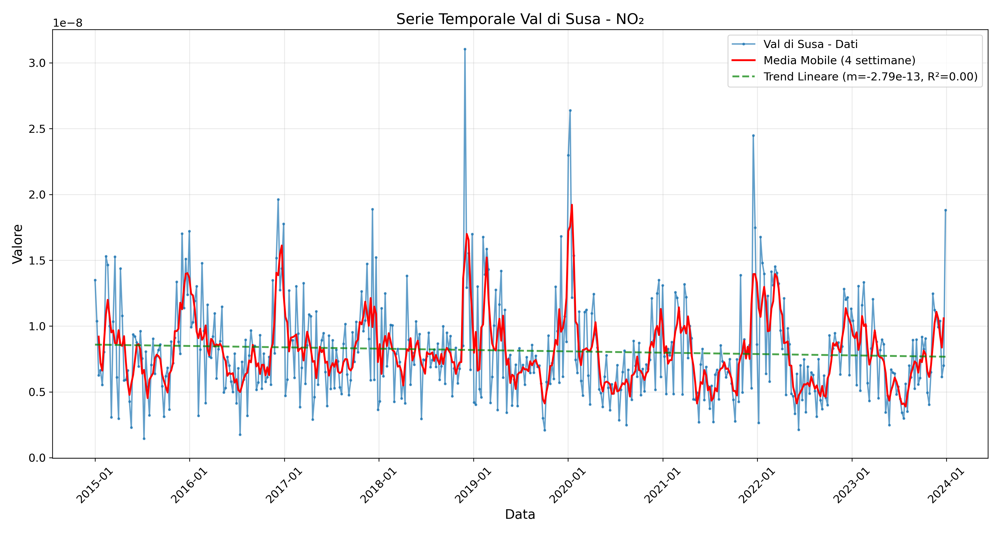

Immagine: ./processed_data/air_quality_analysis/timeseries/Val di Susa_no2_value_timeseries.png


### Val di Susa pm10 value timeseries

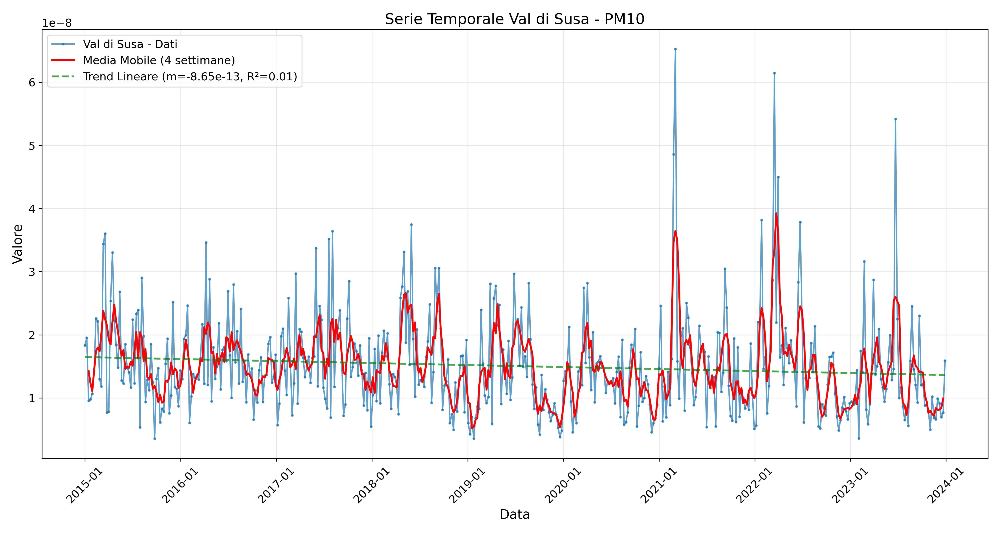

Immagine: ./processed_data/air_quality_analysis/timeseries/Val di Susa_pm10_value_timeseries.png


### pm10 value timeseries

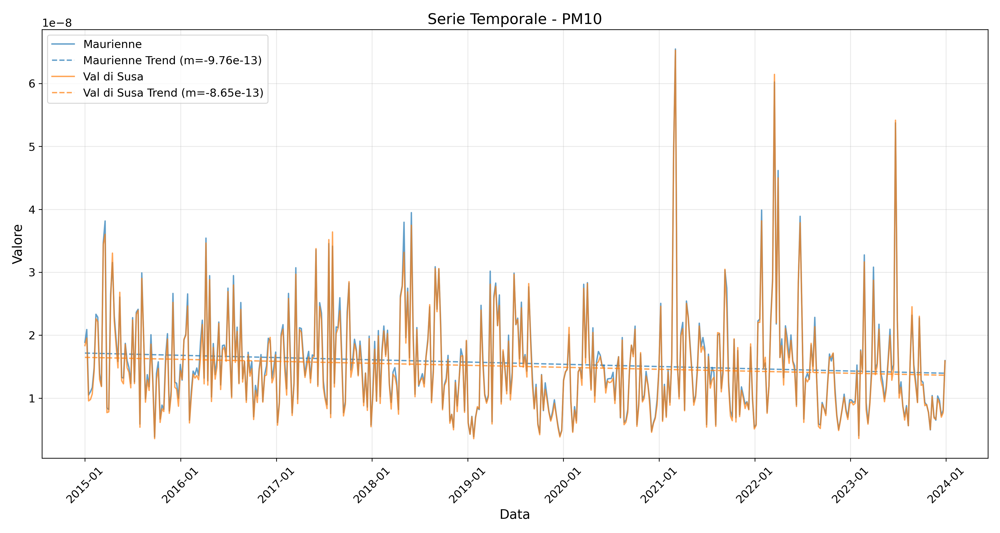

Immagine: ./processed_data/air_quality_analysis/timeseries/pm10_value_timeseries.png


### Val di Susa so2 value timeseries

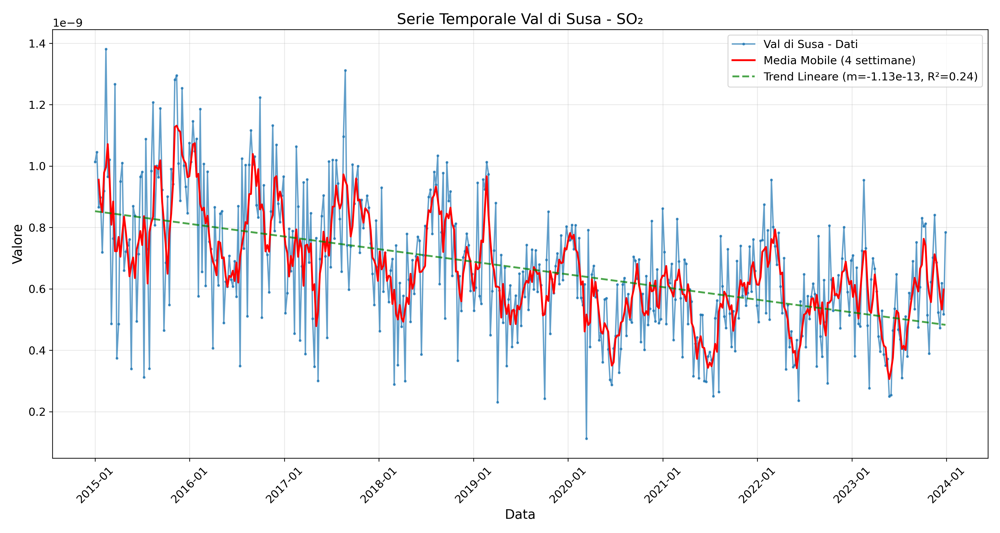

Immagine: ./processed_data/air_quality_analysis/timeseries/Val di Susa_so2_value_timeseries.png

Mostrate 4 di 15 immagini disponibili nella categoria


## Andamento Annuale

### so2 value annual trend

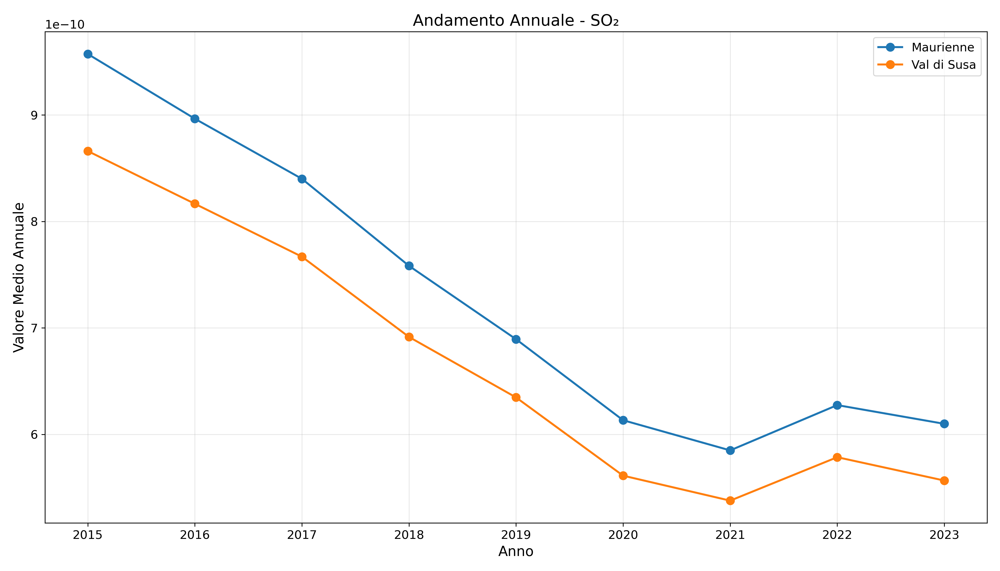

Immagine: ./processed_data/air_quality_analysis/yearly/so2_value_annual_trend.png


### no2 value annual trend

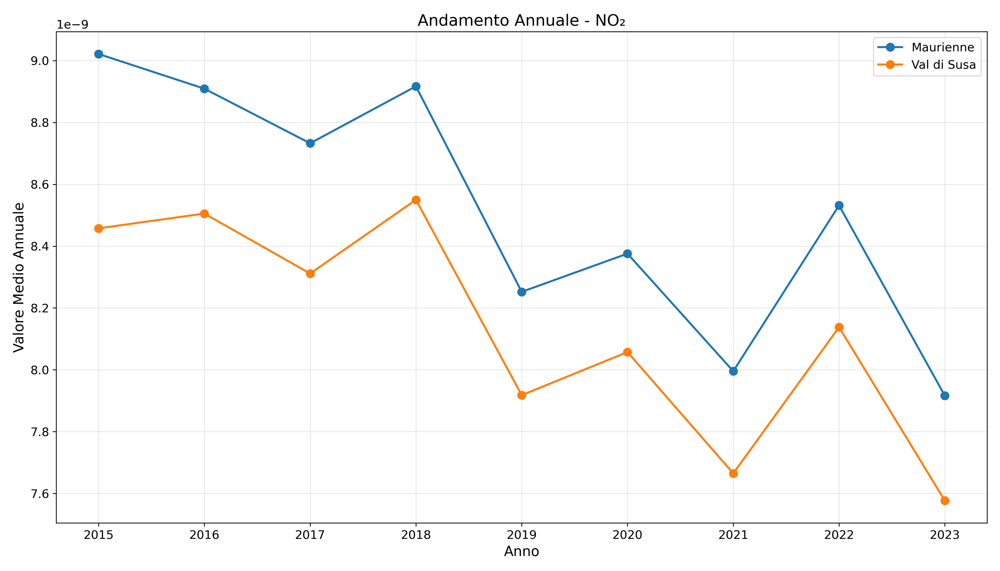

Immagine: ./processed_data/air_quality_analysis/yearly/no2_value_annual_trend.png


### co value annual trend

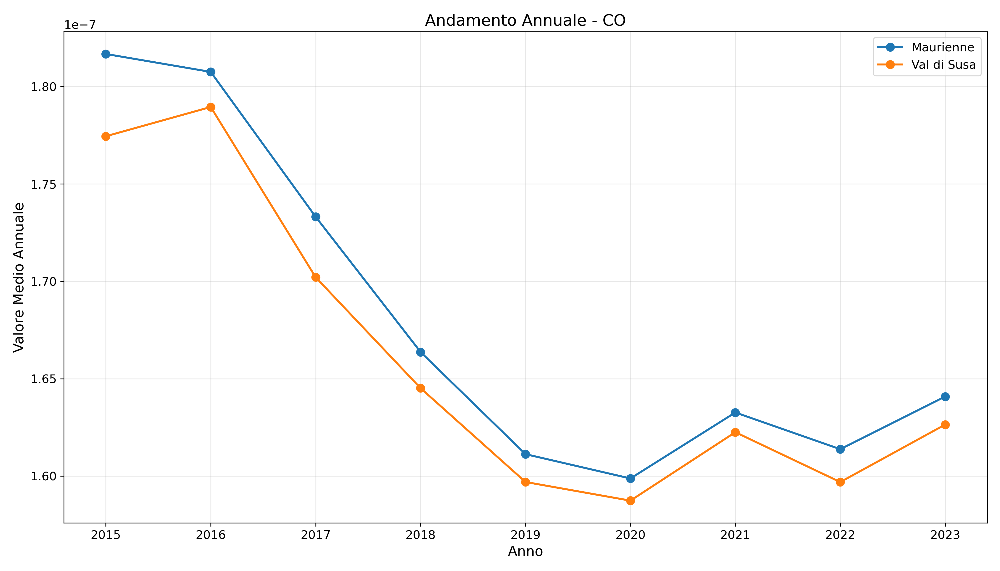

Immagine: ./processed_data/air_quality_analysis/yearly/co_value_annual_trend.png


### pm10 value annual trend

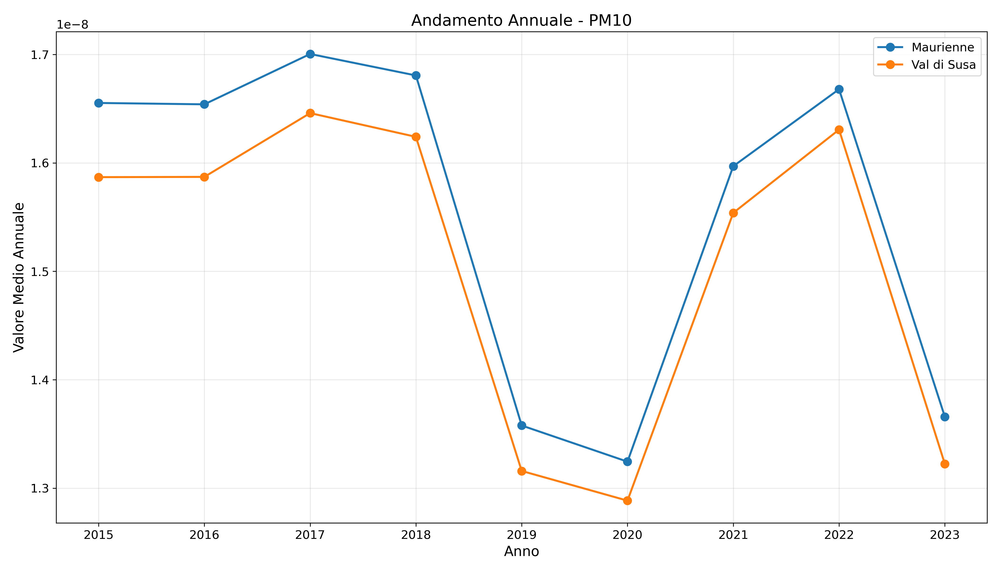

Immagine: ./processed_data/air_quality_analysis/yearly/pm10_value_annual_trend.png

Mostrate 4 di 5 immagini disponibili nella categoria


## Pattern Stagionali

### Val di Susa so2 value monthly evolution

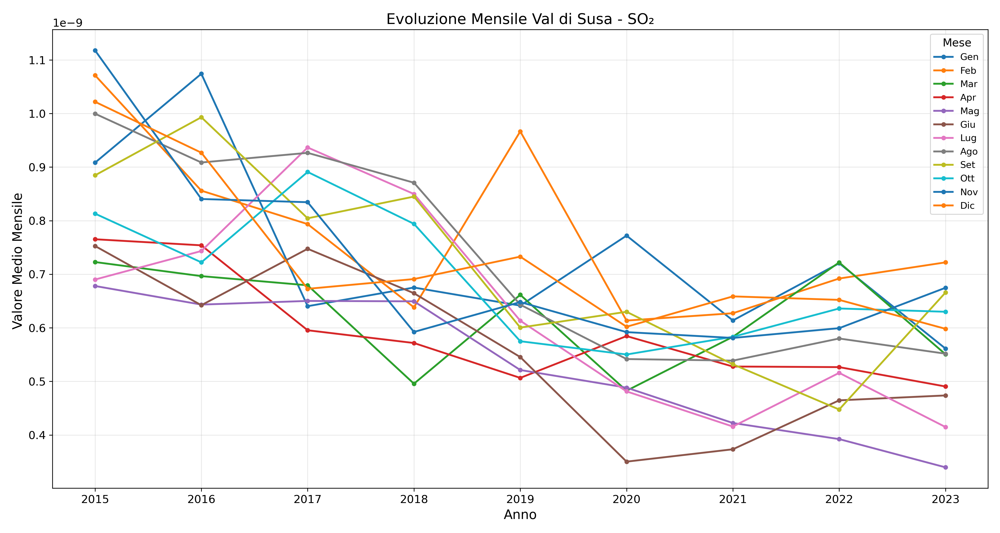

Immagine: ./processed_data/air_quality_analysis/seasonal/Val di Susa_so2_value_monthly_evolution.png


### Maurienne no2 value monthly evolution

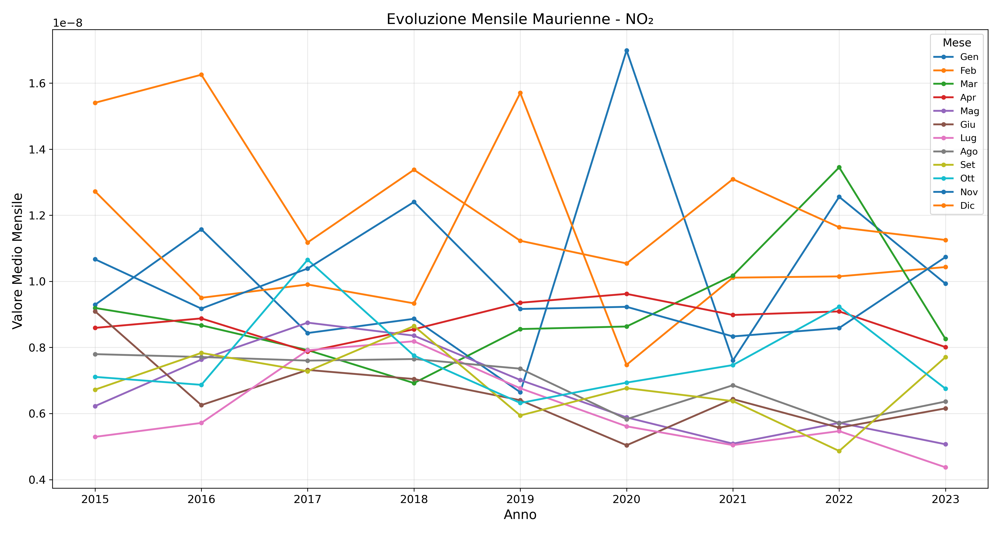

Immagine: ./processed_data/air_quality_analysis/seasonal/Maurienne_no2_value_monthly_evolution.png


### Val di Susa no2 value monthly evolution

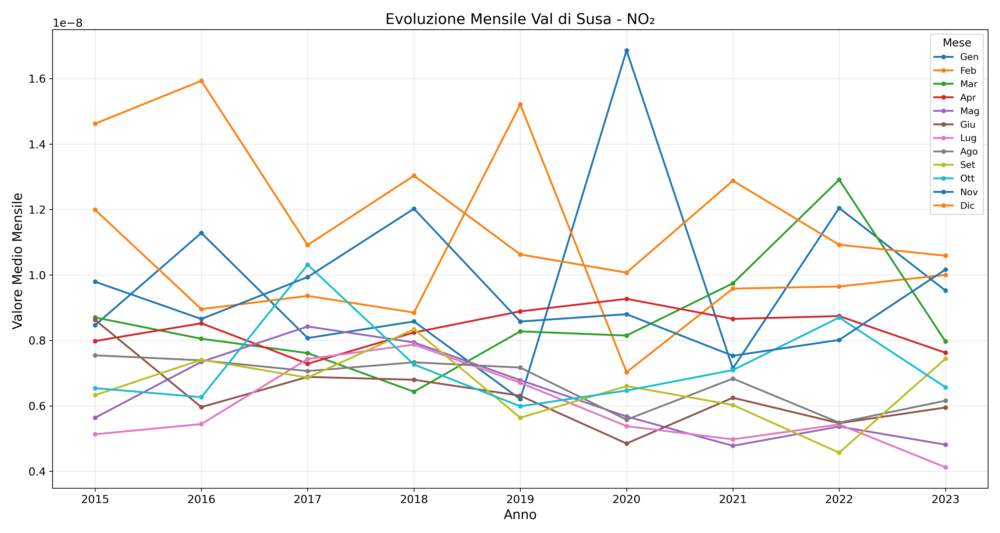

Immagine: ./processed_data/air_quality_analysis/seasonal/Val di Susa_no2_value_monthly_evolution.png


### Val di Susa no2 value heatmap

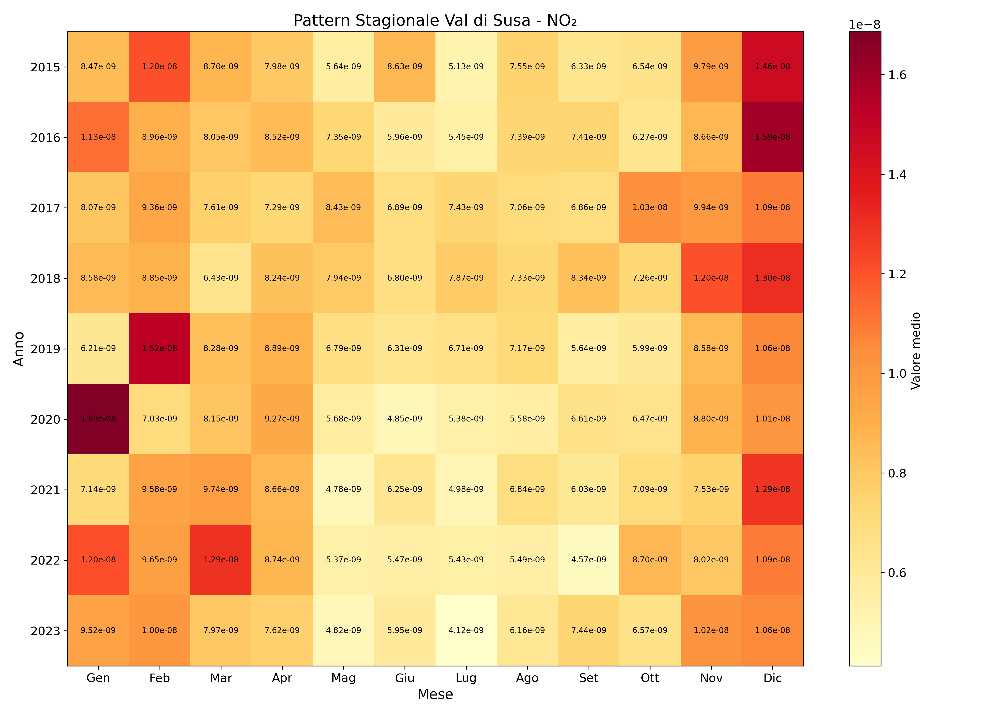

Immagine: ./processed_data/air_quality_analysis/seasonal/Val di Susa_no2_value_heatmap.png

Mostrate 4 di 20 immagini disponibili nella categoria


## Confronto tra Regioni

### pm2.5 value region boxplot

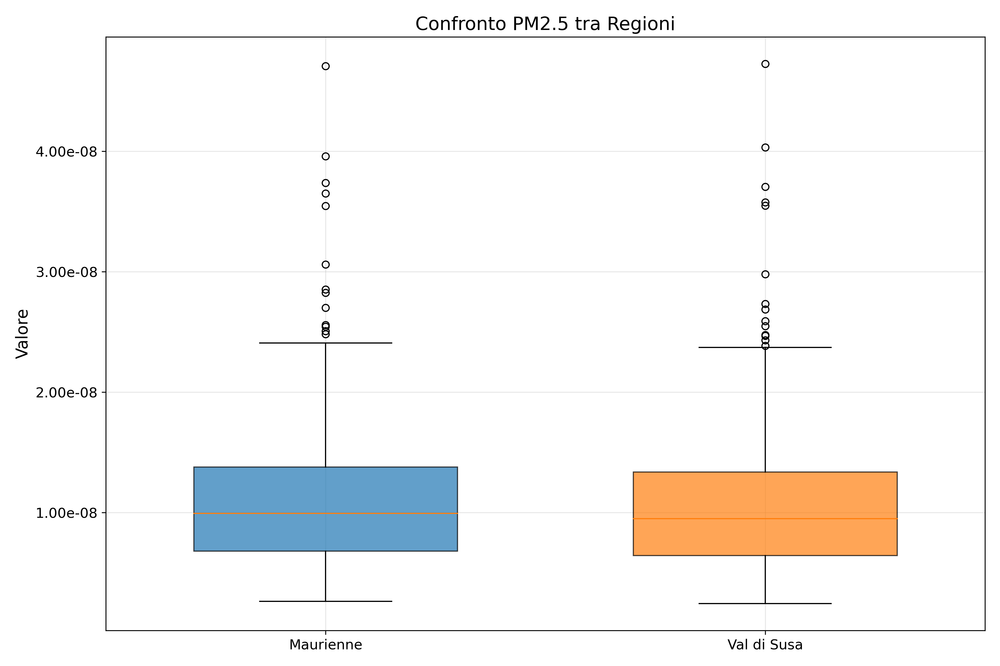

Immagine: ./processed_data/air_quality_analysis/comparison/pm2.5_value_region_boxplot.png


### co value region boxplot

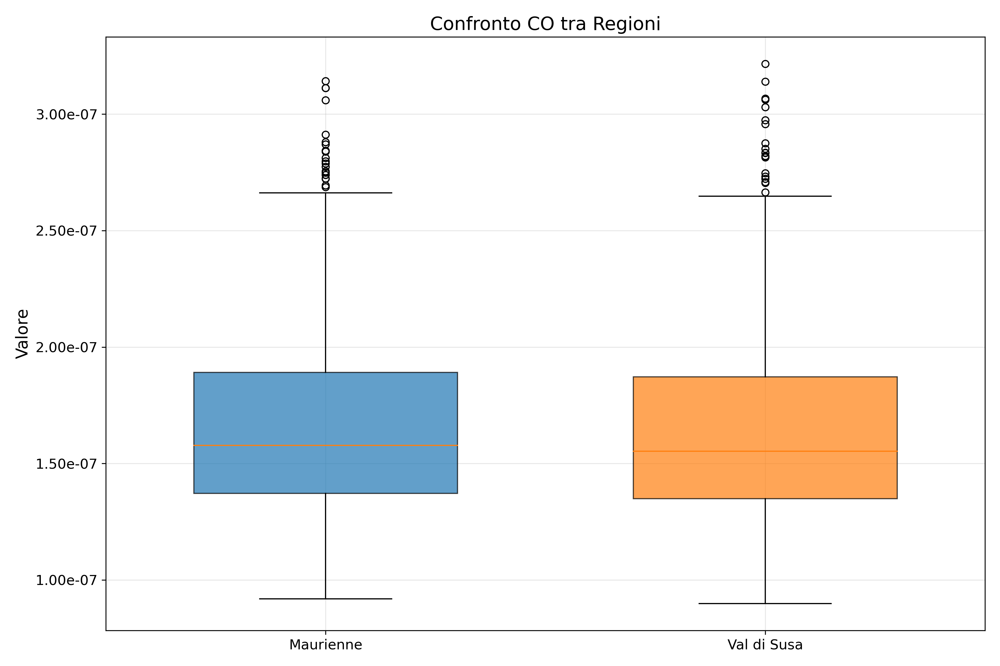

Immagine: ./processed_data/air_quality_analysis/comparison/co_value_region_boxplot.png


### so2 value region histograms

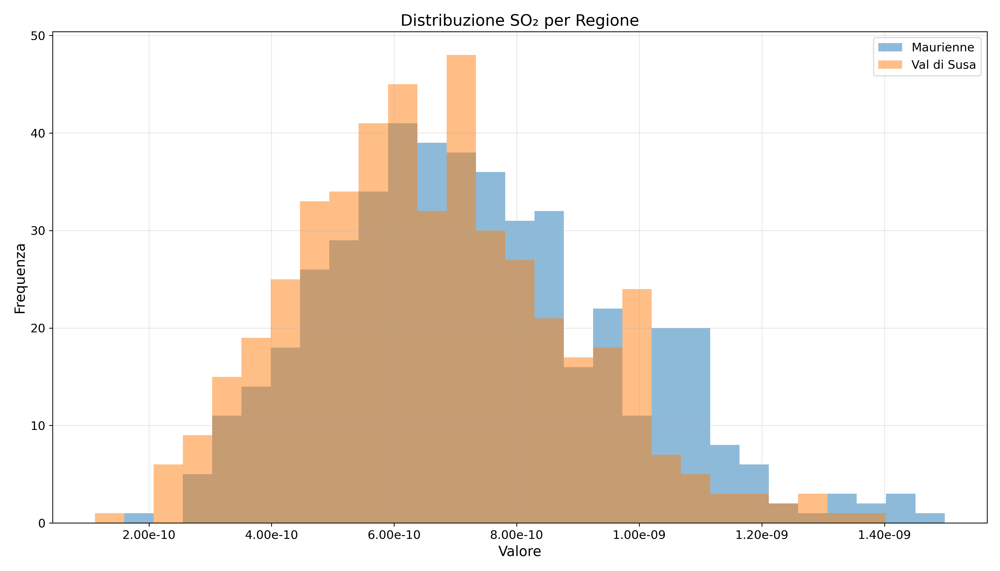

Immagine: ./processed_data/air_quality_analysis/comparison/so2_value_region_histograms.png


### no2 value region boxplot

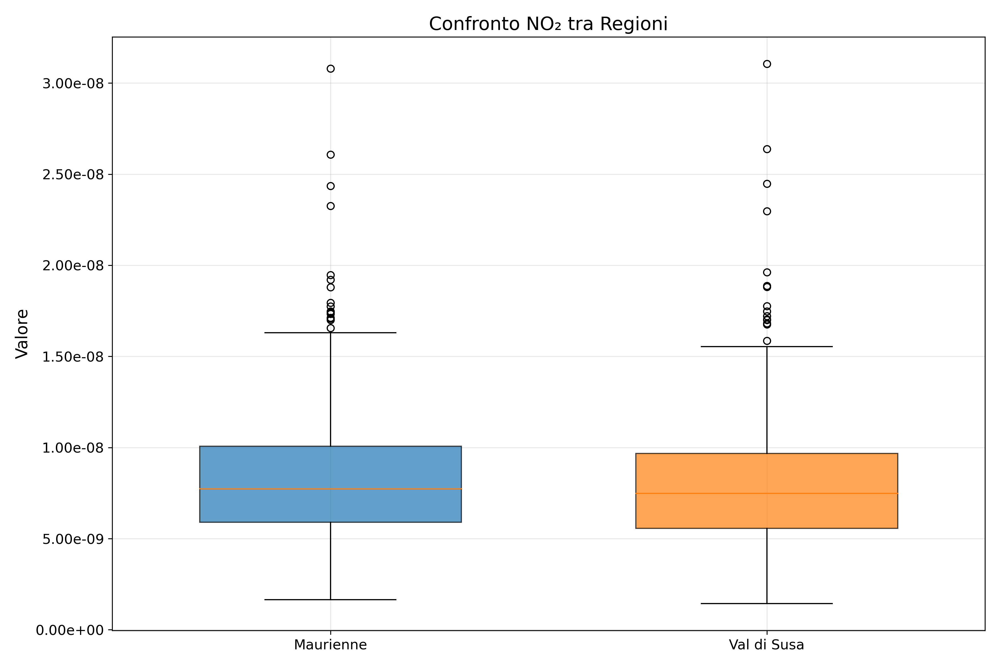

Immagine: ./processed_data/air_quality_analysis/comparison/no2_value_region_boxplot.png

Mostrate 4 di 10 immagini disponibili nella categoria


## Distribuzioni dei Valori

### Maurienne pm10 value distribution

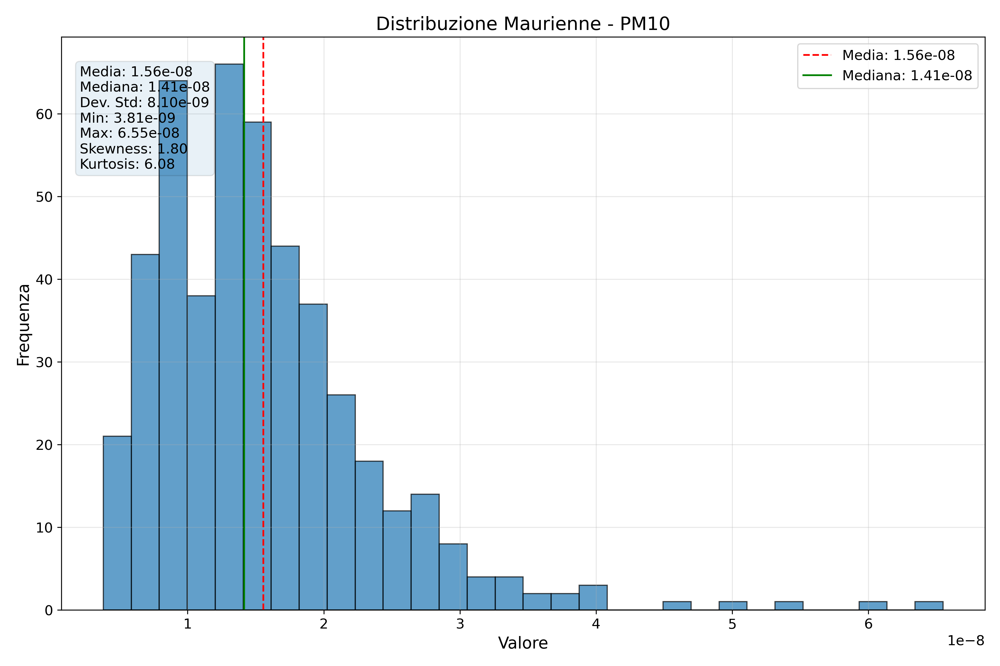

Immagine: ./processed_data/air_quality_analysis/distribution/Maurienne_pm10_value_distribution.png


### Maurienne pm2.5 value distribution

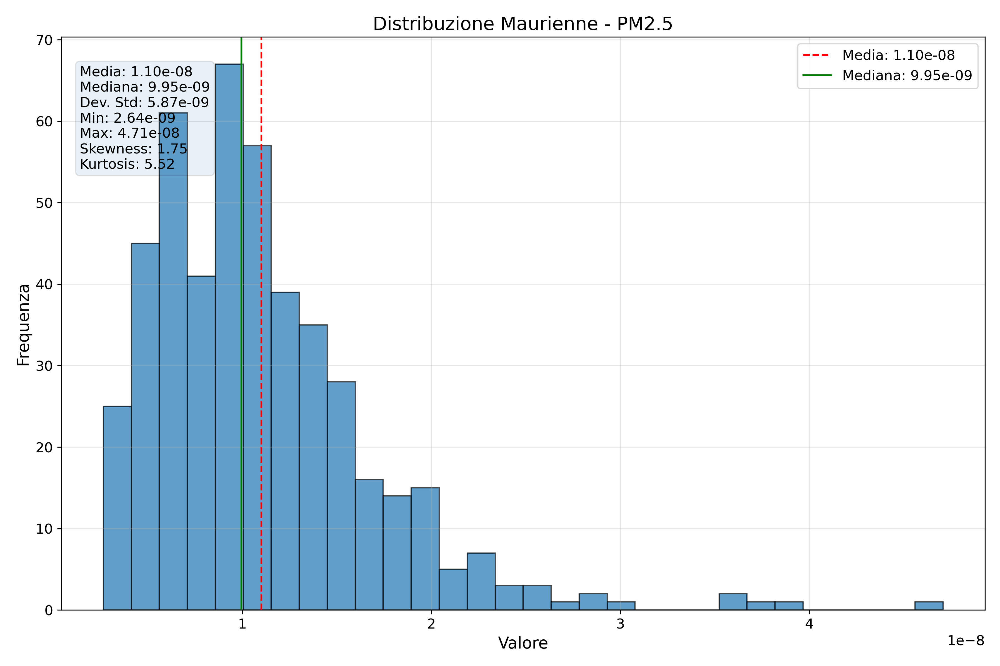

Immagine: ./processed_data/air_quality_analysis/distribution/Maurienne_pm2.5_value_distribution.png


### Maurienne no2 value distribution

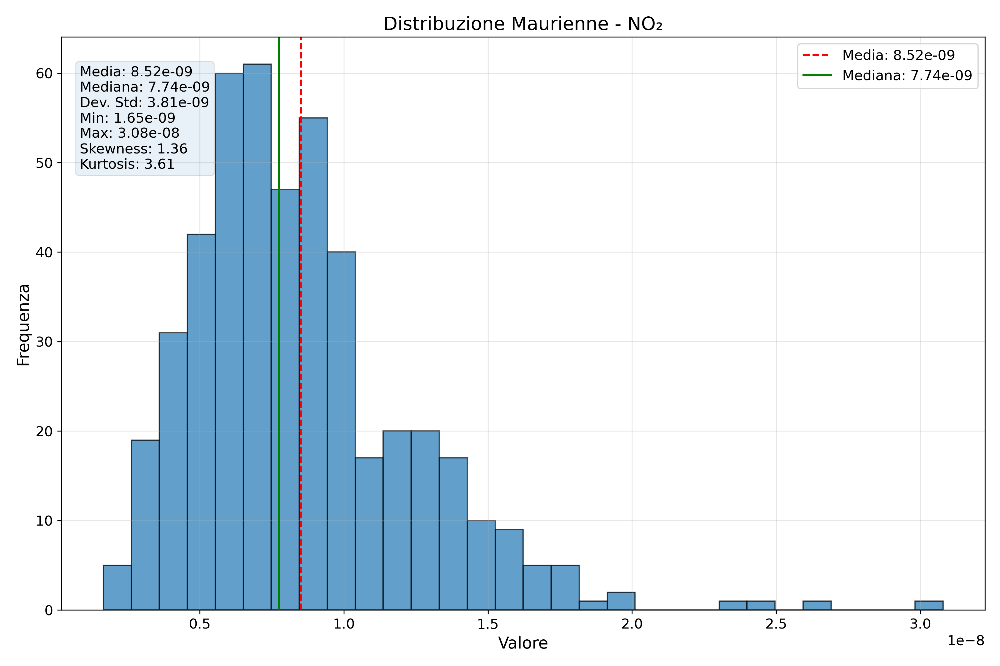

Immagine: ./processed_data/air_quality_analysis/distribution/Maurienne_no2_value_distribution.png


### Val di Susa co value distribution

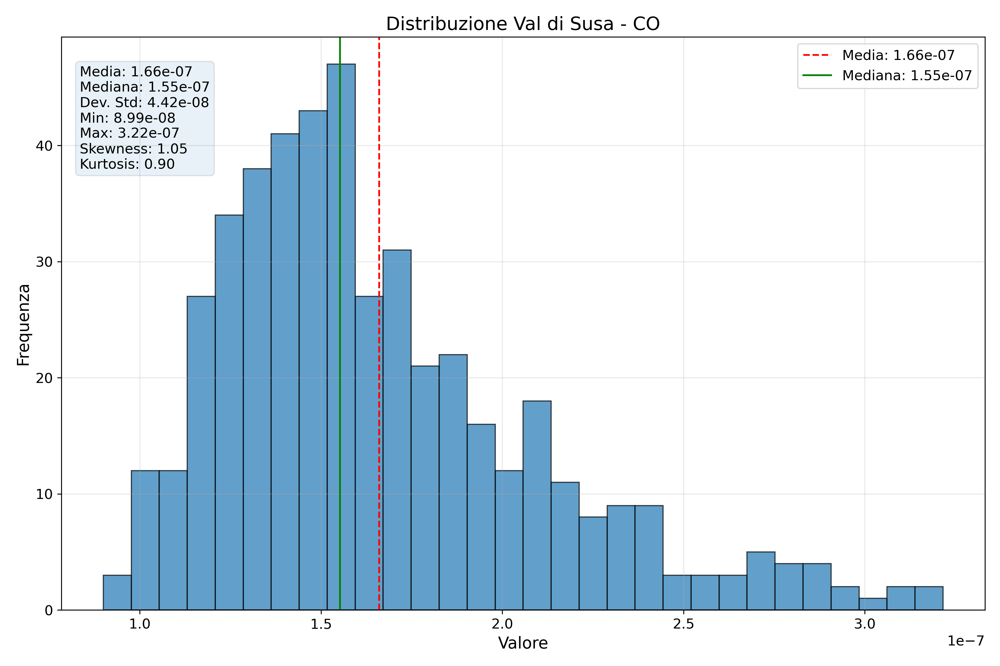

Immagine: ./processed_data/air_quality_analysis/distribution/Val di Susa_co_value_distribution.png

Mostrate 4 di 10 immagini disponibili nella categoria


## Correlazioni tra Inquinanti

### Maurienne correlation matrix

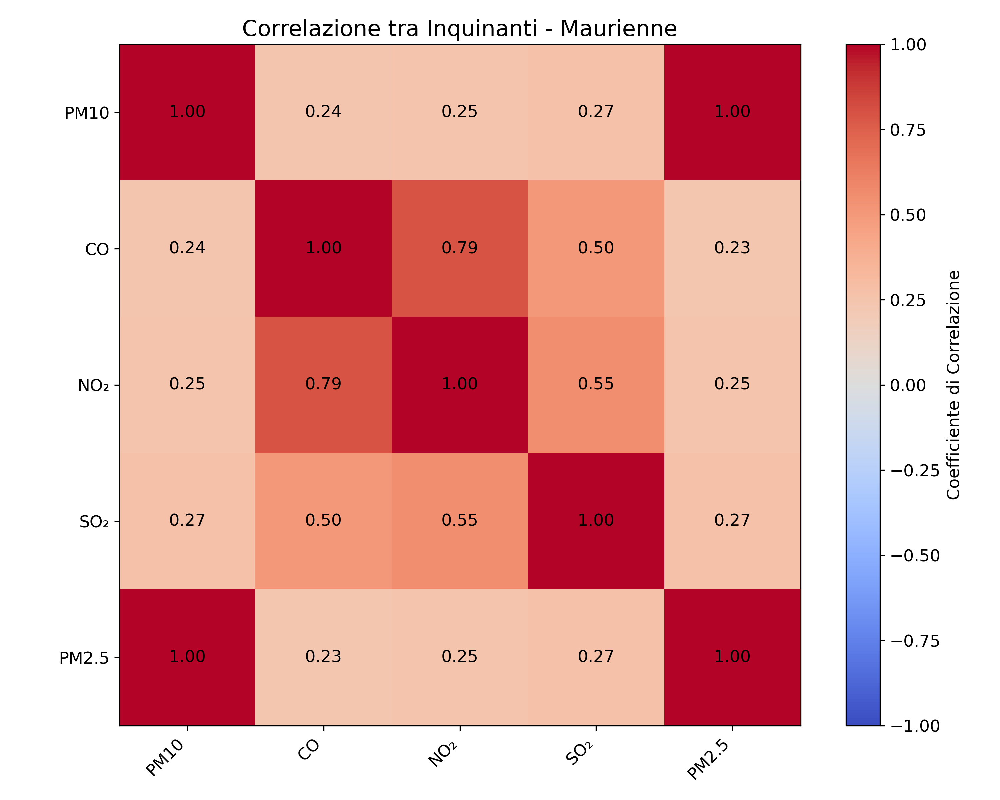

Immagine: ./processed_data/air_quality_analysis/correlation/Maurienne_correlation_matrix.png


### Val di Susa correlation matrix

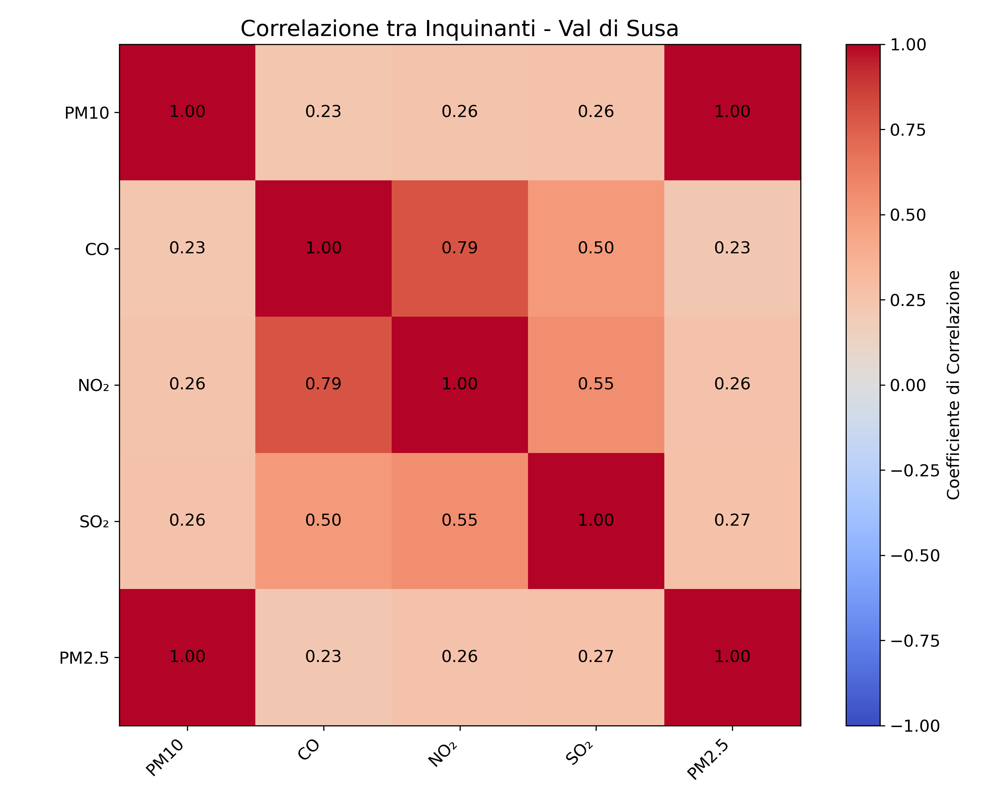

Immagine: ./processed_data/air_quality_analysis/correlation/Val di Susa_correlation_matrix.png

Mostrate 2 di 2 immagini disponibili nella categoria


## Mappe Schematiche

### no2 value schematic map

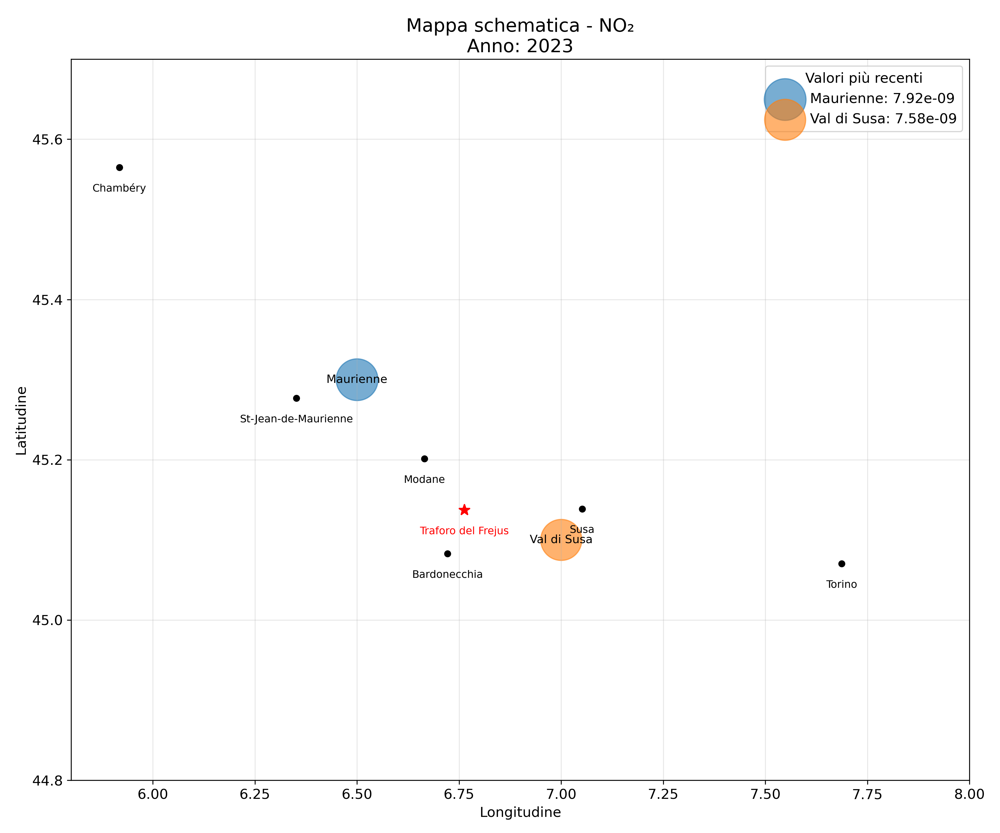

Immagine: ./processed_data/air_quality_analysis/maps/no2_value_schematic_map.png


### pm10 value schematic map

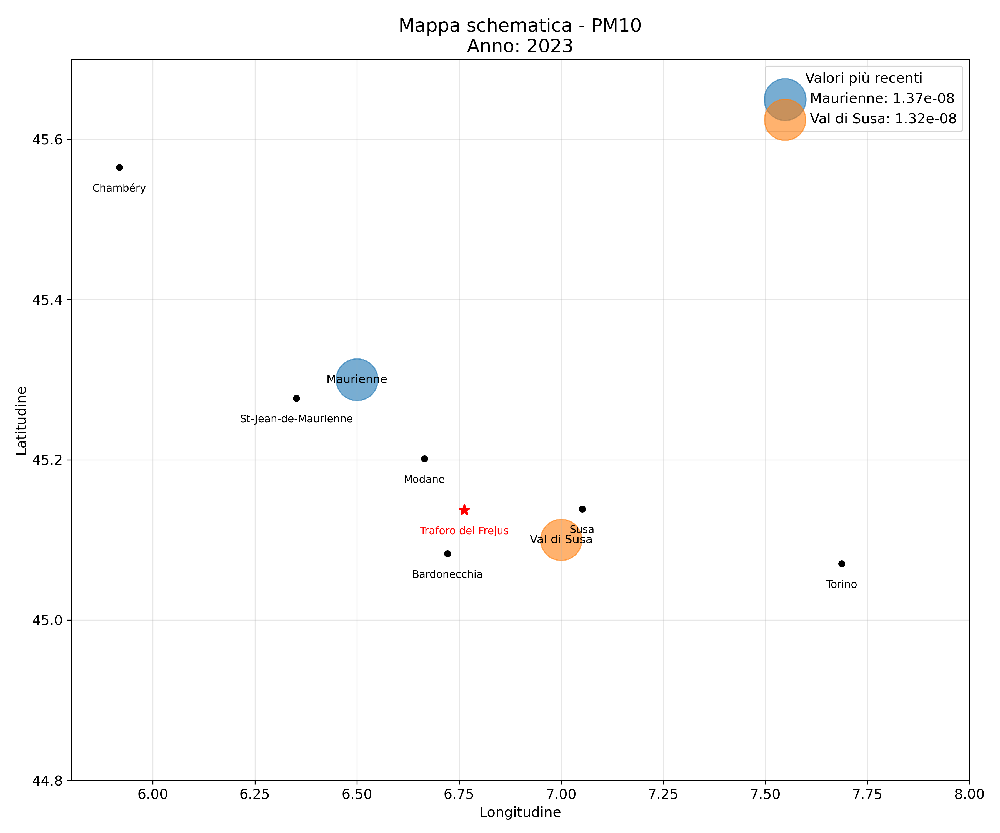

Immagine: ./processed_data/air_quality_analysis/maps/pm10_value_schematic_map.png


### co value schematic map

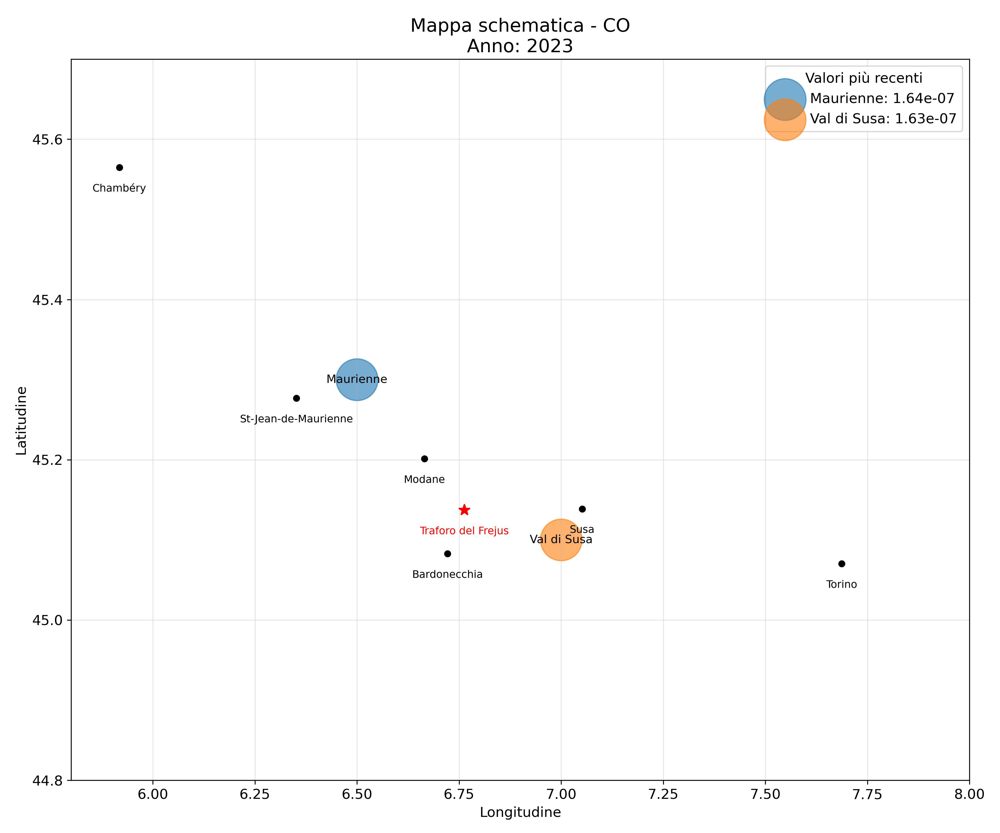

Immagine: ./processed_data/air_quality_analysis/maps/co_value_schematic_map.png


### so2 value schematic map

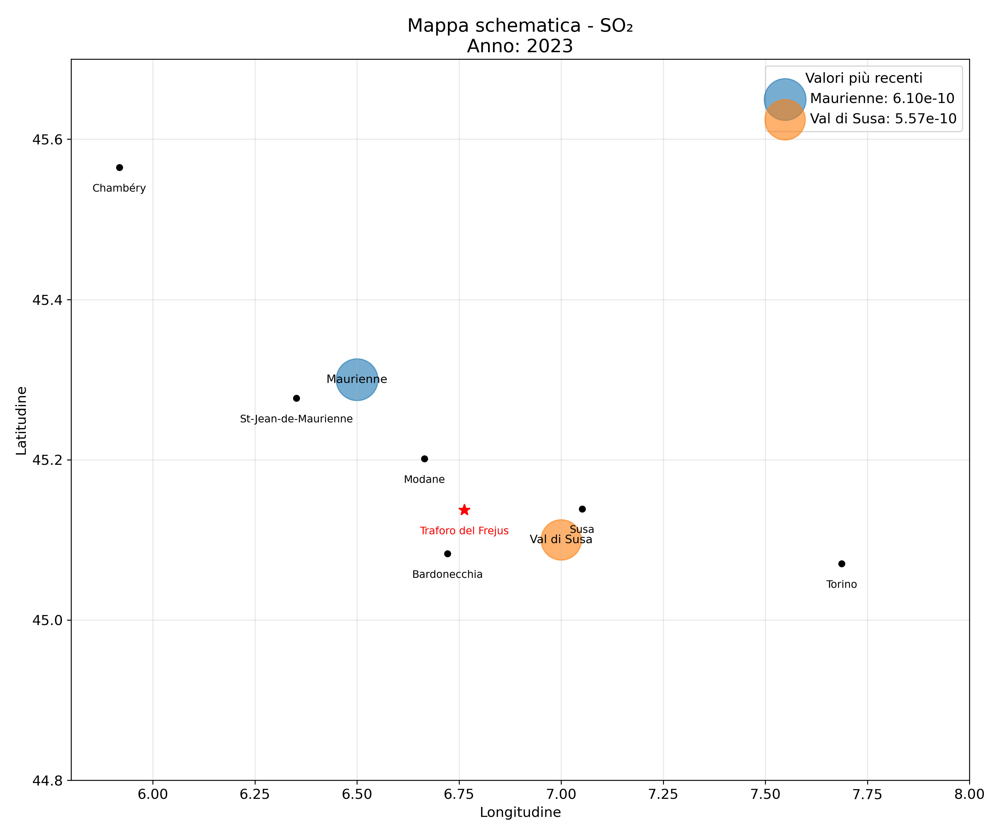

Immagine: ./processed_data/air_quality_analysis/maps/so2_value_schematic_map.png

Mostrate 4 di 5 immagini disponibili nella categoria


## Riepilogo

Totale immagini generate: 67
Tutti i risultati sono stati salvati in: ./processed_data/air_quality_analysis


In [14]:
import os
import glob
import pandas as pd
import matplotlib.pyplot as plt
from IPython.display import display, HTML, Image, Markdown

# Directory di base dove sono stati salvati i risultati
base_dir = "./processed_data/air_quality_analysis"

# Funzione per visualizzare un'immagine con un titolo
def show_image(path, title=None, width=900):
    if os.path.exists(path):
        if title:
            display(Markdown(f"### {title}"))
        display(Image(filename=path, width=width))
        print(f"Immagine: {path}")
    else:
        print(f"Immagine non trovata: {path}")

# Funzione per visualizzare le migliori immagini di una categoria
def show_category(category_dir, title, max_images=4):
    if not os.path.exists(category_dir):
        print(f"Directory non trovata: {category_dir}")
        return
        
    # Trova tutte le immagini PNG nella directory
    image_files = glob.glob(f"{category_dir}/*.png")
    
    if not image_files:
        print(f"Nessuna immagine trovata in: {category_dir}")
        return
    
    display(Markdown(f"## {title}"))
    
    # Seleziona le immagini da mostrare (limita al numero specificato)
    selected_images = image_files[:max_images]
    
    for img_path in selected_images:
        img_name = os.path.basename(img_path)
        img_title = img_name.replace("_", " ").replace(".png", "")
        show_image(img_path, img_title)
    
    print(f"\nMostrate {len(selected_images)} di {len(image_files)} immagini disponibili nella categoria")

# 1. Visualizzazione del report HTML se esiste
html_report_path = f"{base_dir}/air_quality_report.html"
if os.path.exists(html_report_path):
    with open(html_report_path, 'r') as f:
        html_content = f.read()
    display(Markdown("# Rapporto dell'Analisi della Qualità dell'Aria"))
    display(HTML(html_content))
else:
    display(Markdown("# Visualizzazione dei Risultati dell'Analisi della Qualità dell'Aria"))
    print("Report HTML non trovato. Visualizzazione delle singole immagini...")

# 2. Visualizzazione delle statistiche descrittive
stats_path = f"{base_dir}/summary_statistics.csv"
if os.path.exists(stats_path):
    display(Markdown("## Statistiche Descrittive"))
    stats_df = pd.read_csv(stats_path)
    display(stats_df)
else:
    print("File di statistiche descrittive non trovato.")

# 3. Visualizzazione delle tendenze
trends_path = f"{base_dir}/trends_summary.csv"
if os.path.exists(trends_path):
    display(Markdown("## Tendenze Principali"))
    trends_df = pd.read_csv(trends_path)
    display(trends_df)
else:
    print("File di tendenze non trovato.")

# 4. Visualizzazione delle categorie principali di grafici
categories = [
    {"dir": f"{base_dir}/timeseries", "title": "Serie Temporali"},
    {"dir": f"{base_dir}/yearly", "title": "Andamento Annuale"},
    {"dir": f"{base_dir}/seasonal", "title": "Pattern Stagionali"},
    {"dir": f"{base_dir}/comparison", "title": "Confronto tra Regioni"},
    {"dir": f"{base_dir}/distribution", "title": "Distribuzioni dei Valori"},
    {"dir": f"{base_dir}/correlation", "title": "Correlazioni tra Inquinanti"},
    {"dir": f"{base_dir}/maps", "title": "Mappe Schematiche"}
]

# Mostra immagini per ogni categoria
for category in categories:
    show_category(category["dir"], category["title"])

# Conteggio finale delle immagini generate
total_images = sum([len(glob.glob(f"{cat['dir']}/*.png")) for cat in categories])
display(Markdown(f"## Riepilogo"))
print(f"Totale immagini generate: {total_images}")
print(f"Tutti i risultati sono stati salvati in: {base_dir}")

Trovata directory delle previsioni: ./processed_data/annual_forecast_2050
Caricato file delle previsioni: ./processed_data/annual_forecast_2050/previsioni_annuali_2023_2050.csv
Righe nel dataset: 900


## Panoramica dei dati di previsione

,Region,Variable,Scenario,Year,Value
0,Maurienne,pm10_value,Historical,2015.0,1.655256e-08
1,Maurienne,co_value,Historical,2015.0,1.816740e-07
2,Maurienne,no2_value,Historical,2015.0,9.021534e-09
3,Maurienne,so2_value,Historical,2015.0,9.572617e-10
4,Maurienne,pm2.5_value,Historical,2015.0,1.170066e-08
5,Maurienne,pm10_value,Historical,2016.0,1.654008e-08
6,Maurienne,co_value,Historical,2016.0,1.807536e-07
7,Maurienne,no2_value,Historical,2016.0,8.909310e-09
8,Maurienne,so2_value,Historical,2016.0,8.964595e-10
9,Maurienne,pm2.5_value,Historical,2016.0,1.164271e-08



Regioni: Maurienne, Val di Susa
Inquinanti: pm10_value, co_value, no2_value, so2_value, pm2.5_value
Scenari: Historical, baseline, improvement, deterioration
Periodo di previsione: 2015.0 - 2050.0


## Previsioni a lungo termine fino al 2050

Dati storici caricati: 940 record


### Previsioni per Maurienne

TypeError: 'numpy.float64' object cannot be interpreted as an integer

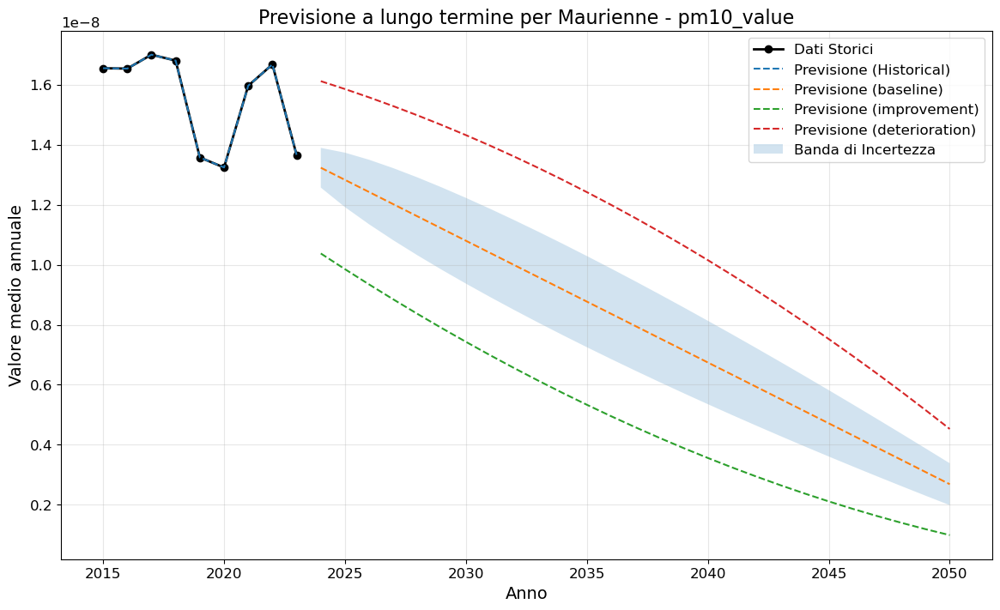

In [15]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import glob
from IPython.display import display, Markdown, HTML
from matplotlib.ticker import FuncFormatter

# Directory dove sono stati salvati i risultati delle previsioni
forecast_dir = "./processed_data/annual_forecast_2050"

# Verifica se la directory esiste
if not os.path.exists(forecast_dir):
    print(f"La directory {forecast_dir} non esiste. Assicurati di aver eseguito lo script di previsione a lungo termine.")
else:
    print(f"Trovata directory delle previsioni: {forecast_dir}")

# Funzione per caricare e visualizzare le previsioni per ciascun inquinante
def visualize_forecasts():
    # Carica il file CSV principale delle previsioni se esiste
    csv_files = glob.glob(f"{forecast_dir}/previsioni_annuali_*.csv")
    if not csv_files:
        print("File di previsioni non trovato. Verifica di aver eseguito lo script di previsione annuale fino al 2050.")
        return

    # Carica il dataset principale delle previsioni
    forecast_df = pd.read_csv(csv_files[0])
    print(f"Caricato file delle previsioni: {csv_files[0]}")
    print(f"Righe nel dataset: {len(forecast_df)}")
    
    # Mostra le prime righe del dataset
    display(Markdown("## Panoramica dei dati di previsione"))
    display(forecast_df.head(10))
    
    # Estrai informazioni uniche
    regions = forecast_df['Region'].unique()
    variables = forecast_df['Variable'].unique()
    scenarios = forecast_df['Scenario'].unique()
    years = sorted(forecast_df['Year'].unique())
    
    print(f"\nRegioni: {', '.join(regions)}")
    print(f"Inquinanti: {', '.join(variables)}")
    print(f"Scenari: {', '.join(scenarios)}")
    print(f"Periodo di previsione: {min(years)} - {max(years)}")
    
    # Visualizza previsioni per ogni regione e inquinante
    display(Markdown("## Previsioni a lungo termine fino al 2050"))
    
    # Carica i dati storici per confronto, se disponibili
    try:
        historical_df = pd.read_csv("./processed_data/air_quality_data_complete.csv")
        historical_df["date"] = pd.to_datetime(historical_df["date"])
        historical_df['year'] = historical_df["date"].dt.year
        print(f"Dati storici caricati: {len(historical_df)} record")
        has_historical = True
    except Exception as e:
        print(f"Dati storici non disponibili: {e}")
        has_historical = False
    
    # Crea grafici per ogni combinazione regione-inquinante
    for region in regions:
        display(Markdown(f"### Previsioni per {region}"))
        
        for var in variables:
            # Filtra dati per questa combinazione
            var_data = forecast_df[(forecast_df['Region'] == region) & 
                                   (forecast_df['Variable'] == var)]
            
            if len(var_data) == 0:
                print(f"Nessun dato di previsione disponibile per {region} - {var}")
                continue
            
            # Prepara il grafico
            plt.figure(figsize=(14, 8))
            
            # Aggiungi dati storici per confronto
            if has_historical:
                hist_data = historical_df[historical_df['region'] == region]
                if len(hist_data) > 0:
                    # Converti il nome della variabile dal formato display a quello nella colonna
                    var_col = next((col for col in historical_df.columns if col.startswith(var.lower().replace("₂", "2"))), None)
                    
                    if var_col in hist_data.columns:
                        # Calcola medie annuali
                        annual_hist = hist_data.groupby('year')[var_col].mean().reset_index()
                        plt.plot(annual_hist['year'], annual_hist[var_col], 'o-', 
                                color='black', linewidth=2, label='Dati Storici')
            
            # Plotta previsioni per ogni scenario
            for scenario in scenarios:
                scenario_data = var_data[var_data['Scenario'] == scenario]
                if len(scenario_data) > 0:
                    plt.plot(scenario_data['Year'], scenario_data['Value'], 
                            label=f'Previsione ({scenario})', linestyle='--')
            
            # Aggiungi area ombreggiata per indicare incertezza
            for scenario in scenarios:
                if scenario == 'baseline':  # Solo per lo scenario baseline
                    scenario_data = var_data[var_data['Scenario'] == scenario]
                    if len(scenario_data) > 0:
                        # Calcola bande di incertezza
                        years_out = scenario_data['Year'] - min(scenario_data['Year'])
                        uncertainty = 0.05 * np.sqrt(years_out+1)  # Crescita dell'incertezza
                        upper = scenario_data['Value'] * (1 + uncertainty)
                        lower = scenario_data['Value'] * (1 - uncertainty)
                        
                        plt.fill_between(scenario_data['Year'], lower, upper, 
                                        alpha=0.2, label='Banda di Incertezza')
            
            # Formattazione del grafico
            plt.title(f'Previsione a lungo termine per {region} - {var}', fontsize=16)
            plt.xlabel('Anno', fontsize=14)
            plt.ylabel('Valore medio annuale', fontsize=14)
            plt.grid(True, alpha=0.3)
            plt.legend(loc='best')
            
            # Assicura che l'asse x mostri tutti gli anni salienti
            key_years = [y for y in range(min(years), max(years)+1, 5)]
            plt.xticks(key_years)
            
            # Se i valori sono molto piccoli, usa notazione scientifica
            if np.max(var_data['Value']) < 0.001:
                plt.gca().yaxis.set_major_formatter(FuncFormatter(lambda x, _: f'{x:.2e}'))
            
            plt.tight_layout()
            
            # Trova il file immagine corrispondente se esiste
            img_files = glob.glob(f"{forecast_dir}/{region}_{var.lower().replace('₂', '2').replace('', '')}_annual_*.png")
            
            # Mostra l'immagine salvata se esiste, altrimenti mostra il grafico generato
            if img_files:
                plt.close()  # Chiudi il grafico appena creato
                from IPython.display import Image
                display(Image(img_files[0], width=900))
                print(f"Visualizzata immagine salvata: {img_files[0]}")
            else:
                display(plt)
                plt.close()
    
    # Carica e visualizza tabella riassuntiva per anni chiave, se disponibile
    summary_file = f"{forecast_dir}/tabella_riassuntiva_anni_chiave.csv"
    if os.path.exists(summary_file):
        display(Markdown("## Tabella riassuntiva per anni chiave"))
        summary_df = pd.read_csv(summary_file)
        
        # Pivot della tabella per una visualizzazione più chiara
        pivot_df = summary_df.pivot_table(
            index=['Region', 'Variable'], 
            columns='Year', 
            values='Value'
        ).reset_index()
        
        # Aggiungi formattazione
        def format_scientific(x):
            if pd.isna(x):
                return ''
            return f'{x:.2e}'
        
        styled_df = pivot_df.style.format({col: format_scientific for col in pivot_df.columns if isinstance(col, int)})
        display(styled_df)
    
    # Aggiungi nota finale
    display(Markdown("""
    ## Note sulle previsioni
    
    - Le previsioni mostrate rappresentano diversi scenari possibili fino al 2050.
    - Lo scenario "baseline" rappresenta una continuazione dei trend attuali.
    - Lo scenario "improvement" prevede un miglioramento progressivo grazie a politiche ambientali.
    - Lo scenario "deterioration" prevede un peggioramento dovuto a fattori negativi.
    - L'incertezza aumenta con la distanza temporale dalla fine dei dati storici.
    """))

# Esegui la funzione di visualizzazione
visualize_forecasts()

Trovata directory delle previsioni: ./processed_data/annual_forecast_2050
Caricato file delle previsioni: ./processed_data/annual_forecast_2050/previsioni_annuali_2023_2050.csv
Righe nel dataset: 900


## Panoramica dei dati di previsione

,Region,Variable,Scenario,Year,Value
0,Maurienne,pm10_value,Historical,2015,1.655256e-08
1,Maurienne,co_value,Historical,2015,1.816740e-07
2,Maurienne,no2_value,Historical,2015,9.021534e-09
3,Maurienne,so2_value,Historical,2015,9.572617e-10
4,Maurienne,pm2.5_value,Historical,2015,1.170066e-08
5,Maurienne,pm10_value,Historical,2016,1.654008e-08
6,Maurienne,co_value,Historical,2016,1.807536e-07
7,Maurienne,no2_value,Historical,2016,8.909310e-09
8,Maurienne,so2_value,Historical,2016,8.964595e-10
9,Maurienne,pm2.5_value,Historical,2016,1.164271e-08



Regioni: Maurienne, Val di Susa
Inquinanti: pm10_value, co_value, no2_value, so2_value, pm2.5_value
Scenari: Historical, baseline, improvement, deterioration
Periodo di previsione: 2015 - 2050


## Previsioni a lungo termine fino al 2050

Dati storici caricati: 940 record


### Previsioni per Maurienne

#### pm10_value

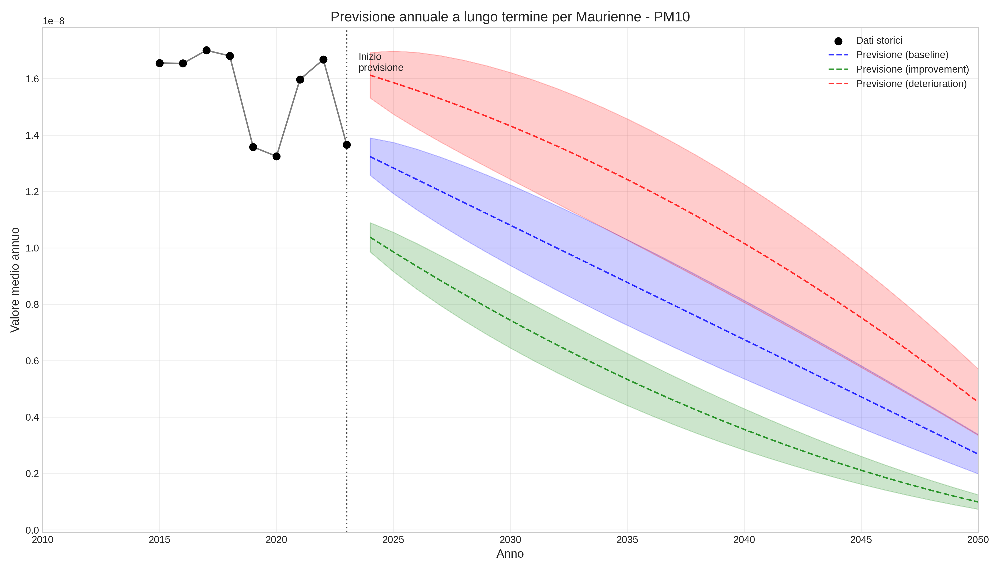

Visualizzata immagine salvata: ./processed_data/annual_forecast_2050/Maurienne_pm10_value_annual_2050.png


#### co_value

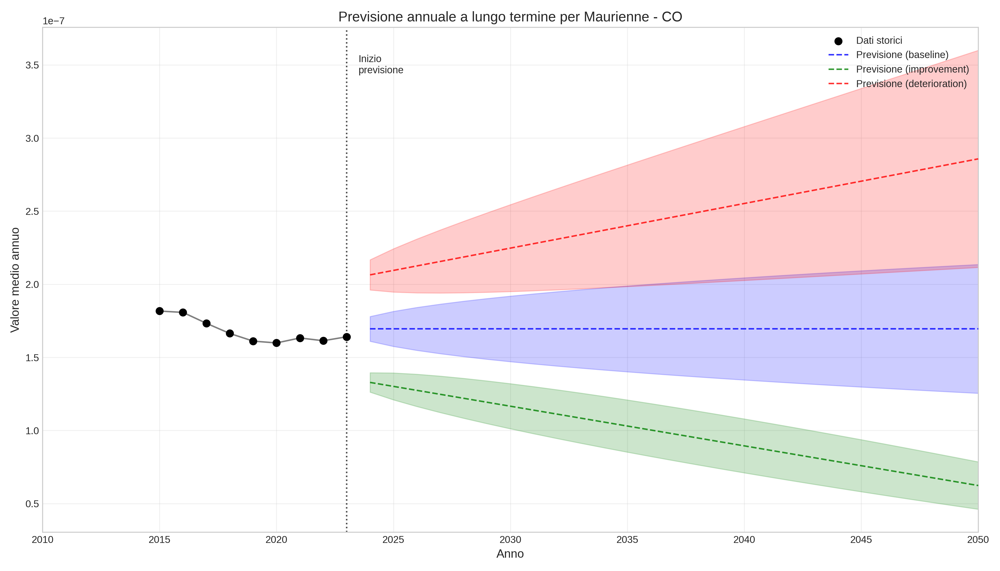

Visualizzata immagine salvata: ./processed_data/annual_forecast_2050/Maurienne_co_value_annual_2050.png


#### no2_value

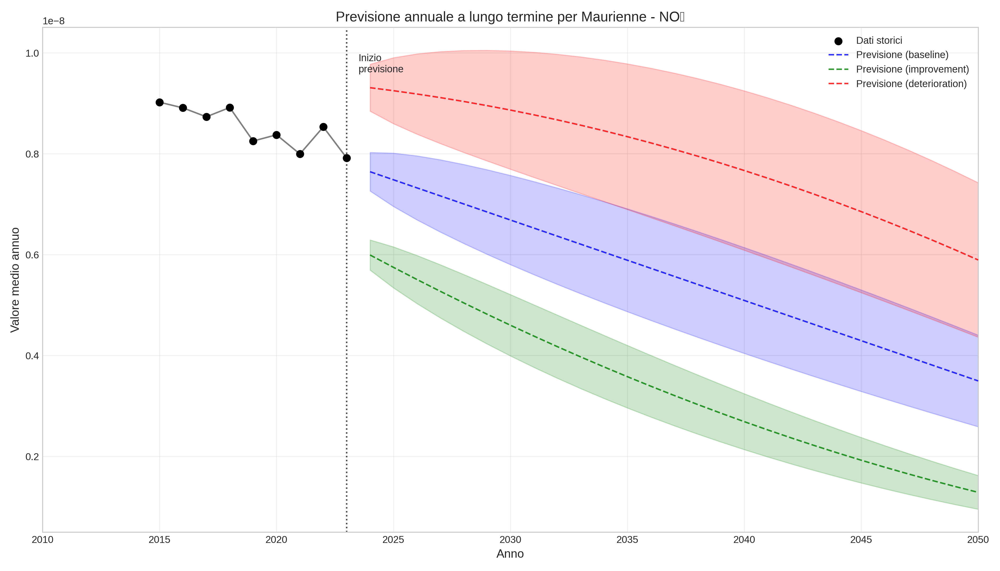

Visualizzata immagine salvata: ./processed_data/annual_forecast_2050/Maurienne_no2_value_annual_2050.png


#### so2_value

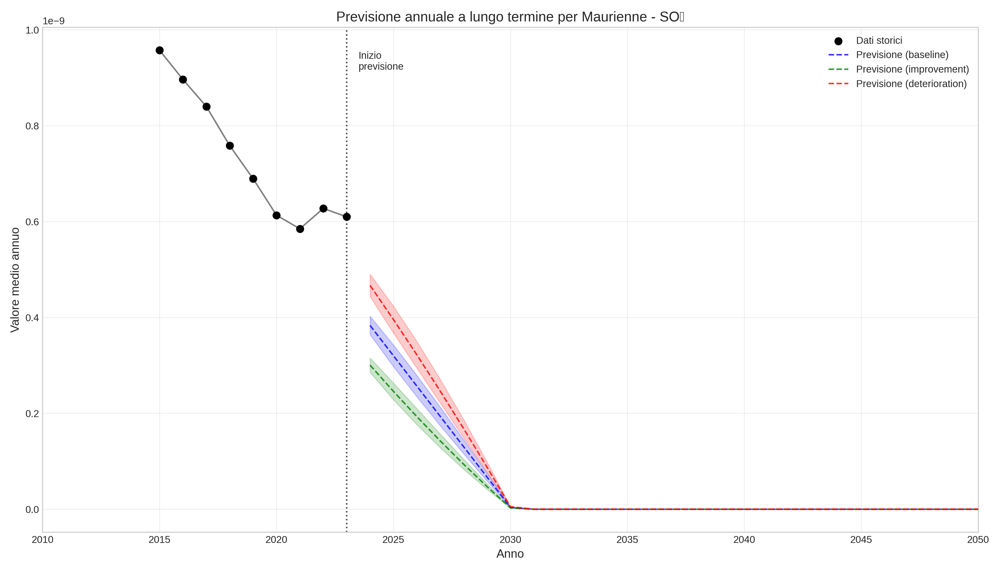

Visualizzata immagine salvata: ./processed_data/annual_forecast_2050/Maurienne_so2_value_annual_2050.png


#### pm2.5_value

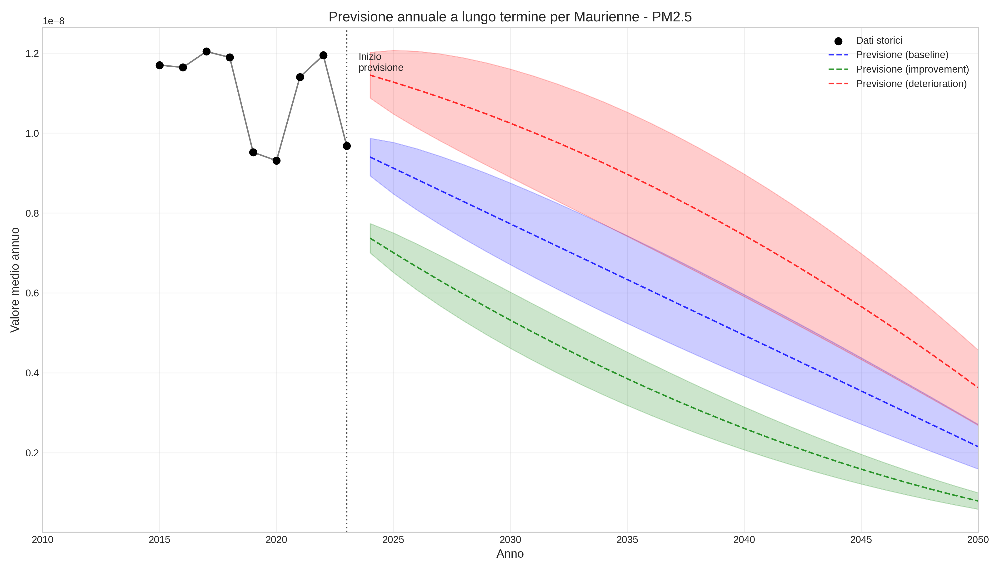

Visualizzata immagine salvata: ./processed_data/annual_forecast_2050/Maurienne_pm2.5_value_annual_2050.png


### Previsioni per Val di Susa

#### pm10_value

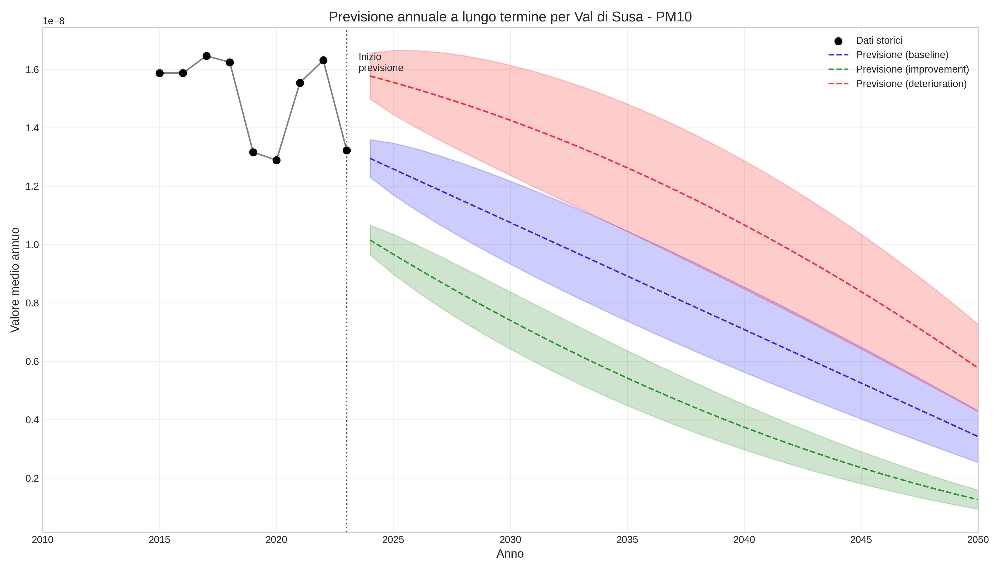

Visualizzata immagine salvata: ./processed_data/annual_forecast_2050/Val di Susa_pm10_value_annual_2050.png


#### co_value

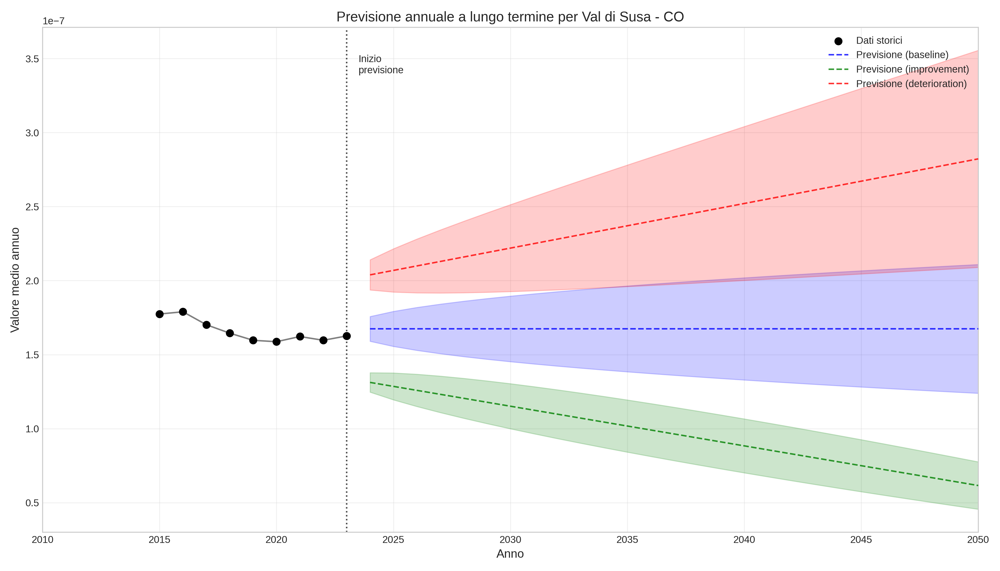

Visualizzata immagine salvata: ./processed_data/annual_forecast_2050/Val di Susa_co_value_annual_2050.png


#### no2_value

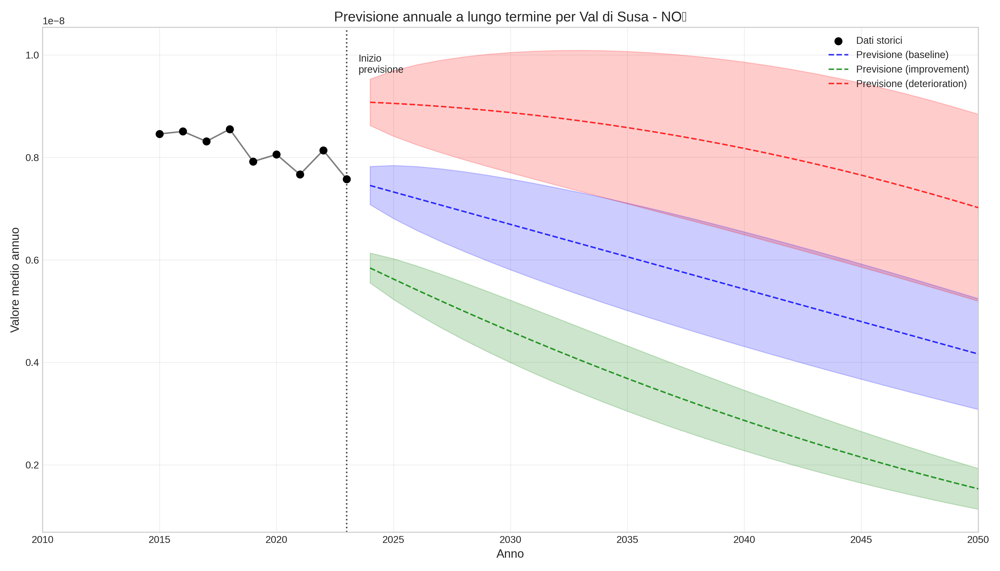

Visualizzata immagine salvata: ./processed_data/annual_forecast_2050/Val di Susa_no2_value_annual_2050.png


#### so2_value

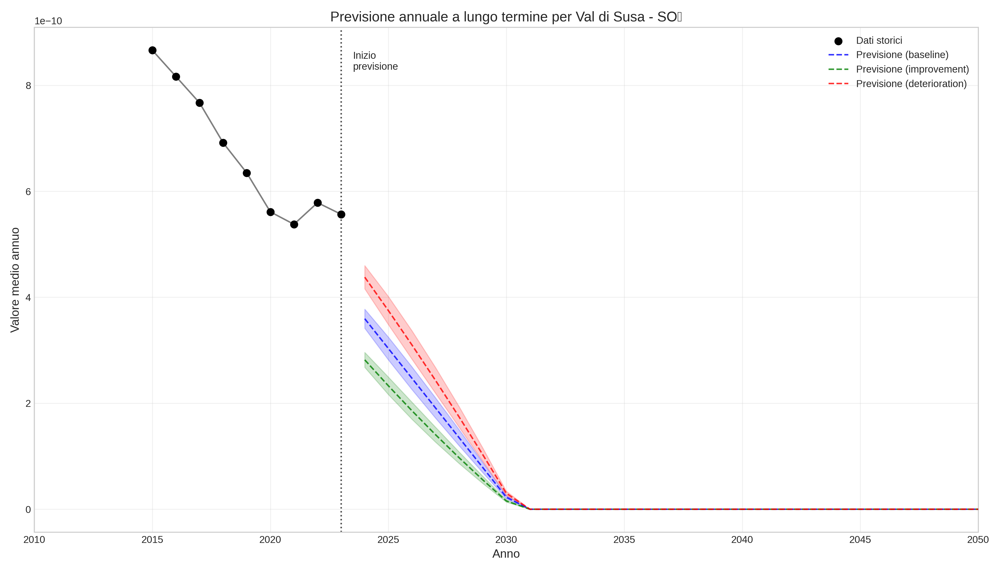

Visualizzata immagine salvata: ./processed_data/annual_forecast_2050/Val di Susa_so2_value_annual_2050.png


#### pm2.5_value

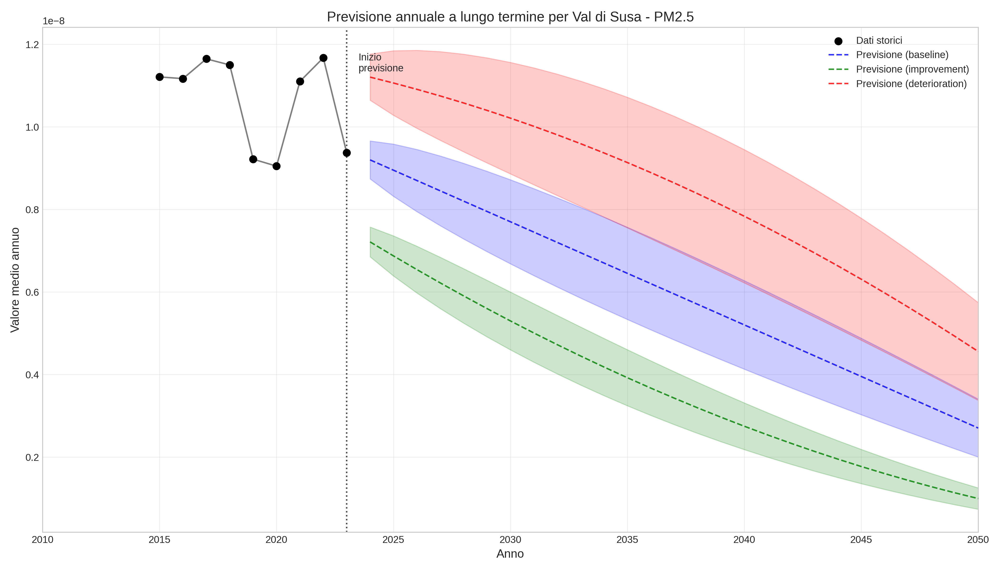

Visualizzata immagine salvata: ./processed_data/annual_forecast_2050/Val di Susa_pm2.5_value_annual_2050.png


## Tabella riassuntiva per anni chiave

Year,Region,Variable,2025,2030,2040,2050
0,Maurienne,CO,1.69e-07,1.69e-07,1.69e-07,1.69e-07
1,Maurienne,NO₂,7.48e-09,6.69e-09,5.09e-09,3.50e-09
2,Maurienne,PM10,1.28e-08,1.08e-08,6.74e-09,2.69e-09
3,Maurienne,PM2.5,9.12e-09,7.73e-09,4.94e-09,2.15e-09
4,Maurienne,SO₂,3.20e-10,3.84e-12,0.00e+00,0.00e+00
5,Val di Susa,CO,1.67e-07,1.67e-07,1.67e-07,1.67e-07
6,Val di Susa,NO₂,7.32e-09,6.69e-09,5.43e-09,4.16e-09
7,Val di Susa,PM10,1.26e-08,1.07e-08,7.08e-09,3.42e-09
8,Val di Susa,PM2.5,8.95e-09,7.70e-09,5.20e-09,2.70e-09
9,Val di Susa,SO₂,3.03e-10,2.27e-11,0.00e+00,0.00e+00


## Confronto degli indicatori tra regioni

### Confronto so2

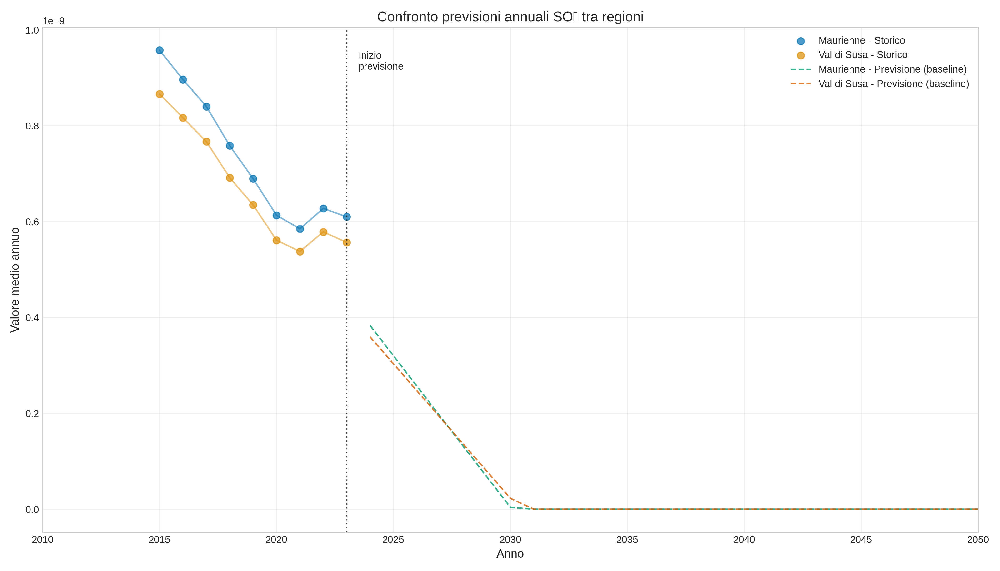

### Confronto co

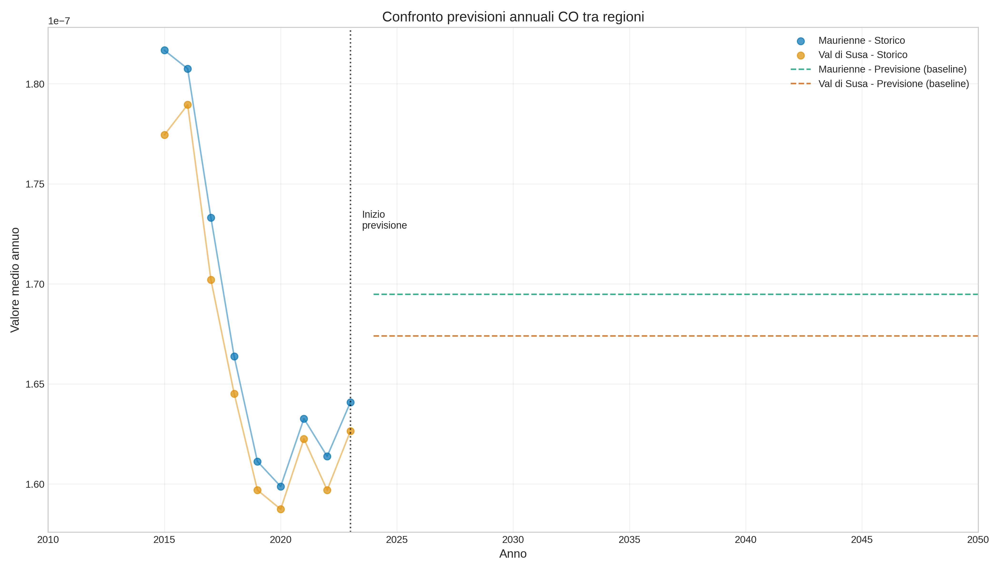

### Confronto no2

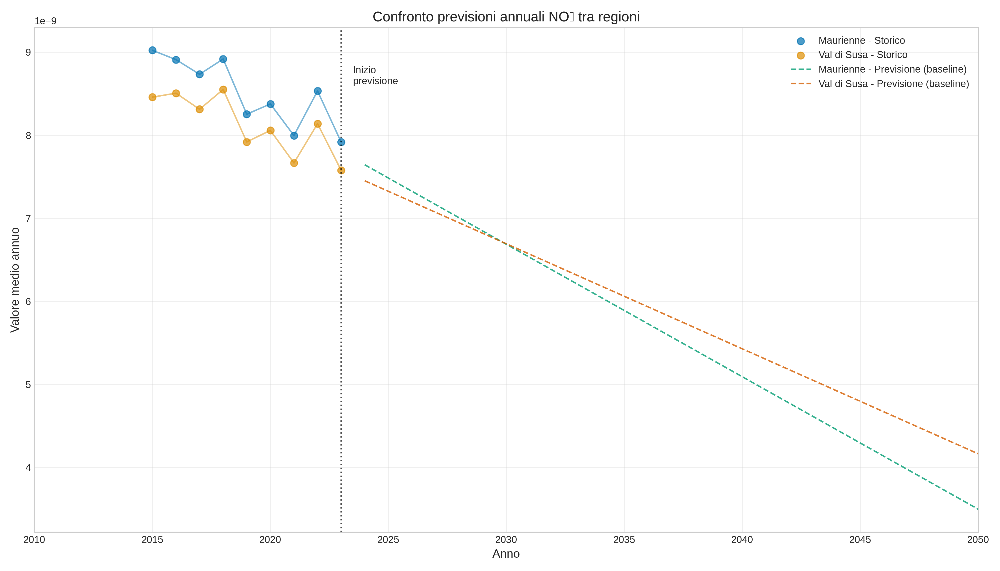

### Confronto pm2.5

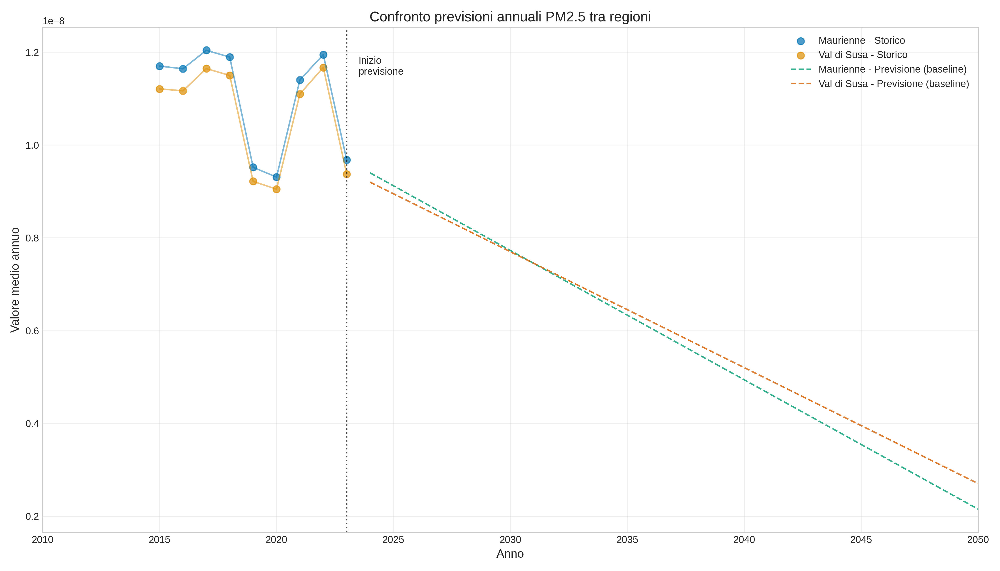

### Confronto pm10

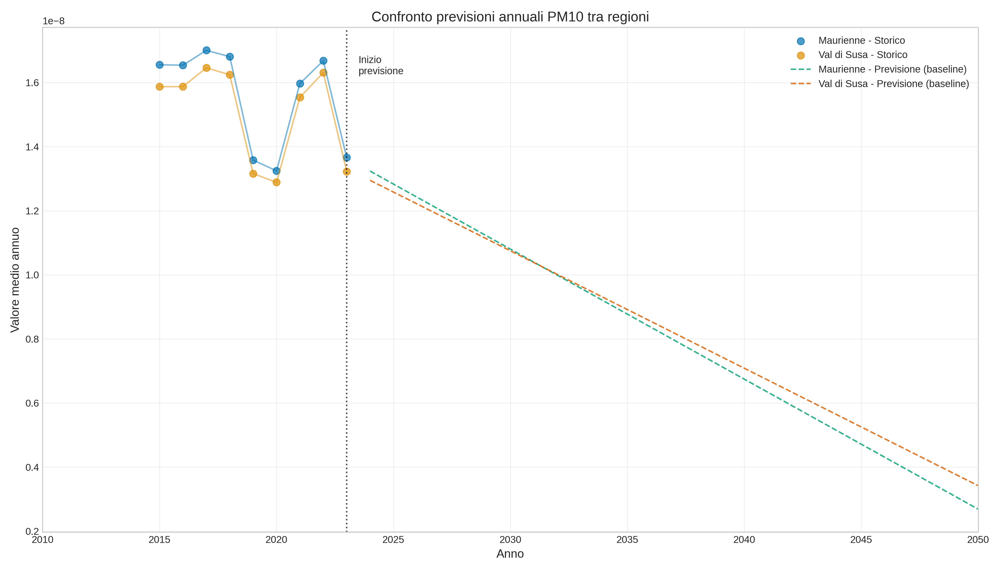


    ## Note sulle previsioni
    
    - Le previsioni mostrate rappresentano diversi scenari possibili fino al 2050.
    - Lo scenario "baseline" rappresenta una continuazione dei trend attuali.
    - Lo scenario "improvement" prevede un miglioramento progressivo grazie a politiche ambientali.
    - Lo scenario "deterioration" prevede un peggioramento dovuto a fattori negativi.
    - L'incertezza aumenta con la distanza temporale dalla fine dei dati storici.
    

In [16]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import glob
from IPython.display import display, Markdown, HTML, Image
from matplotlib.ticker import FuncFormatter

# Directory dove sono stati salvati i risultati delle previsioni
forecast_dir = "./processed_data/annual_forecast_2050"

# Verifica se la directory esiste
if not os.path.exists(forecast_dir):
    print(f"La directory {forecast_dir} non esiste. Assicurati di aver eseguito lo script di previsione a lungo termine.")
else:
    print(f"Trovata directory delle previsioni: {forecast_dir}")

# Funzione per caricare e visualizzare le previsioni per ciascun inquinante
def visualize_forecasts():
    # Carica il file CSV principale delle previsioni se esiste
    csv_files = glob.glob(f"{forecast_dir}/previsioni_annuali_*.csv")
    if not csv_files:
        print("File di previsioni non trovato. Visualizziamo tutte le immagini nella directory.")
        # Visualizza tutte le immagini disponibili
        img_files = glob.glob(f"{forecast_dir}/*.png")
        if img_files:
            display(Markdown("## Immagini delle previsioni disponibili"))
            for img_file in img_files:
                img_name = os.path.basename(img_file).replace('.png', '').replace('_', ' ')
                display(Markdown(f"### {img_name}"))
                display(Image(img_file, width=900))
        return

    # Carica il dataset principale delle previsioni
    try:
        forecast_df = pd.read_csv(csv_files[0])
        print(f"Caricato file delle previsioni: {csv_files[0]}")
        print(f"Righe nel dataset: {len(forecast_df)}")
        
        # Converti colonna Year in interi per evitare problemi
        forecast_df['Year'] = forecast_df['Year'].astype(int)
        
        # Mostra le prime righe del dataset
        display(Markdown("## Panoramica dei dati di previsione"))
        display(forecast_df.head(10))
        
        # Estrai informazioni uniche
        regions = forecast_df['Region'].unique()
        variables = forecast_df['Variable'].unique()
        scenarios = forecast_df['Scenario'].unique()
        years = sorted(forecast_df['Year'].unique())
        
        print(f"\nRegioni: {', '.join(regions)}")
        print(f"Inquinanti: {', '.join(variables)}")
        print(f"Scenari: {', '.join(scenarios)}")
        print(f"Periodo di previsione: {min(years)} - {max(years)}")
        
        # Visualizza tutte le immagini disponibili se ci sono problemi con i dati
        if len(regions) == 0 or len(variables) == 0:
            print("Problemi con i dati nel CSV. Visualizzazione diretta delle immagini...")
            img_files = glob.glob(f"{forecast_dir}/*.png")
            for img_file in img_files:
                img_name = os.path.basename(img_file).replace('.png', '').replace('_', ' ')
                display(Markdown(f"### {img_name}"))
                display(Image(img_file, width=900))
            return
            
        # Visualizza previsioni per ogni regione e inquinante
        display(Markdown("## Previsioni a lungo termine fino al 2050"))
        
        # Carica i dati storici per confronto, se disponibili
        try:
            historical_df = pd.read_csv("./processed_data/air_quality_data_complete.csv")
            historical_df["date"] = pd.to_datetime(historical_df["date"])
            historical_df['year'] = historical_df["date"].dt.year
            print(f"Dati storici caricati: {len(historical_df)} record")
            has_historical = True
        except Exception as e:
            print(f"Dati storici non disponibili: {e}")
            has_historical = False
        
        # Crea grafici per ogni combinazione regione-inquinante
        for region in regions:
            display(Markdown(f"### Previsioni per {region}"))
            
            for var in variables:
                # Filtra dati per questa combinazione
                var_data = forecast_df[(forecast_df['Region'] == region) & 
                                      (forecast_df['Variable'] == var)]
                
                if len(var_data) == 0:
                    print(f"Nessun dato di previsione disponibile per {region} - {var}")
                    continue
                
                # Trova il file immagine corrispondente se esiste
                var_name = var.lower().replace('₂', '2').replace(' ', '')
                img_files = glob.glob(f"{forecast_dir}/{region}_{var_name}_annual_*.png")
                if img_files:
                    display(Markdown(f"#### {var}"))
                    display(Image(img_files[0], width=900))
                    print(f"Visualizzata immagine salvata: {img_files[0]}")
                    continue
                
                # Prepara il grafico solo se non abbiamo trovato un'immagine già pronta
                plt.figure(figsize=(14, 8))
                
                # Aggiungi dati storici per confronto
                if has_historical:
                    hist_data = historical_df[historical_df['region'] == region]
                    if len(hist_data) > 0:
                        var_col = None
                        # Prova diversi formati per trovare la colonna corrispondente
                        var_formats = [var.lower(), var.lower().replace('₂', '2'), var.lower() + '_value']
                        for fmt in var_formats:
                            for col in historical_df.columns:
                                if fmt in col.lower():
                                    var_col = col
                                    break
                            if var_col:
                                break
                        
                        if var_col in hist_data.columns:
                            # Calcola medie annuali
                            annual_hist = hist_data.groupby('year')[var_col].mean().reset_index()
                            plt.plot(annual_hist['year'], annual_hist[var_col], 'o-', 
                                    color='black', linewidth=2, label='Dati Storici')
                
                # Plotta previsioni per ogni scenario
                for scenario in scenarios:
                    scenario_data = var_data[var_data['Scenario'] == scenario]
                    if len(scenario_data) > 0:
                        plt.plot(scenario_data['Year'], scenario_data['Value'], 
                                label=f'Previsione ({scenario})', linestyle='--')
                
                # Aggiungi area ombreggiata per indicare incertezza
                for scenario in scenarios:
                    if scenario == 'baseline':  # Solo per lo scenario baseline
                        scenario_data = var_data[var_data['Scenario'] == scenario]
                        if len(scenario_data) > 0:
                            # Calcola bande di incertezza
                            years_out = scenario_data['Year'] - min(scenario_data['Year'])
                            uncertainty = 0.05 * np.sqrt(years_out+1)  # Crescita dell'incertezza
                            upper = scenario_data['Value'] * (1 + uncertainty)
                            lower = scenario_data['Value'] * (1 - uncertainty)
                            
                            plt.fill_between(scenario_data['Year'], lower, upper, 
                                            alpha=0.2, label='Banda di Incertezza')
                
                # Formattazione del grafico
                plt.title(f'Previsione a lungo termine per {region} - {var}', fontsize=16)
                plt.xlabel('Anno', fontsize=14)
                plt.ylabel('Valore medio annuale', fontsize=14)
                plt.grid(True, alpha=0.3)
                plt.legend(loc='best')
                
                # Assicura che l'asse x mostri tutti gli anni salienti
                # Usa i valori effettivi invece di generarli con range() per evitare errori
                years_list = list(sorted(years))
                key_years = years_list[::5]  # Prendi un anno ogni 5
                plt.xticks(key_years)
                
                # Se i valori sono molto piccoli, usa notazione scientifica
                if np.max(var_data['Value']) < 0.001:
                    plt.gca().yaxis.set_major_formatter(FuncFormatter(lambda x, _: f'{x:.2e}'))
                
                plt.tight_layout()
                display(plt)
                plt.close()
        
        # Carica e visualizza tabella riassuntiva per anni chiave, se disponibile
        summary_file = f"{forecast_dir}/tabella_riassuntiva_anni_chiave.csv"
        if os.path.exists(summary_file):
            display(Markdown("## Tabella riassuntiva per anni chiave"))
            summary_df = pd.read_csv(summary_file)
            
            # Pivot della tabella per una visualizzazione più chiara
            pivot_df = summary_df.pivot_table(
                index=['Region', 'Variable'], 
                columns='Year', 
                values='Value'
            ).reset_index()
            
            # Aggiungi formattazione
            def format_scientific(x):
                if pd.isna(x):
                    return ''
                return f'{x:.2e}'
            
            styled_df = pivot_df.style.format({col: format_scientific for col in pivot_df.columns if isinstance(col, int)})
            display(styled_df)
    
    except Exception as e:
        print(f"Errore nell'elaborazione dei dati: {e}")
        # In caso di errore, visualizza direttamente le immagini disponibili
        img_files = glob.glob(f"{forecast_dir}/*.png")
        if img_files:
            display(Markdown("## Immagini delle previsioni disponibili"))
            for img_file in img_files:
                img_name = os.path.basename(img_file).replace('.png', '').replace('_', ' ')
                display(Markdown(f"### {img_name}"))
                display(Image(img_file, width=900))
    
    # Verifica se ci sono immagini di confronto (che includono tutti gli indicatori)
    comparison_files = glob.glob(f"{forecast_dir}/confronto_*_annual_*.png")
    if comparison_files:
        display(Markdown("## Confronto degli indicatori tra regioni"))
        for img_file in comparison_files:
            var_name = os.path.basename(img_file).split('_')[1]
            display(Markdown(f"### Confronto {var_name}"))
            display(Image(img_file, width=900))
    
    # Aggiungi nota finale
    display(Markdown("""
    ## Note sulle previsioni
    
    - Le previsioni mostrate rappresentano diversi scenari possibili fino al 2050.
    - Lo scenario "baseline" rappresenta una continuazione dei trend attuali.
    - Lo scenario "improvement" prevede un miglioramento progressivo grazie a politiche ambientali.
    - Lo scenario "deterioration" prevede un peggioramento dovuto a fattori negativi.
    - L'incertezza aumenta con la distanza temporale dalla fine dei dati storici.
    """))

# Esegui la funzione di visualizzazione
visualize_forecasts()